In [1]:
import numpy as np
import pandas as pd
import scipy
import scipy.stats
import sklearn
from sklearn import preprocessing
from sklearn.neighbors import KNeighborsClassifier
import magic
import math
import rpy2

import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sbn
from matplotlib.ticker import MaxNLocator
from matplotlib.lines import Line2D

from IPython.display import clear_output
import pickle
import os
import sys
import csv

import scanpy as sc
import scanpy.external as sce

from numpy import ones,vstack
from numpy.linalg import lstsq

root = '/mnt/c' if 'mnt' in os.getcwd() else 'C:'
fig_path = '{}/My Drive/MKA/Papers/Greco/Katie/Figure_output'.format(root)

path_skin_scripts = '{}/My Drive/Python/Projects'.format(root)
sys.path.append(path_skin_scripts)
from Skin_scripts import *

In [2]:
cell_cycle_genes_path = '{}/My Drive/Python/Projects/regev_lab_cell_cycle_genes.txt'.format(root)

cell_cycle_genes = [x.strip().title() for x in open(cell_cycle_genes_path)]

# Separate dataset for S-phase or G2M-phase associated genes
s_genes = cell_cycle_genes[:43]
g2m_genes = cell_cycle_genes[43:]

def plot_basal_suprabasal_cutoff(ax, x0 = -1.5, x1 = 0.5, m = -2.817173155586682, c = 5.325081674268546, ls = '--', color = 'dimgrey', lw = 2): 
    ax.plot([x0,x1], [m*x0+c, m*x1+c], ls = ls, c = color, lw = lw)
    
def plot_basal_suprabasal_cutoff_v2(ax, x0 = -2.5, x1 = 1, m = -1.09807084, c = 5.8597005, ls = '--', color = 'dimgrey', lw = 2): 
    ax.plot([x0,x1], [m*x0+c, m*x1+c], ls = ls, c = color, lw = lw)

# Load data 1

# Continue 

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

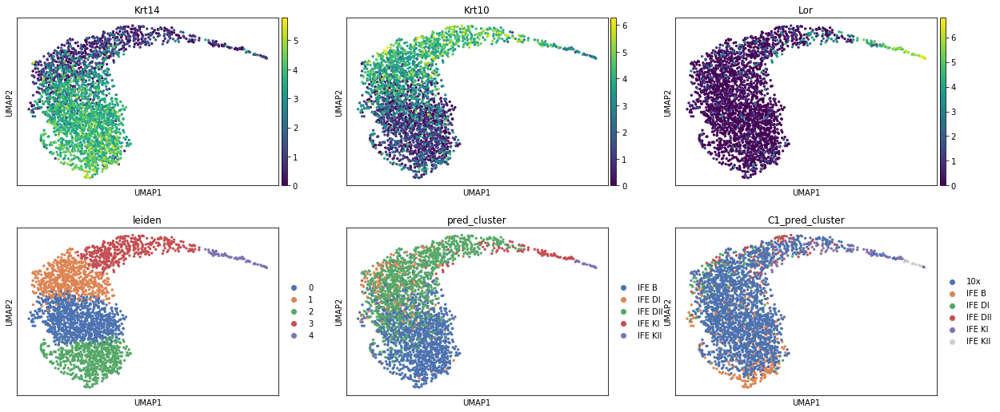

In [13]:
sc.pl.umap(data_magic, color = ['Krt14','Krt10','Lor','leiden','pred_cluster','C1_pred_cluster'], ncols = 3, cmap = 'viridis')

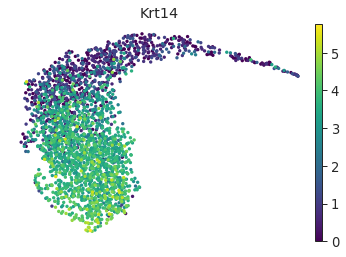

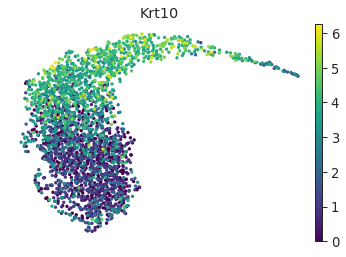

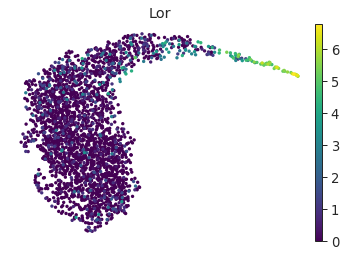

In [400]:
for gene in ['Krt14','Krt10','Lor']:
    g = sc.pl.umap(data_magic, color = gene, ncols = 3, cmap = 'viridis', frameon = False, show = False)
    plt.savefig(os.path.join(fig_path, 'IFE_umap_expression_{}.pdf'.format(gene)), transparent = True, bbox_inches = 'tight')

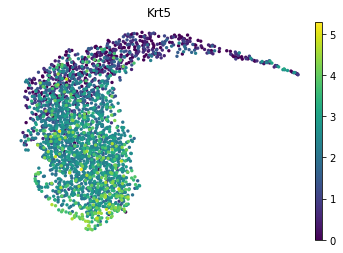

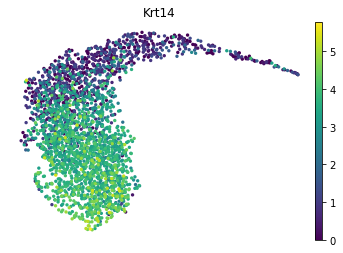

In [313]:
for gene in ['Krt5','Krt14']:
    g = sc.pl.umap(data_magic, color = gene, ncols = 3, cmap = 'viridis', frameon = False, show = False)
    #plt.savefig(os.path.join(fig_path, 'IFE_umap_expression_{}.pdf'.format(gene)), transparent = True, bbox_inches = 'tight')

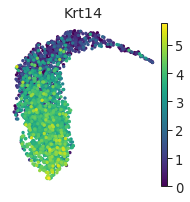

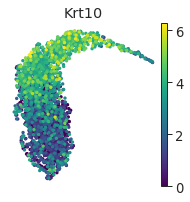

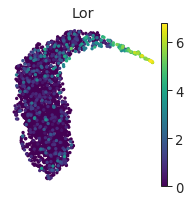

In [493]:
for gene in ['Krt14','Krt10','Lor']:
    fig, ax = plt.subplots(figsize = (3,3))
    g = sc.pl.umap(data_magic, color = gene, ncols = 3, cmap = 'viridis', frameon = False, show = False, ax = ax)
    plt.savefig(os.path.join(fig_path, 'IFE_umap_expression_{}.pdf'.format(gene)), transparent = True, bbox_inches = 'tight')

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

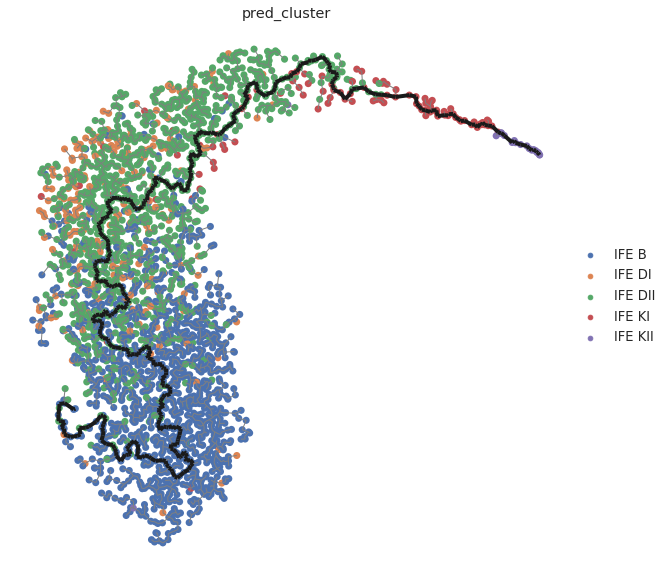

In [543]:
fig = plt.figure(figsize = (10,10))
ax1 = plt.subplot()
g = sc.pl.umap(data_magic, color = 'pred_cluster', show = False, ax = ax1, frameon = False, s = 200)
nx.draw_networkx_edges(MST, pos = MST_pos_umap, ax = g,
                       with_labels = True, node_size = 125, linewidths = 10.0, #These don't do anything? 
                       width = 1.0, edge_color = 'grey', 
                       vmin = 0, vmax = 1.0)

nx.draw_networkx_edges(MST, pos = MST_pos_umap, ax = g,
                       edgelist = diam_edges.edges(), width = 4,
                       edge_color = 'k')

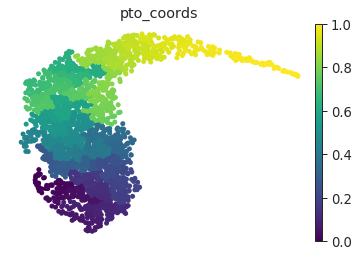

In [425]:
sc.pl.umap(data_magic, color = 'pto_coords', ncols = 3, frameon = False, s = 100, show = False, cmap = 'viridis')

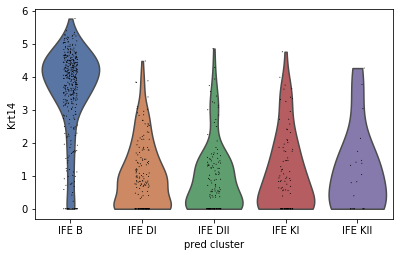

In [92]:
sc.pl.violin(data_magic[data_magic.obs['batch']=='C1'], keys = ['Krt14'], groupby = 'pred_cluster')

In [743]:
data_magic.obs['dpt_pseudotime_ordered'] = np.argsort(np.argsort(data_magic.obs['dpt_pseudotime'])).div(
    np.argsort(np.argsort(data_magic.obs['dpt_pseudotime'])).max())

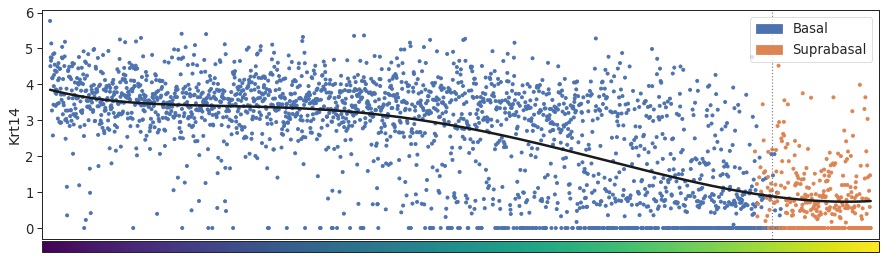

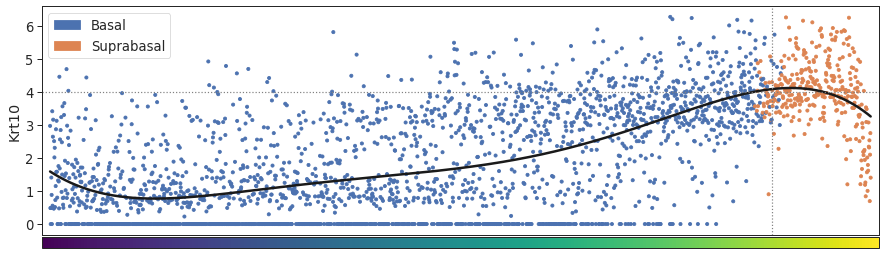

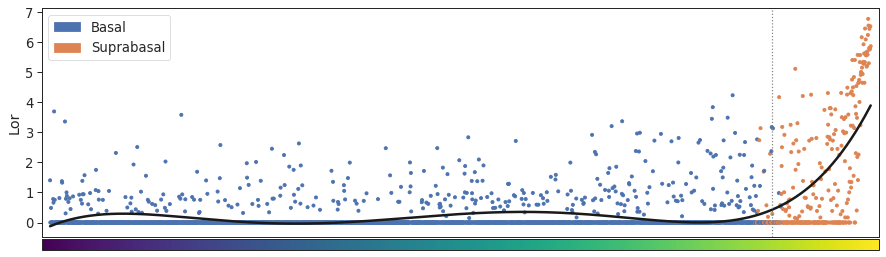

In [745]:
line_kwargs = {'c': 'k', 'ls': '-', 'lw': 2.5}
for gene in ['Krt14','Krt10','Lor']:
    ax = plot_pseudotime_gene_expression(data_magic, gene, color = 'Location', pseudotime_col='dpt_pseudotime_ordered', use_raw=True,
                                plot_regression=True, regression_step_size=0.0001, regressionLineOrder=5, 
                                **line_kwargs, return_axis=True, plot_reg_expr_intercept=False, 
                                round_decimals=3, expr_cutoff=3, print_intercept=True)
    """if gene == 'Krt10':
        ax.axhline(4, c = 'grey', ls = ':')
    ax.axvline(0.8798, c = 'grey', ls = ':')"""

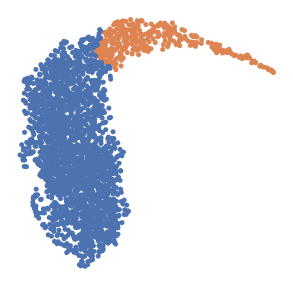

In [105]:
fig, ax = plt.subplots(1, figsize = (5,5))
#plot_points_area(data_magic, group = 'Location', z_score = 10, ax = ax, alpha = 0.8, fill = False, colors = ['grey','grey'], linestyle = '--', linewidth = 3)
sc.pl.umap(data_magic, color = ['Location'], frameon = False, s = 100, show = False, ax = ax, legend_loc = False, title = '')
fig.savefig(os.path.join(fig_path, 'IFE_umap_Location.pdf'), transparent = True, bbox_inches = 'tight')

# Checkpoint 2

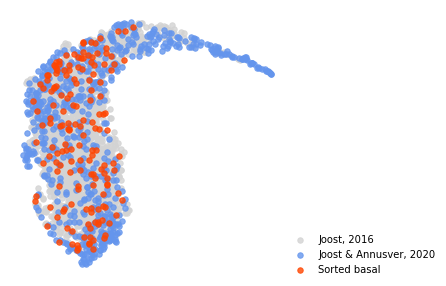

In [6]:
fig, ax = plt.subplots(figsize = (5,5))

cmap = ['lightgrey','cornflowerblue', 'orangered']
for ix, g in enumerate(['10x','C1','Ivl']):
    tmp = data_magic[data_magic.obs['batch']==g]
    ax.scatter(x = tmp.obsm['X_umap'][:, 0], y = tmp.obsm['X_umap'][:, 1], color = cmap[ix], s = 30, alpha = 0.8)
leg = plt.legend(labels = ['Joost, 2016', 'Joost & Annusver, 2020', 'Sorted basal'], frameon = False, loc = (1, 0))
for loc in ['right','top','left','bottom']:
    ax.spines[loc].set_visible(False)
for side in ['x','y']:
        ax.tick_params(
            axis=side,  # changes apply to the x-axis
            which='both',  # both major and minor ticks are affected
            bottom=False,  # ticks along the bottom edge are off
            top=False,  # ticks along the top edge are off
            left=False,
            labelbottom=False,
            labelleft=False,
            labeltop = False)
#fig.savefig(os.path.join(fig_path, 'IFE_datasets_colored_v2.pdf'), transparent = True, bbox_inches = 'tight')

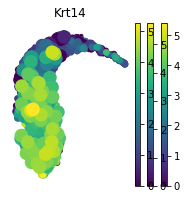

In [452]:
for gene in ['Krt14','Krt10','Lor']:
    fig, ax = plt.subplots(figsize = (3,3))
    #g = sc.pl.umap(data_magic, color = gene, ncols = 3, cmap = 'viridis', frameon = False, show = False, ax = ax)
    for batch in ['10x','C1','Ivl']:
        """tmp = data_magic[data_magic.obs['batch']==batch].obsm['X_umap']
        ax.scatter(x = tmp[:, 0], y = tmp[:, 1], color = 'lightgrey')"""
        sc.pl.umap(data_magic[data_magic.obs['batch']==batch], 
                   color = gene, frameon = False, ax = ax, show = False)
    break
    #plt.savefig(os.path.join(fig_path, 'IFE_umap_expression_{}.pdf'.format(gene)), transparent = True, bbox_inches = 'tight')

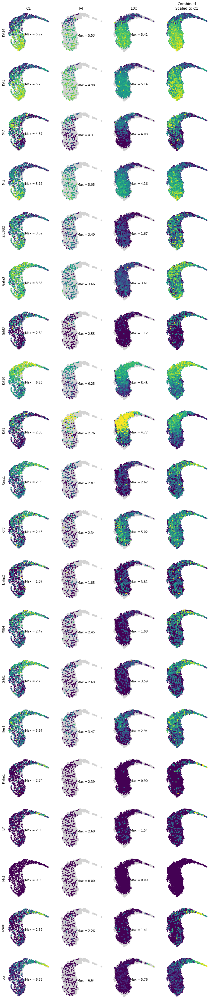

In [98]:
from sklearn import preprocessing

#Incorrectly scale 10x data to CS data. Should be scaled separately. See the next cells

genes = ['Krt14','Krt5','Mt4','Mt2','Zfp36l2','Gata3','Grhl3','Krt10','Krt1','Casz1','Klf3','Lrrfip2','Mllt4',
         'Grhl1','Hes1','Prdm1','Id4','Mx1','Tead1','Lor']

ncols = 4
fig, axes = initialize_subplots(groups_to_plot=len(genes)*4, ncols = 4, figsize_multiplier=(3, 3))
percentile = 99.9

for b_ix, batch in enumerate(['10x','C1','Ivl']):
    tmp = data_magic[data_magic.obs['batch']!=batch]
    umap = tmp.obsm['X_umap']
    for g_ix, g in enumerate(genes):
        ax = axes[g_ix, b_ix]
        ax.scatter(x = umap[:, 0], y = umap[:, 1], c = 'lightgrey', s = 20)
    

for ix, gene in enumerate(genes):
    print(gene)
    clear_output(wait = True)
    c1_vmax = 0
    umap_all = []
    expression_scaled = []
    for b_ix, batch in enumerate(['C1','Ivl','10x']):
        ax = axes[ix, b_ix]
        tmp = data_magic[data_magic.obs['batch']==batch]
        expression = tmp.raw.X[:,np.where(tmp.raw.var_names == gene)[0]]
        umap = tmp.obsm['X_umap']
        umap_all.extend(umap.tolist())
        
        if batch == 'C1':
            c1_vmax = np.percentile(expression.flatten(), q = percentile)
            scaler = preprocessing.StandardScaler().fit(expression)
            expression_scaled.extend(scaler.transform(expression).flatten())
        else:
            expression_scaled.extend(scaler.transform(expression).flatten())
        

        expression = expression.flatten()
        rank = np.argsort(expression)
        expression = np.array(expression)[rank]
        umap = np.array(umap)[rank]
        
        vmax = np.percentile(expression.max(), q = percentile) if batch != 'Ivl' else c1_vmax
        
        ax.scatter(x = umap[:, 0], y = umap[:, 1], c = expression, cmap='viridis', s = 10, vmax = c1_vmax)
        clean_axis(ax, remove_axis_labels= False)
        
        ax.text(x = 0.7, y = 0.05, s = 'Max = {:.2f}'.format(vmax))
        if ix == 0:
            ax.set_title(batch)
            axes[ix, 3].set_title('Combined\nScaled to C1')
        if b_ix == 0:
            ax.set_ylabel(gene)
    
    rank = np.argsort(expression_scaled)
    umap_all = np.array(umap_all)[rank]
    expression_scaled = np.array(expression_scaled)[rank]
    vmax = np.percentile(expression_scaled, q = percentile)
    
    axes[ix, 3].scatter(x = umap_all[:, 0], y = umap_all[:, 1], c = expression_scaled, cmap='viridis', s = 10, vmax = vmax)
    clean_axis(axes[ix, 3], remove_axis_labels= False)
clear_output()

# Checkpoint 3

In [50]:
raw_data = sc.read_csv(os.path.join(path, '{}_raw_counts.csv'.format(raw_filename)))

In [51]:
raw_data.obs['batch'] = ['10x' if '10x' in x else 'Ivl' if 'Tomato' in x else 'C1' for x in raw_data.obs_names]

In [52]:
raw_data.X = np.expm1(raw_data.X)

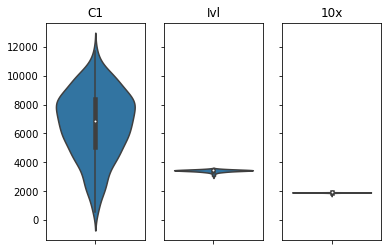

In [144]:
fig, axes= plt.subplots(ncols = 3, sharey = True)

batches = ['C1','Ivl','10x']
for ix, b in enumerate(batches):
    ax = axes[ix]
    sbn.violinplot(np.sum(raw_data[raw_data.obs['batch']==b].X, axis = 1), orient='v', ax = ax)
    ax.set_title(b)
    #ax.set_ylim([0,6000])

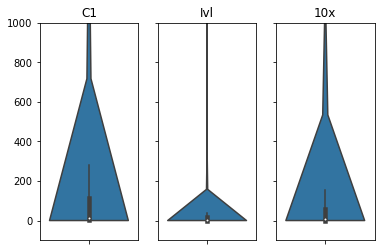

In [58]:
fig, axes= plt.subplots(ncols = 3, sharey = True)

batches = ['C1','Ivl','10x']
for ix, b in enumerate(batches):
    ax = axes[ix]
    sbn.violinplot(np.sum(raw_data[raw_data.obs['batch']==b].X, axis = 0), orient='v', ax = ax, cut = 0)
    ax.set_title(b)
    ax.set_ylim([-100,1000])

In [64]:
raw_c1 = raw_data[raw_data.obs['batch']=='C1']
raw_ivl = raw_data[raw_data.obs['batch']=='Ivl']
raw_10x = raw_data[raw_data.obs['batch']=='10x']

In [65]:
counts = 2000
raw_c1_ds = sc.pp.downsample_counts(raw_c1, counts_per_cell = counts, copy = True)
raw_ivl_ds = sc.pp.downsample_counts(raw_ivl, counts_per_cell = counts, copy = True)
raw_10x_ds = sc.pp.downsample_counts(raw_10x, counts_per_cell = counts, copy = True)

In [66]:
raw_data_ds = raw_c1_ds.concatenate(raw_ivl_ds, raw_10x_ds, batch_key = 'conc_batch', batch_categories = None, index_unique = None)

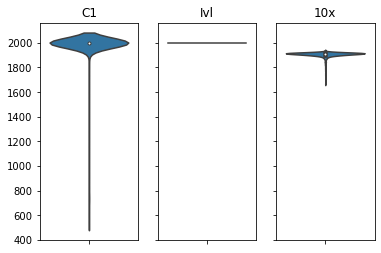

In [67]:
fig, axes= plt.subplots(ncols = 3, sharey = True)

batches = ['C1','Ivl','10x']
for ix, b in enumerate(batches):
    ax = axes[ix]
    sbn.violinplot(np.sum(raw_data_ds[raw_data_ds.obs['batch']==b].X, axis = 1), orient='v', ax = ax)
    ax.set_title(b)
    #ax.set_ylim([0,1000])

In [69]:
sc.pp.log1p(raw_data_ds)

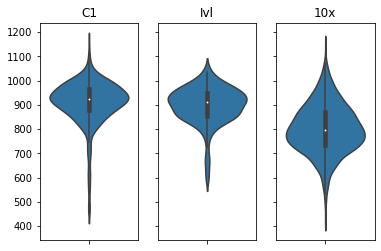

In [70]:
fig, axes= plt.subplots(ncols = 3, sharey = True)

batches = ['C1','Ivl','10x']
for ix, b in enumerate(batches):
    ax = axes[ix]
    sbn.violinplot(np.sum(raw_data_ds[raw_data_ds.obs['batch']==b].X, axis = 1), orient='v', ax = ax)
    ax.set_title(b)
    #ax.set_ylim([0,1000])

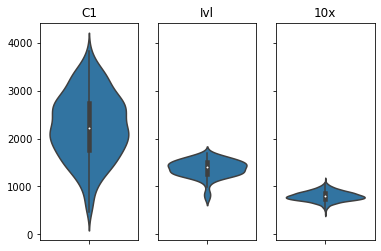

In [143]:
fig, axes= plt.subplots(ncols = 3, sharey = True)

batches = ['C1','Ivl','10x']
for ix, b in enumerate(batches):
    ax = axes[ix]
    sbn.violinplot(np.sum(np.log1p(raw_data[raw_data.obs['batch']==b].X), axis = 1), orient='v', ax = ax)
    ax.set_title(b)
    #ax.set_ylim([0,6000])

In [71]:
data_magic.raw = raw_data_ds

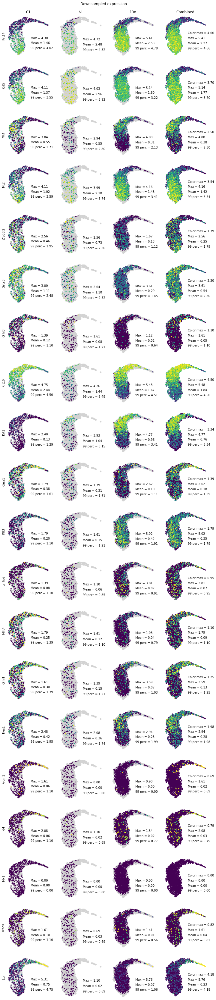

In [94]:
genes = ['Krt14','Krt5','Mt4','Mt2','Zfp36l2','Gata3','Grhl3','Krt10','Krt1','Casz1','Klf3','Lrrfip2','Mllt4',
         'Grhl1','Hes1','Prdm1','Id4','Mx1','Tead1','Lor']

ncols = 4
fig, axes = initialize_subplots(groups_to_plot=len(genes)*4, ncols = 4, figsize_multiplier=(3, 3))
percentile = 99

for b_ix, batch in enumerate(['10x','C1','Ivl']):
    tmp = data_magic[data_magic.obs['batch']!=batch]
    umap = tmp.obsm['X_umap']
    for g_ix, g in enumerate(genes):
        ax = axes[g_ix, b_ix]
        ax.scatter(x = umap[:, 0], y = umap[:, 1], c = 'lightgrey', s = 20)
    

for ix, gene in enumerate(genes):
    print(gene)
    clear_output(wait = True)
    vmax = np.percentile(data_magic.raw.X[:, np.where(
        data_magic.raw.var_names == gene)[0]].flatten(), q = percentile)
    
    #c1_vmax = 0
    umap_all = []
    expression_all = []
    for b_ix, batch in enumerate(['C1','Ivl','10x']):
        ax = axes[ix, b_ix]
        tmp = data_magic[data_magic.obs['batch']==batch]
        expression = tmp.raw.X[:,np.where(tmp.raw.var_names == gene)[0]]
        umap = tmp.obsm['X_umap']
        umap_all.extend(umap.tolist())
        expression_all.extend(expression.flatten())

        expression = expression.flatten()
        rank = np.argsort(expression)
        expression = np.array(expression)[rank]
        umap = np.array(umap)[rank]
        
        #vmax = np.percentile(expression.max(), q = percentile) if batch == '10x' else c1_vmax
        
        ax.scatter(x = umap[:, 0], y = umap[:, 1], c = expression, cmap='viridis', s = 5, vmax = vmax, vmin = 0)
        clean_axis(ax, remove_axis_labels= False)
        
        #ax.text(x = 3, y = 0, s = 'Color max = {:.2f}'.format(vmax))
        ax.text(x = 3, y = 0, s = 'Max = {:.2f}'.format(expression.max()))
        ax.text(x = 3, y = -2, s = 'Mean = {:.2f}'.format(expression.mean()))
        ax.text(x = 3, y = -4, s = '99 perc = {:.2f}'.format(np.percentile(expression, q = 99)))
        
        if ix == 0:
            ax.set_title(batch)
            axes[ix, 3].set_title('Combined')
        if b_ix == 0:
            ax.set_ylabel(gene)
    
    rank = np.argsort(expression_all)
    umap_all = np.array(umap_all)[rank]
    expression_all = np.array(expression_all)[rank]
    #vmax = np.percentile(expression_all, q = percentile)
    
    axes[ix, 3].scatter(x = umap_all[:, 0], y = umap_all[:, 1], c = expression_all, cmap='viridis', s = 5, vmax = vmax)
    axes[ix, 3].text(x = 3, y = 2, s = 'Color max = {:.2f}'.format(vmax))
    axes[ix, 3].text(x = 3, y = 0, s = 'Max = {:.2f}'.format(expression_all.max()))
    axes[ix, 3].text(x = 3, y = -2, s = 'Mean = {:.2f}'.format(expression_all.mean()))
    axes[ix, 3].text(x = 3, y = -4, s = '99 perc = {:.2f}'.format(np.percentile(expression_all, q = 99)))
    clean_axis(axes[ix, 3], remove_axis_labels= False)

fig.suptitle('Downsampled expression', y = 0.89)
clear_output()


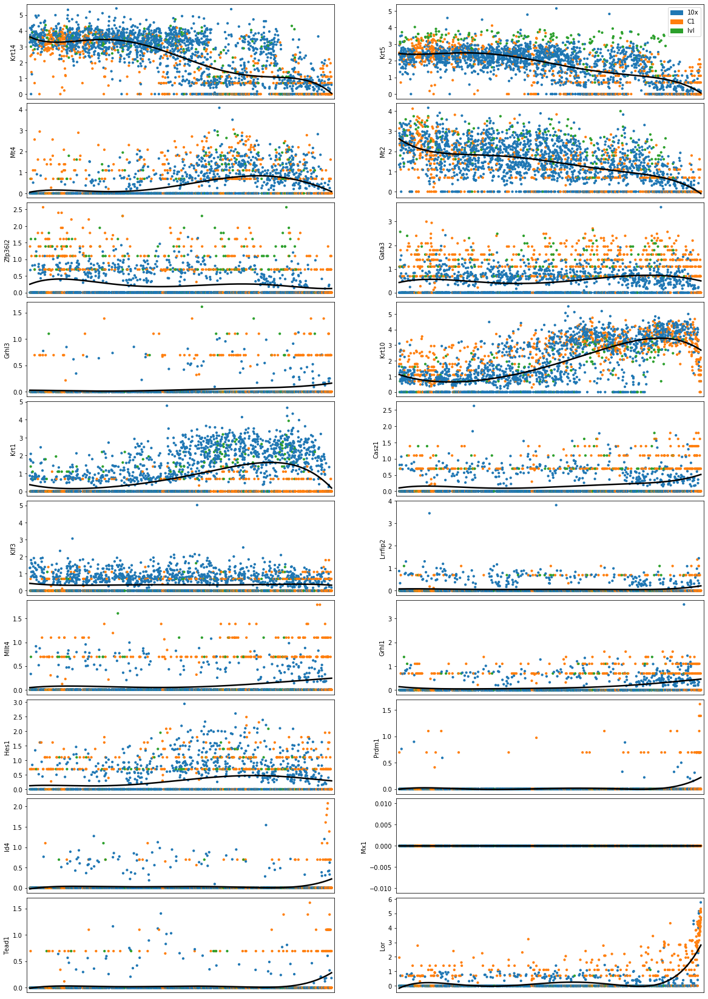

In [97]:
genes = ['Krt14','Krt5','Mt4','Mt2','Zfp36l2','Gata3','Grhl3','Krt10','Krt1','Casz1','Klf3','Lrrfip2','Mllt4',
         'Grhl1','Hes1','Prdm1','Id4','Mx1','Tead1','Lor']
ncols = 2
fig, axes = initialize_subplots(groups_to_plot=len(genes), ncols = ncols, figsize_multiplier = (10, 3), print_help=False,
                                sharey = False, gridspec_kw={'wspace':0.2, 'hspace':0.05, 'width_ratios':[1,1]})

color = 'batch'
line_kwargs = {'c': 'k', 'ls': '-', 'lw': 2.5}
for ix, gene in enumerate(genes):
    print(gene)
    clear_output(wait = True)
    ax = axes.flatten()[ix]
    
    plot_pseudotime_gene_expression(data_magic, gene, color = color, pseudotime_col='pto_coords', use_raw=True,
                                plot_regression=True, regression_step_size=0.0001, regressionLineOrder=5, ax = ax, legend = True if ix ==1 else False,
                                cbar = False, s = 10,
                                **line_kwargs, return_axis=False, plot_reg_expr_intercept=False, 
                                round_decimals=3, expr_cutoff=3, print_intercept=False)
    
    #ax.axvline(B_SB_cutoff, c = 'grey', ls = ':')


#fig.savefig(os.path.join(fig_path, 'C1_IFE_gene-expression_over_pto_violin.pdf'), transparent = True, bbox_inches = 'tight')

In [114]:
cmap = ['lightgrey','cornflowerblue', 'orangered']
data_magic.uns['batch_colors'] = [mpl.colors.cnames[x] for x in cmap]

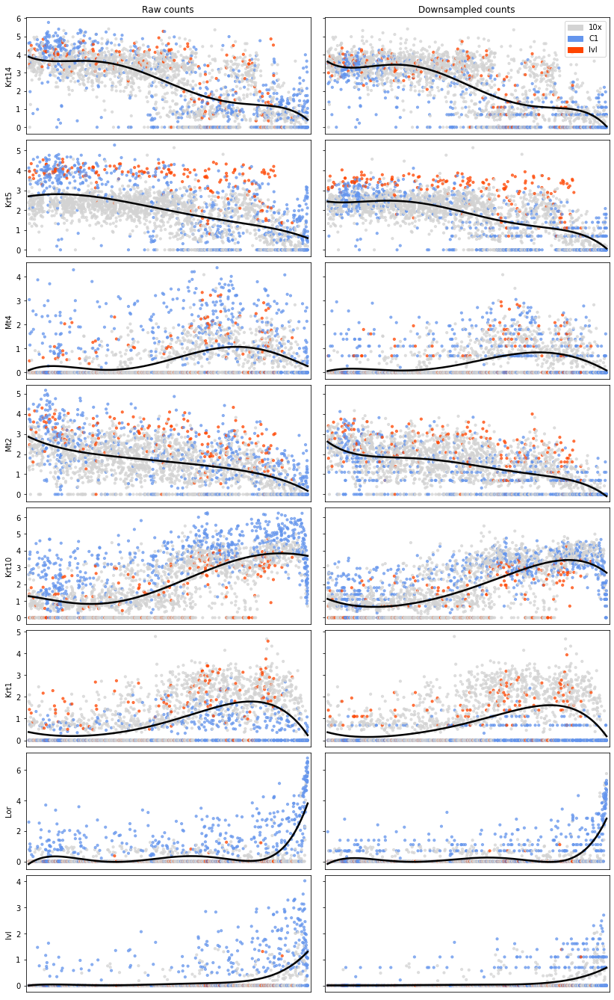

In [115]:
genes = ['Krt14','Krt5','Mt4','Mt2','Krt10','Krt1','Lor', 'Ivl']
ncols = 2
fig, axes = initialize_subplots(groups_to_plot=ncols*len(genes), ncols = ncols, figsize_multiplier = (7, 3), print_help=False,
                                sharey = 'row', gridspec_kw={'wspace':0.05, 'hspace':0.05, 'width_ratios':[1,1]})

data_magic.raw = sc.pp.log1p(raw_data, copy = True)
color = 'batch'
line_kwargs = {'c': 'k', 'ls': '-', 'lw': 2.5}
for ix, gene in enumerate(genes):
    print('Raw', gene)
    clear_output(wait = True)
    
    ax = axes[ix, 0]
    plot_pseudotime_gene_expression(data_magic, gene, color = color, pseudotime_col='pto_coords', use_raw=True,
                                plot_regression=True, regression_step_size=0.0001, regressionLineOrder=5, ax = ax, legend = False,
                                cbar = False, s = 10, alpha = 0.7,
                                **line_kwargs, return_axis=False, plot_reg_expr_intercept=False, 
                                round_decimals=3, expr_cutoff=3, print_intercept=False)

data_magic.raw = raw_data_ds
for ix, gene in enumerate(genes):
    print('Downsampled', gene)
    clear_output(wait = True)
    ax = axes[ix, 1]
    plot_pseudotime_gene_expression(data_magic, gene, color = color, pseudotime_col='pto_coords', use_raw=True,
                                plot_regression=True, regression_step_size=0.0001, regressionLineOrder=5, ax = ax, legend = True if ix ==0 else False,
                                cbar = False, s = 10, alpha = 0.7,
                                **line_kwargs, return_axis=False, plot_reg_expr_intercept=False, 
                                round_decimals=3, expr_cutoff=3, print_intercept=False)
    ax.set_ylabel('')
    #ax.axvline(B_SB_cutoff, c = 'grey', ls = ':')

axes[0,0].set_title('Raw counts')
axes[0,1].set_title('Downsampled counts')
clear_output(wait = True)
#fig.savefig(os.path.join(fig_path, 'C1_IFE_gene-expression_over_pto_violin.pdf'), transparent = True, bbox_inches = 'tight')

# Checkpoint 4

In [3]:
fig_path = 'C:/Users/karlan/Google Drive/MKA/Papers/Greco/Katie/Figure_output'
path = 'C:/Users/karlan/Google Drive/MKA/Epidermal stem cells at the point of no return/Sequencing results/Combined_With_Joost_IFE/'
filename = '20200413_ingest_combined_imputed_cc-regressed'
raw_filename = '20200408_ingest_combined_imputed_cc-regressed'
raw_filename_downsampled = '20200415_ingest_combined_imputed_cc-regressed_downscaled'

data_magic = sc.read_loom(os.path.join(path, '{}.loom'.format(filename)))

data_magic.raw = sc.read_csv(os.path.join(path, '{}_raw_counts.csv'.format(raw_filename_downsampled)))

with open(os.path.join(path, '{}_MST.pickle'.format(raw_filename)), 'rb') as file:
    MST = pickle.load(file)
    
with open(os.path.join(path, '{}_uns.pickle'.format(filename)), 'rb') as file:
    data_magic.uns = pickle.load(file)

C:\Users\karlan\AppData\Local\Continuum\anaconda3\envs\scanpy\lib\site-packages\loompy\loom_validator.py:48: H5pyDeprecationWarning: The default file mode will change to 'r' (read-only) in h5py 3.0. To suppress this warning, pass the mode you need to h5py.File(), or set the global default h5.get_config().default_file_mode, or set the environment variable H5PY_DEFAULT_READONLY=1. Available modes are: 'r', 'r+', 'w', 'w-'/'x', 'a'. See the docs for details.
  with h5py.File(path) as f:


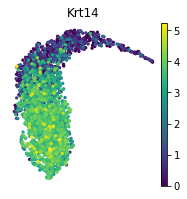

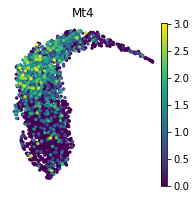

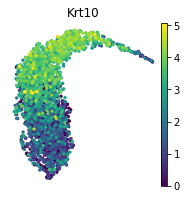

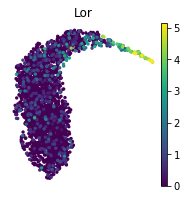

In [15]:
percentile = 99.9
for gene in ['Krt14','Mt4', 'Krt10','Lor']:
    fig, ax = plt.subplots(figsize = (3,3))
    #g = sc.pl.umap(data_magic, color = gene, ncols = 3, cmap = 'viridis', frameon = False, show = False, ax = ax)
    #tmp = data_magic[data_magic.obs['batch']=='10x'].obsm['X_umap']
    #ax.scatter(x = tmp[:, 0], y = tmp[:, 1], color = 'lightgrey')
    vmax = np.percentile(data_magic.raw.X[:, np.where(
        data_magic.raw.var_names == gene)[0]].flatten(), q = percentile)
    sc.pl.umap(data_magic, color = gene, frameon = False, ax = ax, show = False, use_raw = True, vmax = vmax, vmin = 0)
    plt.savefig(os.path.join(fig_path, 'IFE_umap_expression_downsampled_{}.png'.format(gene)), transparent = True, bbox_inches = 'tight', dpi = 600)

In [92]:
leiden_named_colors_backup = data_magic.uns['leiden_named_colors']
data_magic.uns['leiden_named_colors'] = sbn.color_palette('Greys', n_colors=6)[:5]
data_magic.uns['leiden_named_colors'] = convert_rgb_to_hex(adata = data_magic, color_name = 'leiden_named')

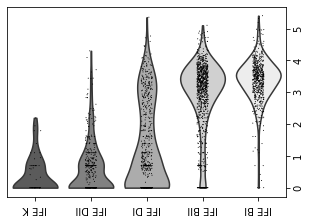

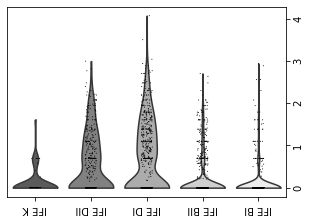

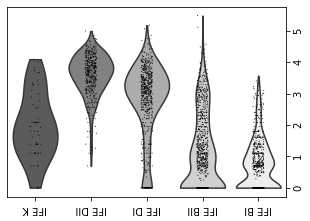

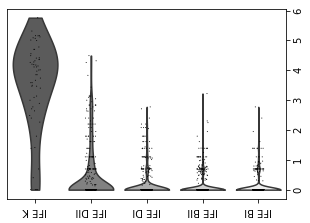

In [234]:
percentile = 99.9
for gene in ['Krt14','Mt4', 'Krt10','Lor']:
    fig, ax = plt.subplots(figsize = (5,3.5))
    sc.pl.violin(data_magic, keys = gene, groupby = 'leiden_named', frameon = False, ax = ax, show = False, use_raw = True, rotation = 180, 
                 order=['IFE K', 'IFE DII', 'IFE DI', 'IFE BII', 'IFE BI'])
    ax.set_xlabel('')
    ax.set_ylabel('')
    
    ax.yaxis.tick_right()
    ax.yaxis.set_label_position("right")
    plt.yticks(rotation = 90)
    
    plt.savefig(os.path.join(fig_path, 'IFE_violinplot_horizontal_expression_downsampled_{}.png'.format(gene)), transparent = True, bbox_inches = 'tight', dpi = 600)

In [17]:
cmap = ['lightgrey','cornflowerblue', 'orangered']
data_magic.uns['batch_colors'] = [mpl.colors.cnames[x] for x in cmap]

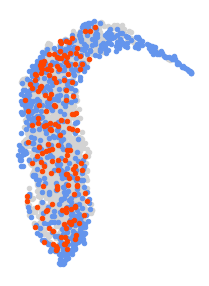

In [63]:
fig, ax = plt.subplots(figsize = (3.5,5))
batches = ['10x', 'C1', 'Ivl']
for ix, batch in enumerate(batches):
    tmp = data_magic[data_magic.obs['batch']==batch]
    umap = tmp.obsm['X_umap']
    ax.scatter(x = umap[:, 0], y = umap[:, 1], color = tmp.uns['batch_colors'], s = 20, alpha = 1)
clean_axis(ax)
plt.savefig(os.path.join(fig_path, 'UMAP_ingest_batch.png'), transparent = True, bbox_inches = 'tight', dpi = 600)

In [49]:
data_magic.uns['leiden_named_colors'] = sbn.color_palette('tab10', n_colors=5)
data_magic.uns['leiden_named_colors'] = convert_rgb_to_hex(adata = data_magic, color_name = 'leiden_named')

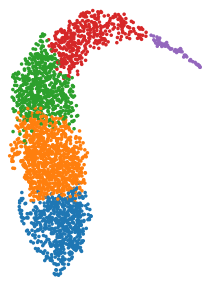

In [79]:
fig, ax = plt.subplots(figsize = (3.5,5))
add_perc = 0.2
umap = data_magic.obsm['X_umap']
sc.pl.umap(data_magic, color = 'leiden_named', frameon = False, title = '', legend_loc = None, ax = ax, show = False, s = 50)
ax.set_xlim([umap[:,0].min()-add_perc, umap[:,0].max()+add_perc])
ax.set_ylim([umap[:,1].min()-add_perc, umap[:,1].max()+add_perc])
plt.savefig(os.path.join(fig_path, 'UMAP_ingest_leiden_named.png'), transparent = True, bbox_inches = 'tight', dpi = 600, pad_inches = 0)

In [82]:
expression.flatten()

array([1.0108659, 1.1477793, 0.       , ..., 2.9883015, 3.525195 ,
       2.3245811], dtype=float32)

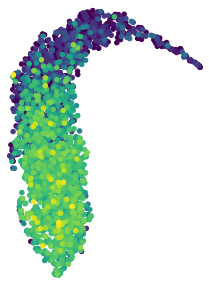

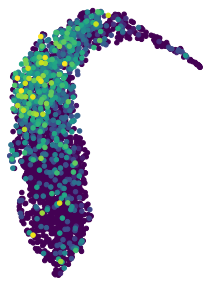

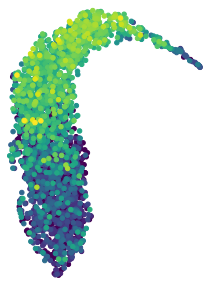

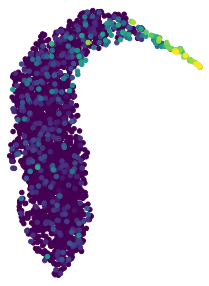

In [89]:
percentile = 99.9
add_perc = 0.2
for gene in ['Krt14','Mt4', 'Krt10','Lor']:
    fig, ax = plt.subplots(figsize = (3.5,5))
    
    vmax = np.percentile(data_magic.raw.X[:, np.where(
        data_magic.raw.var_names == gene)[0]].flatten(), q = percentile)
    umap = data_magic.obsm['X_umap']
    expression = data_magic.raw.X[:,np.where(data_magic.raw.var_names == gene)[0]]
    
    expression = expression.flatten()
    rank = np.argsort(expression)
    expression = np.array(expression)[rank]
    umap = np.array(umap)[rank]
    
    ax.scatter(x = umap[:, 0], y = umap[:, 1], c = expression, cmap = 'viridis', s = 20, alpha = 1, vmax = vmax)
    
    ax.set_xlim([umap[:,0].min()-add_perc, umap[:,0].max()+add_perc])
    ax.set_ylim([umap[:,1].min()-add_perc, umap[:,1].max()+add_perc])
    clean_axis(ax)
    
    plt.savefig(os.path.join(fig_path, 'IFE_umap_expression_downsampled_{}.png'.format(gene)), transparent = True, bbox_inches = 'tight', dpi = 600)

In [179]:
gradient = np.linspace(0, 1, 256)
gradient = np.vstack((gradient, gradient))

fig, ax = plt.subplots(nrows=1, figsize = (5,0.2))

ax.imshow(gradient, aspect='auto', cmap=plt.get_cmap('viridis'))
pos = list(ax.get_position().bounds)
ax.set_axis_off()

plt.savefig(os.path.join(fig_path, 'Viridis_cbar.png'), transparent = True, bbox_inches = 'tight', dpi = 600)

In [181]:
gradient = np.linspace(0, 1, 256)
gradient = np.vstack((gradient, gradient))

fig, ax = plt.subplots(nrows=1, figsize = (5,0.2))

ax.imshow(gradient, aspect='auto', cmap=plt.get_cmap('YlOrRd'))
pos = list(ax.get_position().bounds)
ax.set_axis_off()

plt.savefig(os.path.join(fig_path, 'YlOrRd_cbar.png'), transparent = True, bbox_inches = 'tight', dpi = 600)

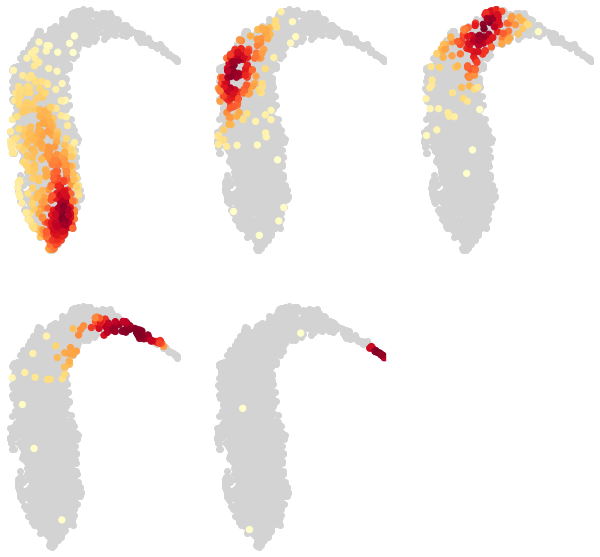

In [101]:
ncols = 3
nrows = 2
fig, axes = plt.subplots(ncols = ncols, nrows = nrows, figsize = (3.5*ncols, 5*nrows))

add_perc = 0.2
for ix, cat in enumerate([x for x in data_magic.obs['C1_pred_cluster'].cat.categories if x != '10x']):
    ax = axes[ix//ncols, ix%ncols]
    umap = data_magic.obsm['X_umap']
    
    tmp_values_pos = data_magic[data_magic.obs['C1_pred_cluster']==cat].obs['umap_density_C1_pred_cluster'].values
    tmp_umap_pos = data_magic[data_magic.obs['C1_pred_cluster']==cat].obsm['X_umap']
    
    ax.scatter(x = umap[:, 0], y = umap[:, 1], color = 'lightgrey')
    ax.scatter(x = tmp_umap_pos[:, 0], y = tmp_umap_pos[:, 1], color = [plt.cm.YlOrRd(x) for x in tmp_values_pos], s = 40)
    #ax.set_title(cat)
    
    ax.set_xlim([umap[:,0].min()-add_perc, umap[:,0].max()+add_perc])
    ax.set_ylim([umap[:,1].min()-add_perc, umap[:,1].max()+add_perc])
    
    clean_axis(ax)

    
"""batches = ['10x', 'C1', 'Ivl']
ax = axes[-1,-1]

umap = data_magic.obsm['X_umap']

for ix, batch in enumerate(batches):
    tmp = data_magic[data_magic.obs['batch']==batch]
    tmp_umap = tmp.obsm['X_umap']
    ax.scatter(x = tmp_umap[:, 0], y = tmp_umap[:, 1], color = tmp.uns['batch_colors'], s = 20, alpha = 1)
    
ax.set_xlim([umap[:,0].min()-add_perc, umap[:,0].max()+add_perc])
ax.set_ylim([umap[:,1].min()-add_perc, umap[:,1].max()+add_perc])"""
    
clean_subplots(ix, axes, ncols, keep_lone_xticklabels=False)
clear_output()
fig.savefig(os.path.join(fig_path, 'IFE_umap_embedding-density_Clustering.png'), transparent = True, bbox_inches = 'tight', dpi = 600)

In [ ]:
for b_ix, batch in enumerate(['10x','C1','Ivl']):
    for g_ix, g in enumerate(genes):
        ax = axes[g_ix, b_ix]
        ax.scatter(x = data_magic.obsm['X_umap'][:, 0], y = data_magic.obsm['X_umap'][:, 1], 
                   c = 'lightgrey', s = 20)

In [217]:
tmp.obs['pred_cluster']

1772067075-D05-ife-C1      IFE B
1772067086-E12-ife-C1      IFE B
1772072282-G12-ife-C1      IFE B
1772067078-F11-ife-C1      IFE B
1772067078-G05-ife-C1      IFE B
                          ...   
1772072284-A01-ife-C1    IFE KII
1772067087-D07-ife-C1    IFE KII
1772067072-B04-ife-C1    IFE KII
1772071051-B10-ife-C1    IFE KII
1772071061-A08-ife-C1    IFE KII
Name: pred_cluster, Length: 636, dtype: category
Categories (5, object): [IFE B, IFE DI, IFE DII, IFE KI, IFE KII]

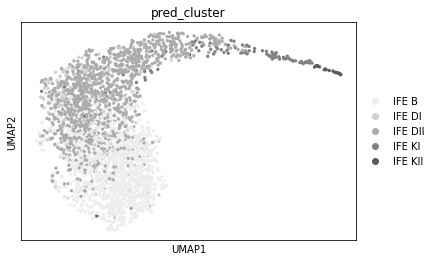

In [221]:
data_magic.uns['pred_cluster_colors'] = sbn.color_palette('Greys', n_colors=6)[:5]
data_magic.uns['pred_cluster_colors'] = convert_rgb_to_hex(adata = data_magic, color_name = 'pred_cluster')
sc.pl.umap(data_magic, color = 'pred_cluster')

In [233]:
data_magic.raw = sc.read_csv(os.path.join(path, '{}_raw_counts.csv'.format(raw_filename_downsampled)))

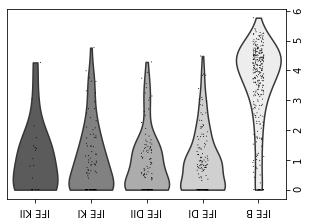

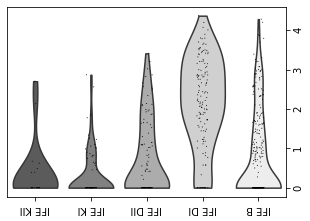

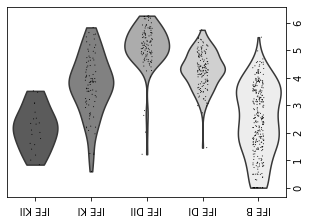

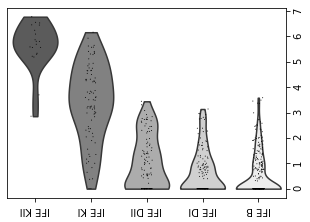

In [230]:
percentile = 99.9
for gene in ['Krt14','Mt4', 'Krt10','Lor']:
    fig, ax = plt.subplots(figsize = (5,3.5))
    tmp = data_magic[data_magic.obs['batch']=='C1']
    sc.pl.violin(tmp, keys = gene, groupby = 'pred_cluster', frameon = False, ax = ax, show = False, use_raw = True, rotation = 180, 
                 order = ['IFE KII', 'IFE KI', 'IFE DII', 'IFE DI', 'IFE B'])
    ax.set_xlabel('')
    ax.set_ylabel('')
    
    ax.yaxis.tick_right()
    ax.yaxis.set_label_position("right")
    plt.yticks(rotation = 90)
    
    plt.savefig(os.path.join(fig_path, 'IFE_C1_violinplot_horizontal_{}.png'.format(gene)), transparent = True, bbox_inches = 'tight', dpi = 600)

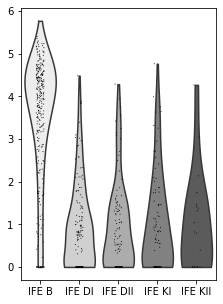

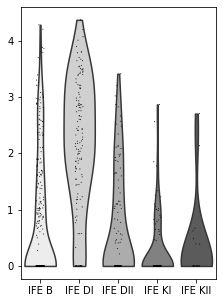

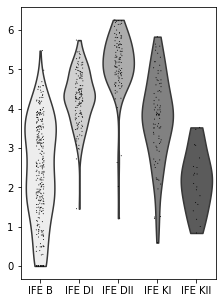

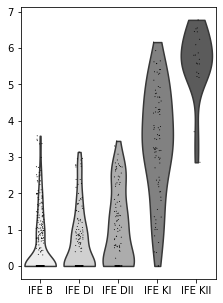

In [232]:
for gene in ['Krt14','Mt4', 'Krt10','Lor']:
    fig, ax = plt.subplots(figsize = (3.5,5))
    tmp = data_magic[data_magic.obs['batch']=='C1']
    sc.pl.violin(tmp, keys = gene, groupby = 'pred_cluster', frameon = False, ax = ax, show = False, use_raw = True)
    ax.set_xlabel('')
    ax.set_ylabel('')
    
    plt.savefig(os.path.join(fig_path, 'IFE_C1_violinplot_{}.png'.format(gene)), transparent = True, bbox_inches = 'tight', dpi = 600)

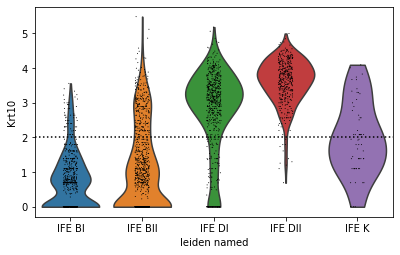

In [33]:
g = sc.pl.violin(data_magic, keys = 'Krt10', groupby= 'leiden_named', show = False)
g.axhline(2, ls = ':', c = 'k')

In [7]:
data_magic.obs.groupby('Location')['Krt10 class'].value_counts()

Location    Krt10 class
Basal       Krt10-         1314
            Krt10+          996
Suprabasal  Krt10+          319
            Krt10-           17
Name: Krt10 class, dtype: int64

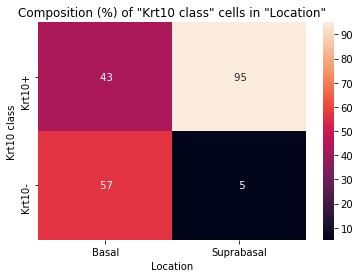

In [11]:
plot_group_composition_heatmap(data_magic.obs, groupby_name = 'Location', count_group_name='Krt10 class', transpose = True)

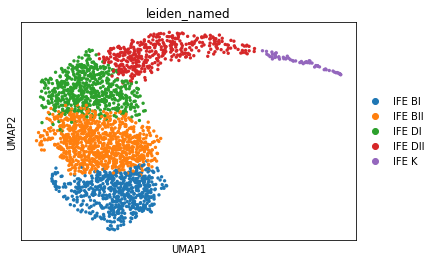

In [16]:
sc.pl.umap(data_magic, color = 'leiden_named')

In [13]:
sc.tl.rank_genes_groups(data_magic, groupby = 'leiden_named', use_raw = True)

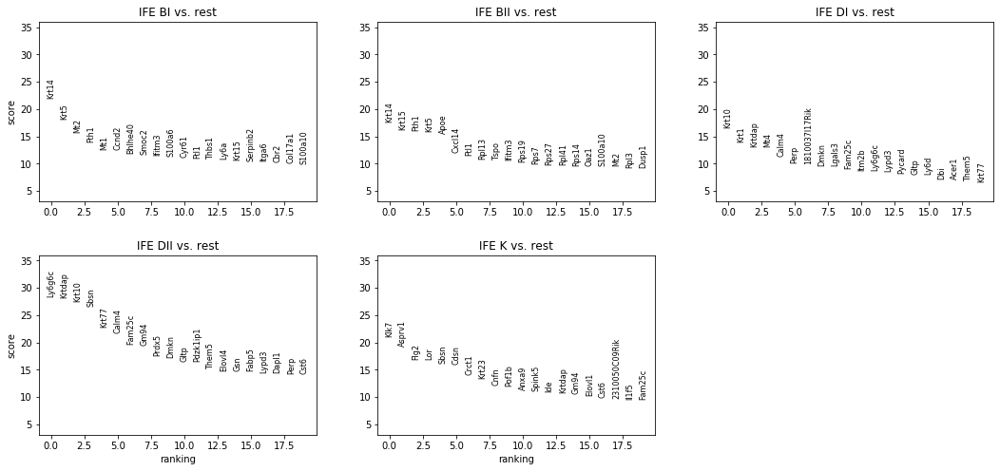

In [15]:
sc.pl.rank_genes_groups(data_magic, ncols = 3)

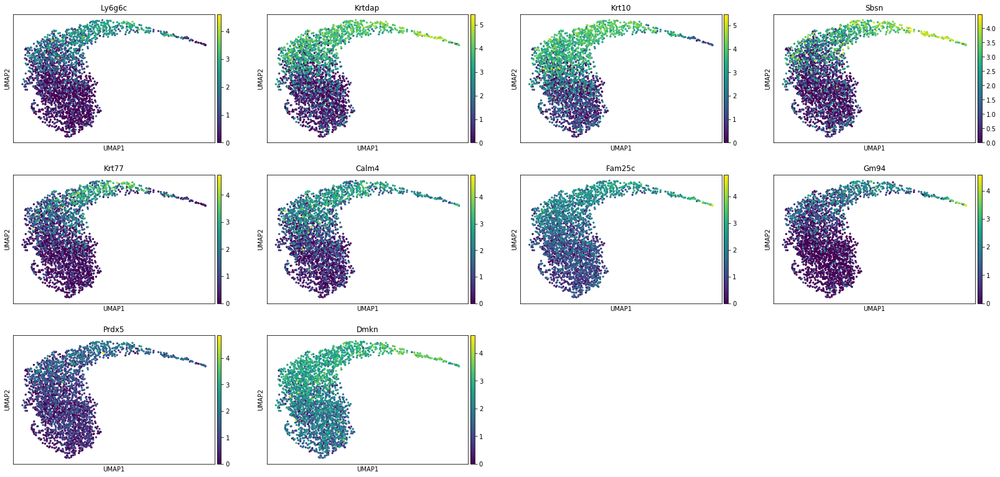

In [22]:
sc.pl.umap(data_magic, color = genes, use_raw = True, ncols = 3)

In [5]:
data_magic.uns['pred_cluster_colors'] = convert_rgb_to_hex(adata = data_magic, color_name='pred_cluster')

In [6]:
tmp_c1 = data_magic[data_magic.obs['batch']=='C1',:]
tmp_10x = data_magic[data_magic.obs['batch']=='10x',:]
tmp_ivl = data_magic[data_magic.obs['batch']=='Ivl',:]

Trying to set attribute `.obs` of view, making a copy.
... storing '10x_leiden' as categorical
Trying to set attribute `.obs` of view, making a copy.
... storing 'Basa-Suprabasal' as categorical
Trying to set attribute `.obs` of view, making a copy.
... storing 'C1_pred_cluster' as categorical
Trying to set attribute `.obs` of view, making a copy.
... storing 'Ivl_cells' as categorical
Trying to set attribute `.obs` of view, making a copy.
... storing 'Krt10 class' as categorical
Trying to set attribute `.obs` of view, making a copy.
... storing 'Krt10_group' as categorical
Trying to set attribute `.obs` of view, making a copy.
... storing 'Krt14_group' as categorical
Trying to set attribute `.obs` of view, making a copy.
... storing 'Location' as categorical
Trying to set attribute `.obs` of view, making a copy.
... storing 'batch' as categorical
Trying to set attribute `.obs` of view, making a copy.
... storing 'cell_identity' as categorical
Trying to set attribute `.obs` of view, ma

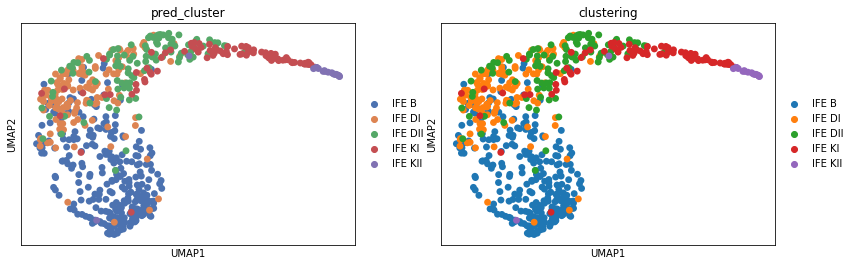

In [7]:
sc.pl.umap(tmp_c1, color = ['pred_cluster', 'clustering'])

In [8]:
cluster_dict = {'IFE KI': 3, 'IFE DII': 2, 'IFE B': 0, 'IFE KII': 4, 'IFE DI': 1}
cluster_dict_transposed = {val: key for key, val in cluster_dict.items()}
cluster_encoded = [cluster_dict[x] for x in tmp_c1.obs['clustering']]

In [9]:
neigh = KNeighborsClassifier(n_neighbors=20, weights='distance')
neigh.fit(tmp_c1.raw.X, cluster_encoded)
prediction = neigh.predict(tmp_10x.raw.X)
#print(prediction)

neigh_imp = KNeighborsClassifier(n_neighbors=20, weights='distance')
neigh_imp.fit(tmp_c1.X, cluster_encoded)
prediction_imp = neigh_imp.predict(tmp_10x.X)
#print(prediction)

Trying to set attribute `.obs` of view, making a copy.
... storing '10x_leiden' as categorical
... storing 'Basa-Suprabasal' as categorical
... storing 'C1_pred_cluster' as categorical
... storing 'Ivl_cells' as categorical
... storing 'Krt10 class' as categorical
... storing 'Krt10_group' as categorical
... storing 'Krt14_group' as categorical
... storing 'Location' as categorical
... storing 'batch' as categorical
... storing 'cell_identity' as categorical
... storing 'clustering' as categorical
... storing 'layer' as categorical
... storing 'leiden' as categorical
... storing 'leiden_named' as categorical
... storing 'phase' as categorical
... storing 'phase_c0' as categorical
... storing 'phase_c0.05' as categorical
... storing 'phase_c0.1' as categorical
... storing 'phase_c0.2' as categorical
... storing 'phase_separate_original' as categorical
... storing 'pred_cluster' as categorical
... storing 'pred_cluster_ds' as categorical
... storing 'pred_cluster_imp' as categorical


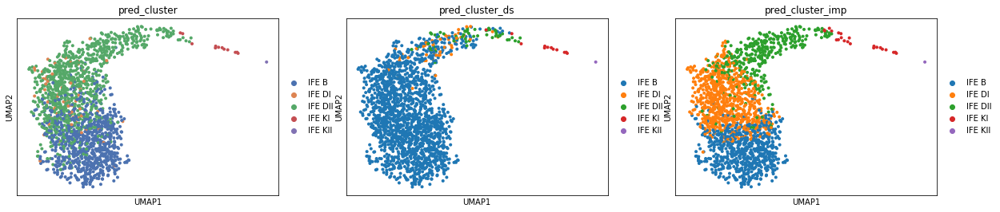

In [10]:
tmp_10x.obs['pred_cluster_ds'] = [cluster_dict_transposed[x] for x in prediction]
tmp_10x.obs['pred_cluster_imp'] = [cluster_dict_transposed[x] for x in prediction_imp]
sc.pl.umap(tmp_10x, color = ['pred_cluster','pred_cluster_ds', 'pred_cluster_imp'])

In [11]:
prediction = neigh.predict(tmp_ivl.raw.X)

prediction_imp = neigh_imp.predict(tmp_ivl.X)

Trying to set attribute `.obs` of view, making a copy.
... storing '10x_leiden' as categorical
... storing 'Basa-Suprabasal' as categorical
... storing 'C1_pred_cluster' as categorical
... storing 'Ivl_cells' as categorical
... storing 'Krt10 class' as categorical
... storing 'Krt10_group' as categorical
... storing 'Krt14_group' as categorical
... storing 'Location' as categorical
... storing 'batch' as categorical
... storing 'cell_identity' as categorical
... storing 'clustering' as categorical
... storing 'layer' as categorical
... storing 'leiden' as categorical
... storing 'leiden_named' as categorical
... storing 'phase' as categorical
... storing 'phase_c0' as categorical
... storing 'phase_c0.05' as categorical
... storing 'phase_c0.1' as categorical
... storing 'phase_c0.2' as categorical
... storing 'phase_separate_original' as categorical
... storing 'pred_cluster' as categorical
... storing 'pred_cluster_ds' as categorical
... storing 'pred_cluster_imp' as categorical


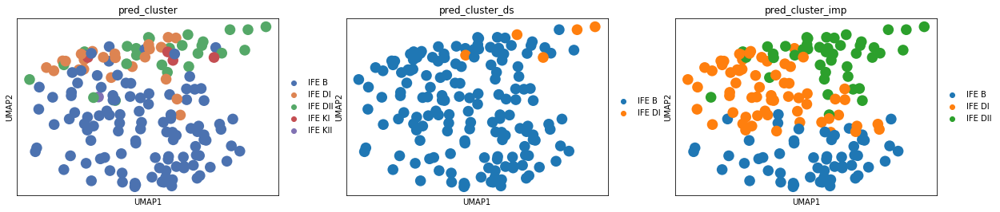

In [12]:
tmp_ivl.obs['pred_cluster_ds'] = [cluster_dict_transposed[x] for x in prediction]
tmp_ivl.obs['pred_cluster_imp'] = [cluster_dict_transposed[x] for x in prediction_imp]
sc.pl.umap(tmp_ivl, color = ['pred_cluster','pred_cluster_ds', 'pred_cluster_imp'])

In [13]:
cluster = 'pred_cluster_ds'
data_magic.obs[cluster] = [tmp_10x.obs[cluster].loc[cell] if '10x' in cell else tmp_ivl.obs[cluster].loc[cell] if 'Tomato' in cell else tmp_c1.obs['clustering'].loc[cell] for cell in data_magic.obs_names]
cluster = 'pred_cluster_imp'
data_magic.obs[cluster] = [tmp_10x.obs[cluster].loc[cell] if '10x' in cell else tmp_ivl.obs[cluster].loc[cell] if 'Tomato' in cell else tmp_c1.obs['clustering'].loc[cell] for cell in data_magic.obs_names]

... storing '10x_leiden' as categorical
... storing 'Basa-Suprabasal' as categorical
... storing 'C1_pred_cluster' as categorical
... storing 'Ivl_cells' as categorical
... storing 'Krt10 class' as categorical
... storing 'Krt10_group' as categorical
... storing 'Krt14_group' as categorical
... storing 'Location' as categorical
... storing 'batch' as categorical
... storing 'cell_identity' as categorical
... storing 'clustering' as categorical
... storing 'layer' as categorical
... storing 'leiden' as categorical
... storing 'leiden_named' as categorical
... storing 'phase' as categorical
... storing 'phase_c0' as categorical
... storing 'phase_c0.05' as categorical
... storing 'phase_c0.1' as categorical
... storing 'phase_c0.2' as categorical
... storing 'phase_separate_original' as categorical
... storing 'pred_cluster' as categorical
... storing 'pred_cluster_ds' as categorical
... storing 'pred_cluster_imp' as categorical


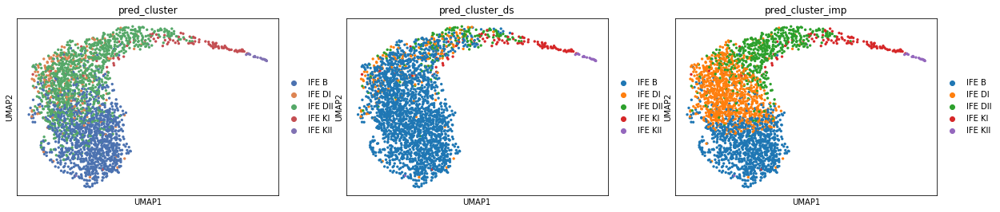

In [14]:
sc.pl.umap(data_magic, color = ['pred_cluster','pred_cluster_ds', 'pred_cluster_imp'])

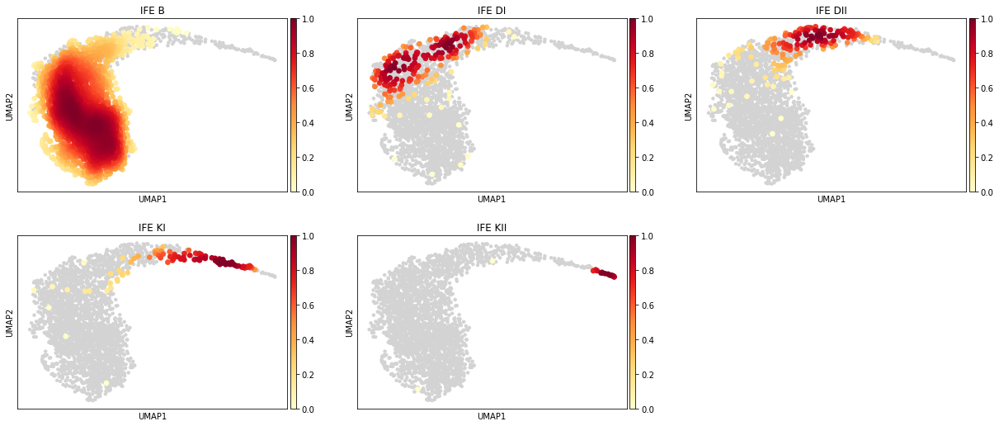

In [29]:
sc.tl.embedding_density(data_magic, groupby = 'pred_cluster_ds')
sc.pl.embedding_density(data_magic, groupby = 'pred_cluster_ds', ncols = 3)

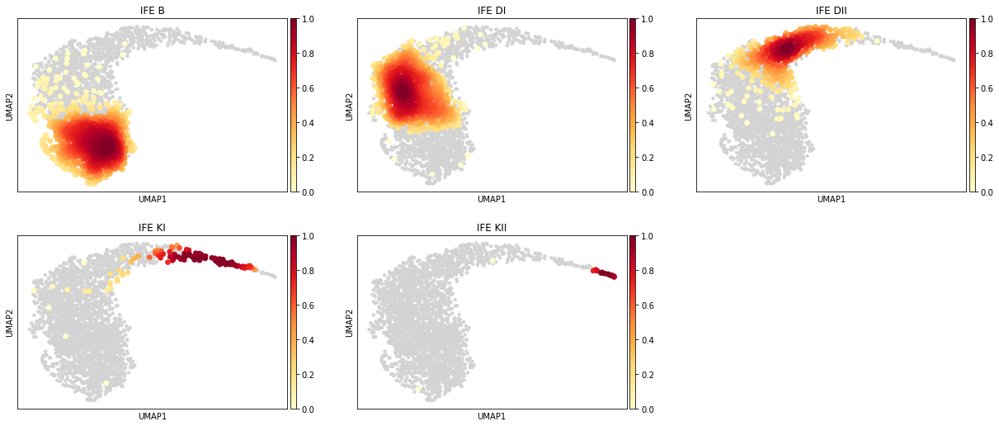

In [30]:
sc.tl.embedding_density(data_magic, groupby = 'pred_cluster_imp')
sc.pl.embedding_density(data_magic, groupby = 'pred_cluster_imp', ncols = 3)

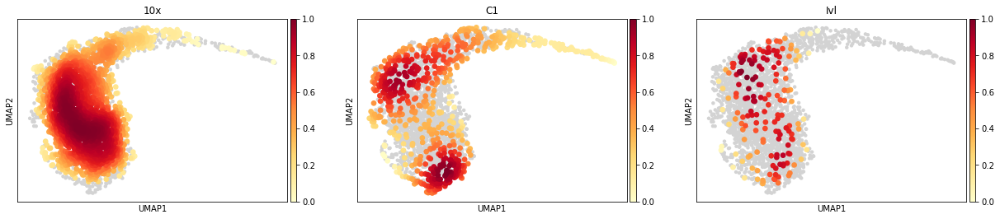

In [84]:
sc.tl.embedding_density(data_magic, groupby = 'batch')
sc.pl.embedding_density(data_magic, groupby = 'batch', ncols = 3)

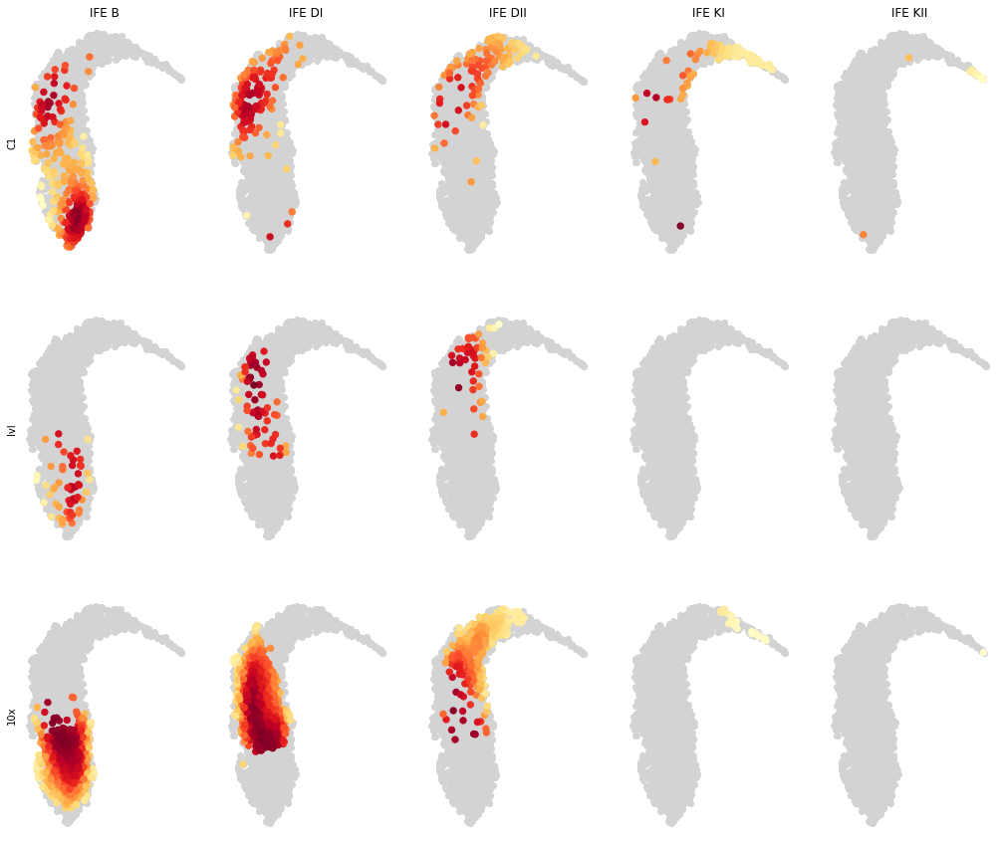

In [99]:
cluster_name = 'pred_cluster_imp'
clusters = data_magic.obs[cluster_name].cat.categories
density_name = 'batch'

ncols = len(clusters)
nrows = 3
fig, axes = plt.subplots(ncols = ncols, nrows = nrows, figsize = (3.5*ncols, 5*nrows))


umap = data_magic.obsm['X_umap']

for c_ix, cat in enumerate(clusters):
    for ix, batch in enumerate(['C1','Ivl','10x']):
        ax = axes[ix, c_ix]
        
        tmp = data_magic[(data_magic.obs[cluster_name]==cat) & (data_magic.obs['batch'] == batch),:]
        tmp_values_pos = tmp.obs['umap_density_{}'.format(density_name)].values
        tmp_umap_pos = tmp.obsm['X_umap']

        ax.scatter(x = umap[:, 0], y = umap[:, 1], color = 'lightgrey')
        ax.scatter(x = tmp_umap_pos[:, 0], y = tmp_umap_pos[:, 1], color = [plt.cm.YlOrRd(x) for x in tmp_values_pos], s = 40)
        
        
        clean_axis(ax)
        if c_ix == 0:
            ax.set_ylabel(batch)
        
        if ix == 0:
            ax.set_title(cat)

    clear_output(wait = True)
#fig.savefig(os.path.join(fig_path, 'IFE_umap_embedding-density_Clustering.pdf'), transparent = True, bbox_inches = 'tight')

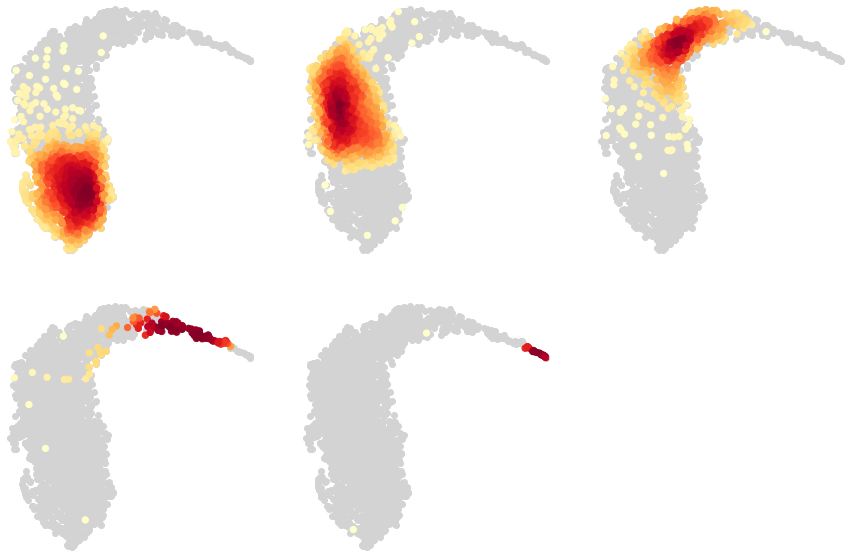

In [111]:
ncols = 3
nrows = 2
fig, axes = plt.subplots(ncols = ncols, nrows = nrows, figsize = (5*ncols, 5*nrows))

add_perc = 0.2
for ix, cat in enumerate([x for x in data_magic.obs['pred_cluster_imp'].cat.categories if x != '10x']):
    ax = axes[ix//ncols, ix%ncols]
    umap = data_magic.obsm['X_umap']
    
    tmp_values_pos = data_magic[data_magic.obs['pred_cluster_imp']==cat].obs['umap_density_pred_cluster_imp'].values
    tmp_umap_pos = data_magic[data_magic.obs['pred_cluster_imp']==cat].obsm['X_umap']
    
    ax.scatter(x = umap[:, 0], y = umap[:, 1], color = 'lightgrey')
    ax.scatter(x = tmp_umap_pos[:, 0], y = tmp_umap_pos[:, 1], color = [plt.cm.YlOrRd(x) for x in tmp_values_pos], s = 40)
    #ax.set_title(cat)
    
    ax.set_xlim([umap[:,0].min()-add_perc, umap[:,0].max()+add_perc])
    ax.set_ylim([umap[:,1].min()-add_perc, umap[:,1].max()+add_perc])
    
    clean_axis(ax)
    
clean_subplots(ix, axes, ncols, keep_lone_xticklabels=False)
clear_output()
fig.savefig(os.path.join(fig_path, 'IFE_umap_embedding-density_pred_cluster_imputated_wider.png'), transparent = True, bbox_inches = 'tight', dpi = 600)

... storing 'Krt10_class_mean' as categorical


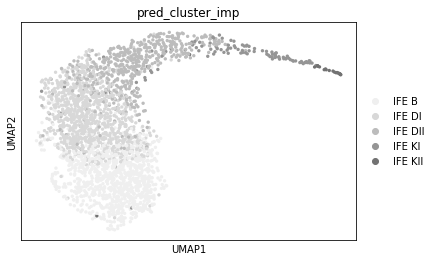

In [25]:
data_magic.uns['pred_cluster_imp_colors'] = sbn.color_palette('Greys', n_colors=7)[:5]
data_magic.uns['pred_cluster_imp_colors'] = convert_rgb_to_hex(adata = data_magic, color_name = 'pred_cluster_imp')
sc.pl.umap(data_magic, color = 'pred_cluster_imp')

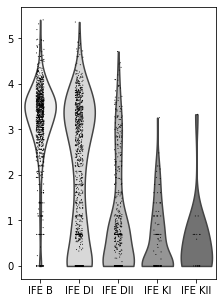

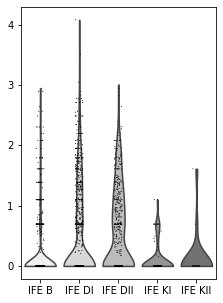

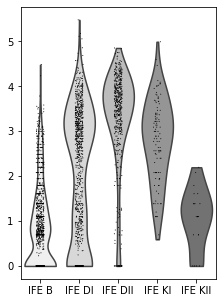

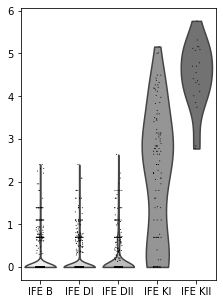

In [110]:
for gene in ['Krt14','Mt4', 'Krt10','Lor']:
    fig, ax = plt.subplots(figsize = (3.5,5))
    sc.pl.violin(data_magic, keys = gene, groupby = 'pred_cluster_imp', frameon = False, ax = ax, show = False, use_raw = True)
    ax.set_xlabel('')
    ax.set_ylabel('')
    
    plt.savefig(os.path.join(fig_path, 'IFE_C1_violinplot_imputated_clusters{}.png'.format(gene)), transparent = True, bbox_inches = 'tight', dpi = 600)

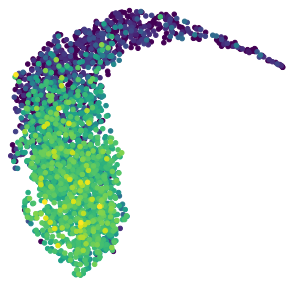

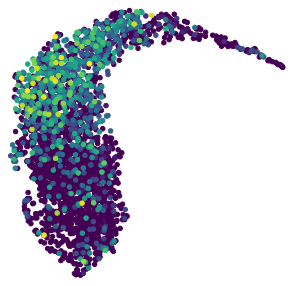

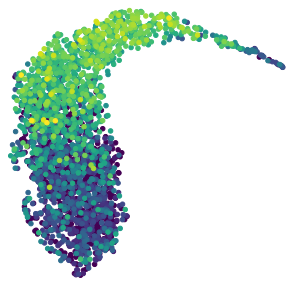

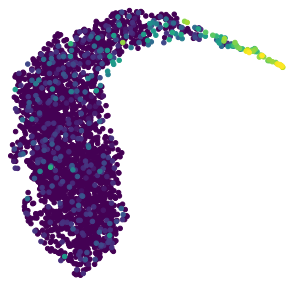

In [113]:
percentile = 99.9
add_perc = 0.2
for gene in ['Krt14','Mt4', 'Krt10','Lor']:
    fig, ax = plt.subplots(figsize = (5,5))
    
    vmax = np.percentile(data_magic.raw.X[:, np.where(
        data_magic.raw.var_names == gene)[0]].flatten(), q = percentile)
    umap = data_magic.obsm['X_umap']
    expression = data_magic.raw.X[:,np.where(data_magic.raw.var_names == gene)[0]]
    
    expression = expression.flatten()
    rank = np.argsort(expression)
    expression = np.array(expression)[rank]
    umap = np.array(umap)[rank]
    
    ax.scatter(x = umap[:, 0], y = umap[:, 1], c = expression, cmap = 'viridis', s = 20, alpha = 1, vmax = vmax)
    
    ax.set_xlim([umap[:,0].min()-add_perc, umap[:,0].max()+add_perc])
    ax.set_ylim([umap[:,1].min()-add_perc, umap[:,1].max()+add_perc])
    clean_axis(ax)
    
    plt.savefig(os.path.join(fig_path, 'IFE_umap_expression_downsampled__wider{}.png'.format(gene)), transparent = True, bbox_inches = 'tight', dpi = 600)

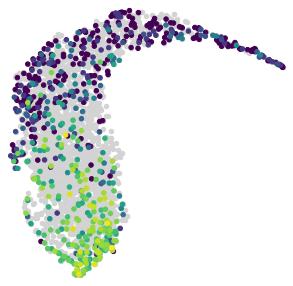

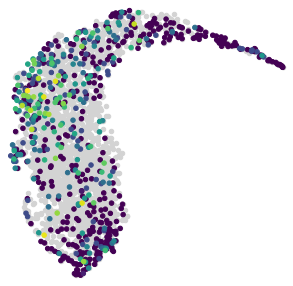

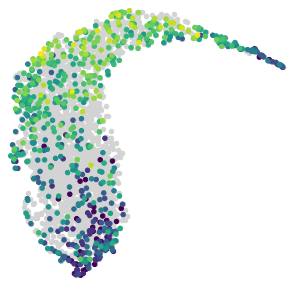

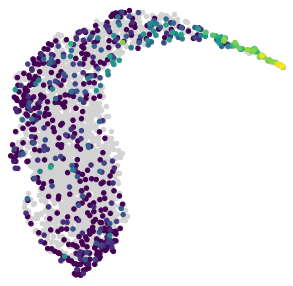

In [117]:
percentile = 99.9
add_perc = 0.2
for gene in ['Krt14','Mt4', 'Krt10','Lor']:
    fig, ax = plt.subplots(figsize = (5,5))
    
    ax.scatter(x = data_magic.obsm['X_umap'][:, 0], y = data_magic.obsm['X_umap'][:, 1], 
                   c = 'lightgrey', s = 20)
    
    """vmax = np.percentile(data_magic.raw.X[:, np.where(
        data_magic.raw.var_names == gene)[0]].flatten(), q = percentile)"""
    umap = data_magic.obsm['X_umap']
    tmp = data_magic[data_magic.obs['batch']=='C1']
    expression = tmp.raw.X[:,np.where(tmp.raw.var_names == gene)[0]]
    
    expression = expression.flatten()
    rank = np.argsort(expression)
    expression = np.array(expression)[rank]
    umap = np.array(umap)[rank]
    
    ax.scatter(x = umap[:, 0], y = umap[:, 1], c = expression, cmap = 'viridis', s = 20, alpha = 1)
    
    ax.set_xlim([umap[:,0].min()-add_perc, umap[:,0].max()+add_perc])
    ax.set_ylim([umap[:,1].min()-add_perc, umap[:,1].max()+add_perc])
    clean_axis(ax)
    
    plt.savefig(os.path.join(fig_path, 'IFE_C1_umap_expression_wider_{}.png'.format(gene)), transparent = True, bbox_inches = 'tight', dpi = 600)

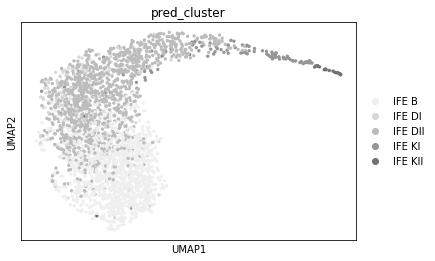

In [120]:
data_magic.uns['pred_cluster_colors'] = sbn.color_palette('Greys', n_colors=7)[:5]
data_magic.uns['pred_cluster_colors'] = convert_rgb_to_hex(adata = data_magic, color_name = 'pred_cluster')
sc.pl.umap(data_magic, color = 'pred_cluster')

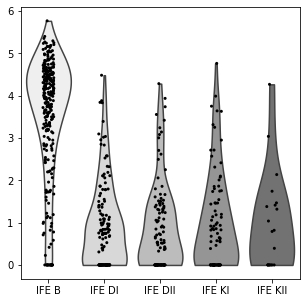

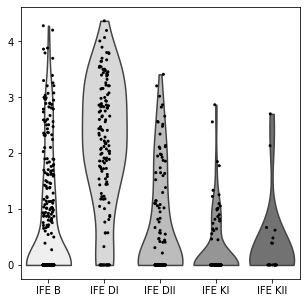

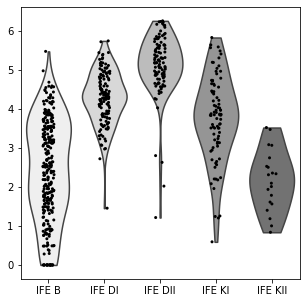

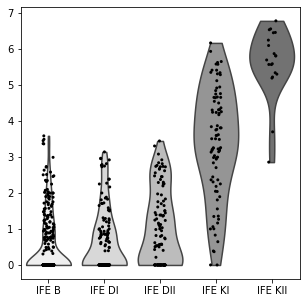

In [125]:
for gene in ['Krt14','Mt4', 'Krt10','Lor']:
    fig, ax = plt.subplots(figsize = (5,5))
    tmp = data_magic[data_magic.obs['batch']=='C1']
    sc.pl.violin(tmp, keys = gene, groupby = 'pred_cluster', frameon = False, ax = ax, 
                 show = False, use_raw = True, size = 3)
    ax.set_xlabel('')
    ax.set_ylabel('')
    
    plt.savefig(os.path.join(fig_path, 'IFE_C1_violinplot_wider_{}.png'.format(gene)), transparent = True, bbox_inches = 'tight', dpi = 600)

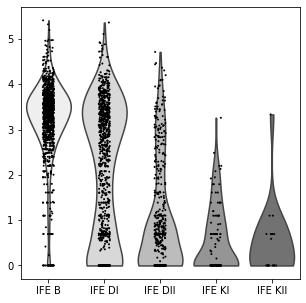

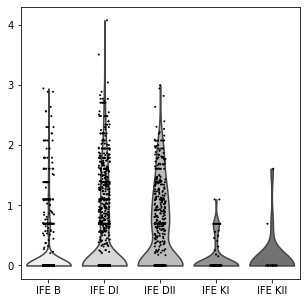

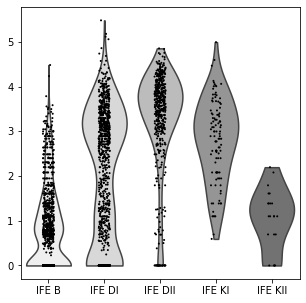

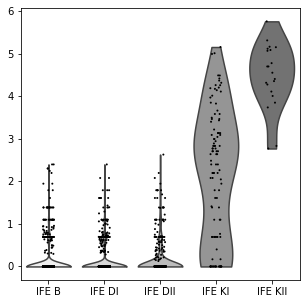

In [129]:
for gene in ['Krt14','Mt4', 'Krt10','Lor']:
    fig, ax = plt.subplots(figsize = (5,5))
    sc.pl.violin(data_magic, keys = gene, groupby = 'pred_cluster_imp', frameon = False, ax = ax, 
                 show = False, use_raw = True, size = 2)
    ax.set_xlabel('')
    ax.set_ylabel('')
    
    plt.savefig(os.path.join(fig_path, 'IFE_C1_violinplot_imputated_clusters_downsampled_wider_{}.png'.format(gene)), transparent = True, bbox_inches = 'tight', dpi = 600)

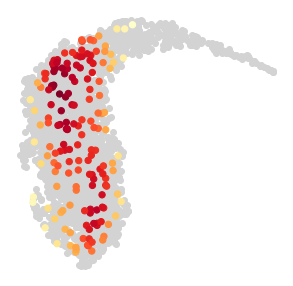

In [115]:
tmp_values_pos = data_magic[data_magic.obs['Ivl_cells']=='Sorted basal'].obs['umap_density_Ivl_cells'].values
tmp_umap_pos = data_magic[data_magic.obs['Ivl_cells']=='Sorted basal'].obsm['X_umap']
tmp_umap_neg = data_magic[data_magic.obs['Ivl_cells']!='Sorted basal'].obsm['X_umap']

fig, ax = plt.subplots(1, figsize = (5,5))
ax.scatter(x = tmp_umap_neg[:, 0], y = tmp_umap_neg[:, 1], color = 'lightgrey')
ax.scatter(x = tmp_umap_pos[:, 0], y = tmp_umap_pos[:, 1], color = [plt.cm.YlOrRd(x) for x in tmp_values_pos], s = 40)

clean_axis(ax)

plt.savefig(os.path.join(fig_path, 'IFE_umap_embedding-density_Ivl-cells_scatter.png'), transparent = True, bbox_inches = 'tight', dpi = 600)

In [37]:
replicates = pd.read_csv(os.path.join('X:/karlan/Seq data/Mouse skin/Anagen_10x/2019 data/data_input/v1.4', '201806201840_assigned_barcodes.txt'), sep = '\t', index_col = None, header = None)

In [38]:
replicates = replicates.drop_duplicates(subset = 0).set_index(0)
replicates.index = replicates.index.str[:14]

tmp10x = data_magic[data_magic.obs['batch'] == '10x']
tmp10x.obs['replicates'] = replicates.loc[tmp10x.obs_names.str[:14]].values.flatten()
tmp10x = tmp10x[tmp10x.obs['replicates']!='unassigned']

Trying to set attribute `.obs` of view, copying.


Trying to set attribute `.obs` of view, copying.
... storing 'Krt10_class_mean' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'replicates' as categorical


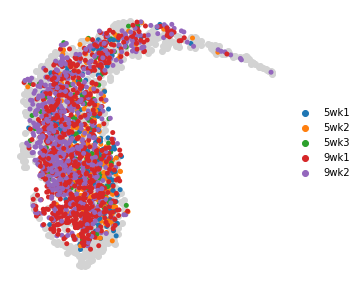

In [40]:
fig, ax = plt.subplots(1, figsize = (5,5))
tmp = data_magic[data_magic.obs['batch']!='10x'].obsm['X_umap']
ax.scatter(x = tmp[:, 0], y = tmp[:, 1], color = 'lightgrey')
sc.pl.umap(tmp10x, color = ['replicates'], s = 100, frameon = False, ax = ax, show = False, title = '')
#fig.savefig(os.path.join(fig_path, 'IFE_umap_10x_replicates.png'), transparent = True, bbox_inches = 'tight', dpi = 600)

In [76]:
phases = ['G1','S','G2M']
rep_df = pd.DataFrame(columns = phases, index = tmp10x.obs['replicates'].cat.categories)
tmp = tmp10x[tmp10x.obs['Krt10 class']=='Krt10+']
for rep in tmp10x.obs['replicates'].cat.categories:
    rep_df.loc[rep] = tmp[tmp.obs['replicates']==rep].obs['phase_c0.05'].value_counts(normalize = True).loc[phases]

In [77]:
rep_df = rep_df.stack().reset_index()
rep_df = rep_df.rename(columns = {'level_0':'Replicate','level_1':'Phase',0:'Percentage'})
rep_df = rep_df.set_index('Replicate')
rep_df['stage'] = ['Telogen' if '9wk' in x else 'Anagen' for x in rep_df.index]

... storing 'Krt10_class_mean' as categorical


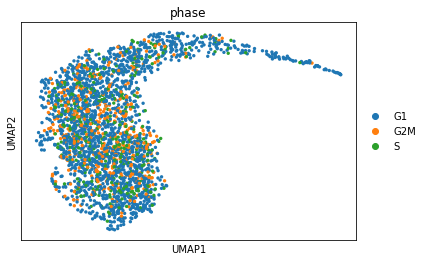

In [113]:
sc.pl.umap(data_magic, color = 'phase')

C:\Users\karlan\AppData\Local\Continuum\anaconda3\envs\scanpy\lib\site-packages\anndata\_core\anndata.py:1172: ImplicitModificationWarning: Initializing view as actual.
  "Initializing view as actual.", ImplicitModificationWarning
Trying to set attribute `.obs` of view, copying.
... storing 'Krt10_class_mean' as categorical


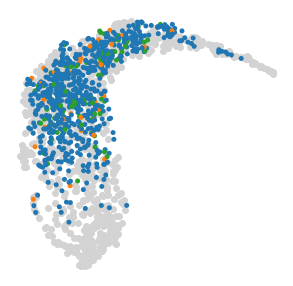

In [112]:
fig, ax = plt.subplots(1, figsize = (5,5))
tmp = data_magic[data_magic.obs['batch']!='10x'].obsm['X_umap']
ax.scatter(x = tmp[:, 0], y = tmp[:, 1], color = 'lightgrey')
sc.pl.umap(data_magic[(data_magic.obs['batch']=='10x') & (data_magic.obs['Krt10_class_mean']=='Krt10+')], 
           color = ['phase_c0.05'], s = 100, frameon = False, ax = ax, show = False, legend_loc = False, title = '')
fig.savefig(os.path.join(fig_path, 'IFE_umap_10x_Krt10-pos_cc.png'), transparent = True, bbox_inches = 'tight', dpi = 600)

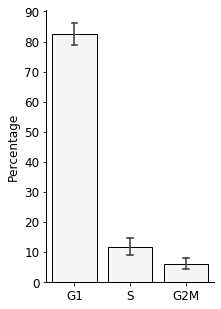

In [111]:
fig, ax = plt.subplots(1, figsize = (3,5))
sbn.barplot(data = rep_df, x = 'Phase', y = 'Percentage', color = 'whitesmoke', ax = ax, edgecolor = 'k', capsize = 0.1)
ax.set_yticks(np.arange(0,0.91, 0.10))
ax.set_yticklabels(np.arange(0,91, 10))

ax.set_xlabel('')
ax.set_xticklabels(['G1','S','G2M'],fontsize=12)
ax.set_ylabel('Percentage',fontsize=12)
ax.tick_params(labelsize=12)

for loc in ['right','top']:
    ax.spines[loc].set_visible(False)
    
ax.spines['left'].set_linewidth(1)
ax.spines['bottom'].set_linewidth(1)


fig.savefig(os.path.join(fig_path, 'IFE_Krt10_cc_percentages.pdf'), transparent = True, bbox_inches = 'tight', dpi = 600)

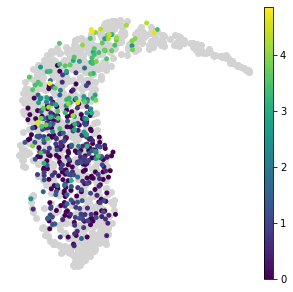

In [131]:
fig, ax = plt.subplots(1, figsize = (5,5))
tmp = data_magic[data_magic.obs['batch']!='10x'].obsm['X_umap']
ax.scatter(x = tmp[:, 0], y = tmp[:, 1], color = 'lightgrey')
sc.pl.umap(data_magic[(data_magic.obs['batch']=='10x') & (data_magic.obs['phase_c0.05'].isin(['G2M','S']))], 
           color = ['Krt10'], s = 100, frameon = False, ax = ax, show = False, title = '')
fig.savefig(os.path.join(fig_path, 'IFE_umap_10x_Krt10_expression_in_cycling_cells.png'), transparent = True, bbox_inches = 'tight', dpi = 600)

In [114]:
k10_stat = ['Krt10+', 'Krt10-']
rep_df = pd.DataFrame(columns = k10_stat, index = tmp10x.obs['replicates'].cat.categories)
tmp = tmp10x[tmp10x.obs['phase_c0.05'].isin(['G2M', 'S'])]
for rep in tmp10x.obs['replicates'].cat.categories:
    rep_df.loc[rep] = tmp[tmp.obs['replicates']==rep].obs['Krt10_class_mean'].value_counts(normalize = True).loc[k10_stat]

In [115]:
rep_df = rep_df.stack().reset_index()
rep_df = rep_df.rename(columns = {'level_0':'Replicate','level_1':'Krt10_class_mean',0:'Percentage'})
rep_df = rep_df.set_index('Replicate')
rep_df['stage'] = ['Telogen' if '9wk' in x else 'Anagen' for x in rep_df.index]

In [118]:
df = pd.DataFrame()

In [119]:
fig_path

'C:/Users/karlan/Google Drive/MKA/Papers/Greco/Katie/Figure_output'

In [120]:
rep_df.reset_index().to_csv(os.path.join(fig_path, 'Krt10_classification_in_cycling_cells.csv'))

In [68]:
rep_df[rep_df['Krt10_class_mean']=='Krt10+']['Percentage']

Replicate
5wk1    0.267606
5wk2    0.215385
5wk3    0.216216
9wk1     0.28125
9wk2    0.243478
Name: Percentage, dtype: object

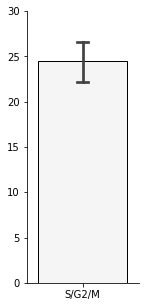

In [74]:
fig, ax = plt.subplots(1, figsize = (2,5))
sbn.barplot(data = rep_df, x = 'Krt10_class_mean', y = 'Percentage', color = 'whitesmoke', ax = ax, order = ['Krt10+'], capsize=0.1, edgecolor = 'k')
ax.set_yticks(np.arange(0,0.31, 0.05))
ax.set_yticklabels(np.arange(0,31,5))
ax.set_xlabel('')
ax.set_xticklabels(['S/G2/M'])
ax.set_ylabel('')

for loc in ['right','top']:
    ax.spines[loc].set_visible(False)
fig.savefig(os.path.join(fig_path, 'IFE_Krt10_percentages_in_cycling_cells.pdf'), transparent = True, bbox_inches = 'tight', dpi = 600)

In [ ]:
fig, ax = plt.subplots(1, figsize = (2,5))
sbn.barplot(data = rep_df, x = 'Krt10 class', y = 'Percentage', color = 'grey', ax = ax)
ax.set_yticks(np.arange(0,0.91, 0.10))
ax.set_yticklabels(np.arange(0,91, 10))
ax.set_xlabel('')

for loc in ['right','top']:
    ax.spines[loc].set_visible(False)
#fig.savefig(os.path.join(fig_path, 'IFE_Krt10_percentages_in_cycling_cells.png'), transparent = True, bbox_inches = 'tight', dpi = 600)

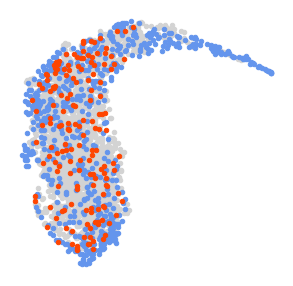

In [145]:
fig, ax = plt.subplots(figsize = (5,5))
batches = ['10x', 'C1', 'Ivl']
for ix, batch in enumerate(batches):
    tmp = data_magic[data_magic.obs['batch']==batch]
    umap = tmp.obsm['X_umap']
    ax.scatter(x = umap[:, 0], y = umap[:, 1], color = tmp.uns['batch_colors'], s = 20, alpha = 1)
clean_axis(ax)
plt.savefig(os.path.join(fig_path, 'UMAP_ingest_batch_wider.png'), transparent = True, bbox_inches = 'tight', dpi = 600)

# Checkpoint 5

In [3]:
fig_path = 'C:/Users/karlan/Google Drive/MKA/Papers/Greco/Katie/Figure_output'
path = 'C:/Users/karlan/Google Drive/MKA/Epidermal stem cells at the point of no return/Sequencing results/Combined_With_Joost_IFE/'
filename = '20200413_ingest_combined_imputed_cc-regressed'
raw_filename = '20200408_ingest_combined_imputed_cc-regressed'
raw_filename_downsampled = '20200415_ingest_combined_imputed_cc-regressed_downscaled'

sc.settings.figdir = fig_path

data_magic = sc.read_loom(os.path.join(path, '{}.loom'.format(filename)))

data_magic.raw = sc.read_csv(os.path.join(path, '{}_raw_counts.csv'.format(raw_filename_downsampled)))

with open(os.path.join(path, '{}_MST.pickle'.format(raw_filename)), 'rb') as file:
    MST = pickle.load(file)
    
with open(os.path.join(path, '{}_uns.pickle'.format(filename)), 'rb') as file:
    data_magic.uns = pickle.load(file)

C:\Users\karlan\AppData\Local\Continuum\anaconda3\envs\scanpy\lib\site-packages\loompy\loom_validator.py:48: H5pyDeprecationWarning: The default file mode will change to 'r' (read-only) in h5py 3.0. To suppress this warning, pass the mode you need to h5py.File(), or set the global default h5.get_config().default_file_mode, or set the environment variable H5PY_DEFAULT_READONLY=1. Available modes are: 'r', 'r+', 'w', 'w-'/'x', 'a'. See the docs for details.
  with h5py.File(path) as f:


In [4]:
data_magic

AnnData object with n_obs × n_vars = 2646 × 842 
    obs: '10x_leiden', 'Basa-Suprabasal', 'C1_pred_cluster', 'G2M_score', 'G2M_score_separate_original', 'Ivl_cells', 'Krt10 class', 'Krt10_group', 'Krt14_group', 'Location', 'S_score', 'S_score_separate_original', 'batch', 'cell_identity', 'clustering', 'dpt_pseudotime', 'layer', 'leiden', 'leiden_named', 'log1p_n_genes_by_counts', 'log1p_total_counts', 'log1p_total_counts_ERCC', 'log1p_total_counts_mito', 'n_genes', 'n_genes_by_counts', 'pct_counts_ERCC', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'pct_counts_in_top_50_genes', 'pct_counts_mito', 'phase', 'phase_c0', 'phase_c0.05', 'phase_c0.1', 'phase_c0.2', 'phase_separate_original', 'pred_cluster', 'pto_coords', 'pto_coords_diffmap', 'total_counts', 'total_counts_ERCC', 'total_counts_mito', 'umap_density_C1_pred_cluster', 'umap_density_Ivl_cells', 'umap_density_Krt10 class', 'umap_density_batch', 'umap_density_cell_identity', 'umap_de

In [5]:
data_magic[data_magic.obs['batch'] == 'Ivl'].obs['total_counts']

1772-146-139-Tomato-minus_2209-B04-ivl-C1    2370.0
1772-146-139-Tomato-minus_2209-C03-ivl-C1    3518.0
1772-146-139-Tomato-minus_2209-D07-ivl-C1    4161.0
1772-146-139-Tomato-minus_2209-D08-ivl-C1    2928.0
1772-146-139-Tomato-minus_2209-D09-ivl-C1    6298.0
                                              ...  
1772-158-161-Tomato-minus_1710-G10-ivl-C1    2283.0
1772-158-161-Tomato-minus_1710-G12-ivl-C1    3087.0
1772-158-161-Tomato-minus_1710-H02-ivl-C1    3345.0
1772-158-161-Tomato-minus_1710-H03-ivl-C1    1826.0
1772-158-161-Tomato-minus_1710-H06-ivl-C1    1005.0
Name: total_counts, Length: 163, dtype: float64

... storing '10x_leiden' as categorical
... storing 'Basa-Suprabasal' as categorical
... storing 'C1_pred_cluster' as categorical
... storing 'Ivl_cells' as categorical
... storing 'Krt10 class' as categorical
... storing 'Krt10_group' as categorical
... storing 'Krt14_group' as categorical
... storing 'Location' as categorical
... storing 'batch' as categorical
... storing 'cell_identity' as categorical
... storing 'clustering' as categorical
... storing 'layer' as categorical
... storing 'leiden' as categorical
... storing 'leiden_named' as categorical
... storing 'phase' as categorical
... storing 'phase_c0' as categorical
... storing 'phase_c0.05' as categorical
... storing 'phase_c0.1' as categorical
... storing 'phase_c0.2' as categorical
... storing 'phase_separate_original' as categorical
... storing 'pred_cluster' as categorical


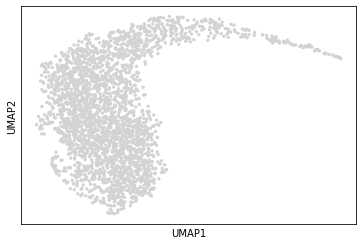

In [6]:
sc.pl.umap(data_magic)

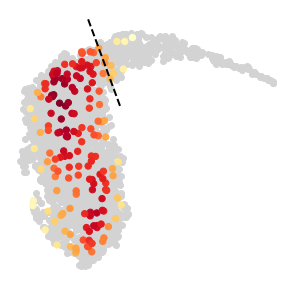

In [28]:
tmp_values_pos = data_magic[data_magic.obs['Ivl_cells']=='Sorted basal'].obs['umap_density_Ivl_cells'].values
tmp_umap_pos = data_magic[data_magic.obs['Ivl_cells']=='Sorted basal'].obsm['X_umap']
tmp_umap_neg = data_magic[data_magic.obs['Ivl_cells']!='Sorted basal'].obsm['X_umap']

fig, ax = plt.subplots(1, figsize = (5,5))
ax.scatter(x = tmp_umap_neg[:, 0], y = tmp_umap_neg[:, 1], color = 'lightgrey')
ax.scatter(x = tmp_umap_pos[:, 0], y = tmp_umap_pos[:, 1], color = [plt.cm.YlOrRd(x) for x in tmp_values_pos], s = 40)
plot_basal_suprabasal_cutoff(ax, color = 'k')
clean_axis(ax)

plt.savefig(os.path.join(fig_path, 'IFE_umap_embedding-density_Ivl-cells_scatter_cutoffLine.png'), transparent = True, bbox_inches = 'tight', dpi = 600)

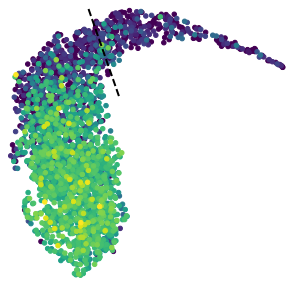

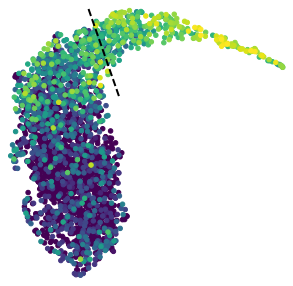

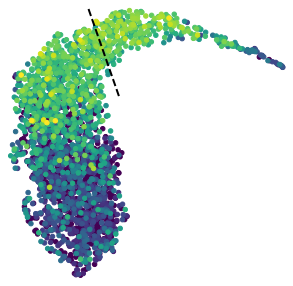

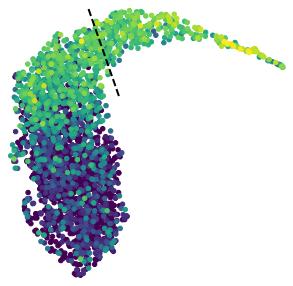

In [30]:
percentile = 99.9
add_perc = 0.2
for gene in ['Krt14','Sbsn', 'Krt10','Krtdap']:
    fig, ax = plt.subplots(figsize = (5,5))
    
    vmax = np.percentile(data_magic.raw.X[:, np.where(
        data_magic.raw.var_names == gene)[0]].flatten(), q = percentile)
    umap = data_magic.obsm['X_umap']
    expression = data_magic.raw.X[:,np.where(data_magic.raw.var_names == gene)[0]]
    
    expression = expression.flatten()
    rank = np.argsort(expression)
    expression = np.array(expression)[rank]
    umap = np.array(umap)[rank]
    
    ax.scatter(x = umap[:, 0], y = umap[:, 1], c = expression, cmap = 'viridis', s = 20, alpha = 1, vmax = vmax)
    
    ax.set_xlim([umap[:,0].min()-add_perc, umap[:,0].max()+add_perc])
    ax.set_ylim([umap[:,1].min()-add_perc, umap[:,1].max()+add_perc])
    plot_basal_suprabasal_cutoff(ax, color = 'k')
    clean_axis(ax)
    
    plt.savefig(os.path.join(fig_path, 'IFE_umap_expression_downsampled_wider_cutoffLine_{}.png'.format(gene)), transparent = True, bbox_inches = 'tight', dpi = 600)

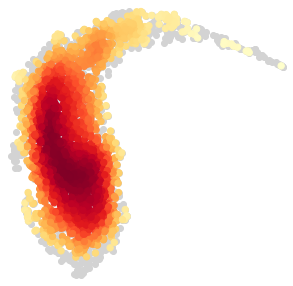

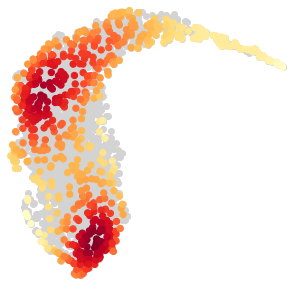

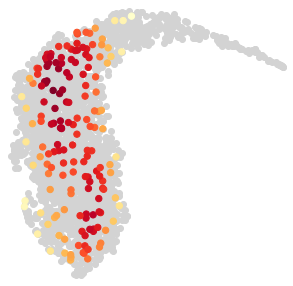

In [10]:
#ncols = 3
#nrows = 1
#fig, axes = plt.subplots(ncols = ncols, nrows = nrows, figsize = (5*ncols, 5*nrows))

add_perc = 0.2
categories = ['10x', 'C1', 'Ivl']
grouping = 'batch'
for ix, cat in enumerate(categories):
    fig, ax = plt.subplots(figsize = (5,5))
                           
    umap = data_magic.obsm['X_umap']
    
    tmp_values_pos = data_magic[data_magic.obs[grouping]==cat].obs['umap_density_{}'.format(grouping)].values
    tmp_umap_pos = data_magic[data_magic.obs[grouping]==cat].obsm['X_umap']
    
    ax.scatter(x = umap[:, 0], y = umap[:, 1], color = 'lightgrey')
    ax.scatter(x = tmp_umap_pos[:, 0], y = tmp_umap_pos[:, 1], color = [plt.cm.YlOrRd(x) for x in tmp_values_pos], s = 40)
    #ax.set_title(cat)
    
    ax.set_xlim([umap[:,0].min()-add_perc, umap[:,0].max()+add_perc])
    ax.set_ylim([umap[:,1].min()-add_perc, umap[:,1].max()+add_perc])
    
    clean_axis(ax)
    
    fig.savefig(os.path.join(fig_path, 'IFE_umap_embedding-density_batch_{}_wider.png'.format(cat)), transparent = True, bbox_inches = 'tight', dpi = 600)
#clean_subplots(ix, axes, ncols, keep_lone_xticklabels=False)
clear_output()
#fig.savefig(os.path.join(fig_path, 'IFE_umap_embedding-density_pred_cluster_wider.png'), transparent = True, bbox_inches = 'tight', dpi = 600)

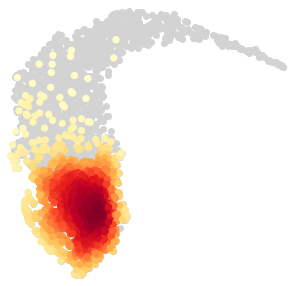

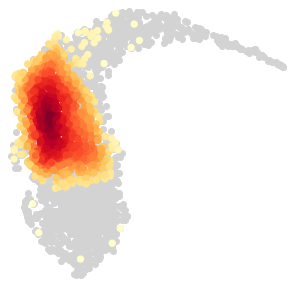

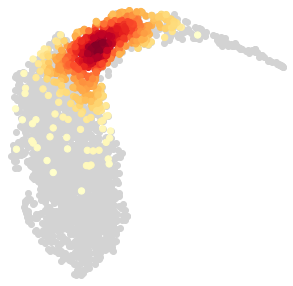

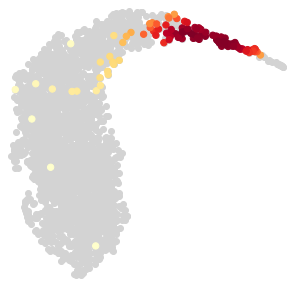

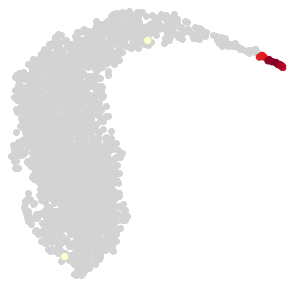

In [32]:
#ncols = 3
#nrows = 1
#fig, axes = plt.subplots(ncols = ncols, nrows = nrows, figsize = (5*ncols, 5*nrows))

add_perc = 0.2
#categories = ['10x', 'C1', 'Ivl']
grouping = 'pred_cluster_imp'
for ix, cat in enumerate([x for x in data_magic.obs[grouping].cat.categories]):
    fig, ax = plt.subplots(figsize = (5,5))
                           
    umap = data_magic.obsm['X_umap']
    
    tmp_values_pos = data_magic[data_magic.obs[grouping]==cat].obs['umap_density_{}'.format(grouping)].values
    tmp_umap_pos = data_magic[data_magic.obs[grouping]==cat].obsm['X_umap']
    
    ax.scatter(x = umap[:, 0], y = umap[:, 1], color = 'lightgrey')
    ax.scatter(x = tmp_umap_pos[:, 0], y = tmp_umap_pos[:, 1], color = [plt.cm.YlOrRd(x) for x in tmp_values_pos], s = 40)
    #ax.set_title(cat)
    
    ax.set_xlim([umap[:,0].min()-add_perc, umap[:,0].max()+add_perc])
    ax.set_ylim([umap[:,1].min()-add_perc, umap[:,1].max()+add_perc])
    
    clean_axis(ax)
    
    fig.savefig(os.path.join(fig_path, 'IFE_umap_embedding-density_{}_{}_wider.png'.format(grouping, cat)), transparent = True, bbox_inches = 'tight', dpi = 600)
#clean_subplots(ix, axes, ncols, keep_lone_xticklabels=False)
clear_output()
#fig.savefig(os.path.join(fig_path, 'IFE_umap_embedding-density_pred_cluster_wider.png'), transparent = True, bbox_inches = 'tight', dpi = 600)

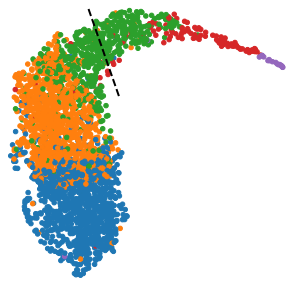

In [21]:
fig, ax = plt.subplots(figsize = (5,5))
grouping = 'pred_cluster_imp'
data_magic.uns['pred_cluster_imp_colors'] = convert_rgb_to_hex(rgb = sbn.color_palette(palette = 'tab10', n_colors = 5))
cmap = dict(zip(data_magic.obs[grouping].cat.categories, data_magic.uns['{}_colors'.format(grouping)]))

umap = data_magic.obsm['X_umap']
ax.scatter(x = umap[:, 0], y = umap[:, 1], color = [cmap[x] for x in data_magic.obs[grouping]], s = 20)

add_perc = 0.2
ax.set_xlim([umap[:,0].min()-add_perc, umap[:,0].max()+add_perc])
ax.set_ylim([umap[:,1].min()-add_perc, umap[:,1].max()+add_perc])

plot_basal_suprabasal_cutoff(ax = ax, ls = '--', color = 'black', lw = 2)
clean_axis(ax)
"""sc.pl.umap(data_magic, color = grouping, frameon = False, show = False, ax = ax, 
           legend_loc = None, title = '', size=100)"""
fig.savefig(os.path.join(fig_path, 'IFE_umap_clustering_{}_wider_cutoff_line.pdf'.format(grouping)),
            transparent = True, bbox_inches = 'tight', dpi = 600)

In [15]:
krt10_expr = data_magic.raw[:, np.where(data_magic.raw.var_names=='Krt10')[0][0]].X.flatten()

C:\Users\karlan\AppData\Local\Continuum\anaconda3\envs\scanpy\lib\site-packages\anndata\core\anndata.py:299: FutureWarning: In anndata v0.7+, arrays contained within an AnnData object will maintain their dimensionality. For example, prior to v0.7 `adata[0, 0].X` returned a scalar and `adata[0, :]` returned a 1d array, post v0.7 they will return two dimensional arrays. If you would like to get a one dimensional array from your AnnData object, consider using the `adata.obs_vector`, `adata.var_vector` methods or accessing the array directly.
  warn_flatten()


In [16]:
krt10_basal = krt10_expr[np.where(data_magic.obs['pred_cluster_imp']=='IFE B')[0]]

Text(2, 0.5, 'mean: 1.84')

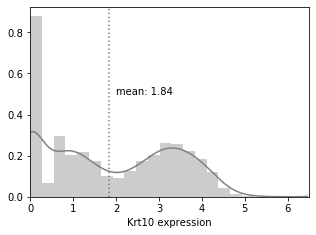

In [17]:
fig, g = plt.subplots(figsize = (5,3.5))
sbn.distplot(krt10_expr, bins = 20, ax = g, color = 'grey')
g.axvline(np.mean(krt10_expr), c = 'grey', ls = ':')
#g.axvline(np.median(krt10_expr), c = 'r')
g.set_xlim([0,6.5])
g.set_xlabel('Krt10 expression')
g.text(x = 2, y = 0.5, s = 'mean: {:.2f}'.format(np.mean(krt10_expr)))
#plt.savefig(os.path.join(fig_path, 'IFE_Krt10_expression_distribution.png'.format(gene)), transparent = True, bbox_inches = 'tight', dpi = 600)

Text(0.5, 0, 'Krt10 expression')

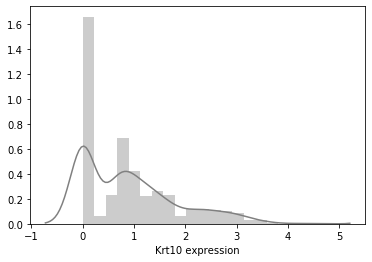

In [18]:
g = sbn.distplot(krt10_basal, bins = 20, color = 'grey')
#g.axvline(np.mean(krt10_basal), c = 'grey')
#g.axvline(np.median(krt10_expr), c = 'r')
#g.set_xlim([0,6.5])
g.set_xlabel('Krt10 expression')
#g.text(x = 2, y = 0.5, s = 'mean: {}'.format(np.mean(krt10_expr)))

In [19]:
np.percentile(krt10_basal, [50, 75, 90, 95,99])

array([0.71405062, 1.38629436, 2.30258512, 2.77258873, 3.36421178])

In [20]:
data_magic.obs['Krt10_class_mean'] = np.where(krt10_expr>np.mean(krt10_expr), 'Krt10+', 'Krt10-')

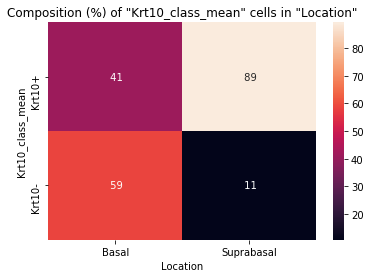

In [21]:
plot_group_composition_heatmap(data_magic.obs, groupby_name = 'Location', count_group_name='Krt10_class_mean', transpose = True)

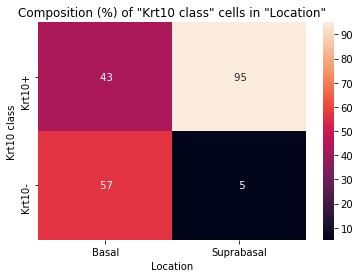

In [80]:
plot_group_composition_heatmap(data_magic.obs, groupby_name = 'Location', count_group_name='Krt10 class', transpose = True)

In [39]:
data_magic.obs.groupby(group1).count()

,10x_leiden,Basa-Suprabasal,C1_pred_cluster,G2M_score,G2M_score_separate_original,Ivl_cells,Krt10 class,Krt10_group,Krt14_group,S_score,...,umap_density_cell_identity,umap_density_clustering,umap_density_phase_c0,umap_density_phase_c0.05,umap_density_phase_c0.1,umap_density_phase_c0.2,umap_density_pred_cluster,pred_cluster_ds,pred_cluster_imp,Krt10_class_mean
Location,,,,,,,,,,,,,,,,,,,,,
Basal,2310,2310,2310,2310,635,2310,2310,2310,2310,2310,...,2310,635,635,635,635,635,2310,2310,2310,2310
Suprabasal,336,336,336,336,164,336,336,336,336,336,...,336,164,164,164,164,164,336,336,336,336


"fig.savefig(os.path.join(fig_path, 'IFE_umap_clustering_{}_wider.png'.format(grouping)),\n            transparent = True, bbox_inches = 'tight', dpi = 600)"

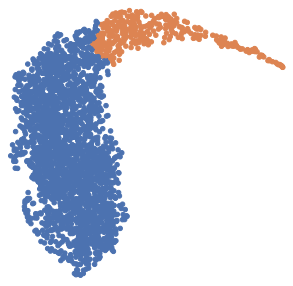

In [76]:
fig, ax = plt.subplots(figsize = (5,5))
grouping = 'Location'
cmap = dict(zip(data_magic.obs[grouping].cat.categories, data_magic.uns['{}_colors'.format(grouping)]))

umap = data_magic.obsm['X_umap']
ax.scatter(x = umap[:, 0], y = umap[:, 1], color = [cmap[x] for x in data_magic.obs[grouping]], s = 20)

add_perc = 0.2
ax.set_xlim([umap[:,0].min()-add_perc, umap[:,0].max()+add_perc])
ax.set_ylim([umap[:,1].min()-add_perc, umap[:,1].max()+add_perc])

clean_axis(ax)
"""sc.pl.umap(data_magic, color = grouping, frameon = False, show = False, ax = ax, 
           legend_loc = None, title = '', size=100)"""
"""fig.savefig(os.path.join(fig_path, 'IFE_umap_clustering_{}_wider.png'.format(grouping)),
            transparent = True, bbox_inches = 'tight', dpi = 600)"""

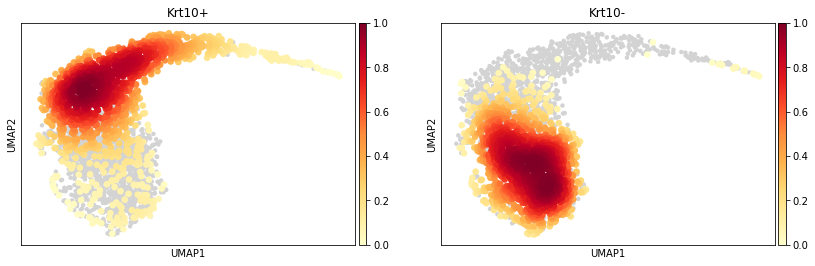

In [103]:
sc.tl.embedding_density(data_magic, groupby = grouping)
sc.pl.embedding_density(data_magic, groupby = grouping)

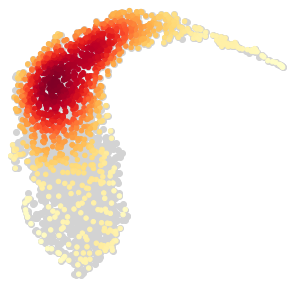

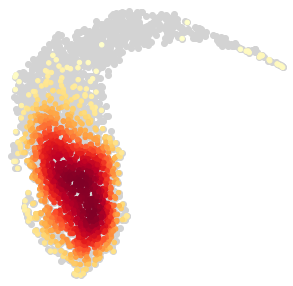

In [107]:
#ncols = 3
#nrows = 1
#fig, axes = plt.subplots(ncols = ncols, nrows = nrows, figsize = (5*ncols, 5*nrows))

add_perc = 0.2
#categories = ['10x', 'C1', 'Ivl']
grouping = 'Krt10 class'
for ix, cat in enumerate([x for x in data_magic.obs[grouping].cat.categories]):
    fig, ax = plt.subplots(figsize = (5,5))
                           
    umap = data_magic.obsm['X_umap']
    
    tmp_values_pos = data_magic[data_magic.obs[grouping]==cat].obs['umap_density_{}'.format(grouping)].values
    tmp_umap_pos = data_magic[data_magic.obs[grouping]==cat].obsm['X_umap']
    
    ax.scatter(x = umap[:, 0], y = umap[:, 1], color = 'lightgrey')
    ax.scatter(x = tmp_umap_pos[:, 0], y = tmp_umap_pos[:, 1], color = [plt.cm.YlOrRd(x) for x in tmp_values_pos], s = 20)
    #ax.set_title(cat)
    
    ax.set_xlim([umap[:,0].min()-add_perc, umap[:,0].max()+add_perc])
    ax.set_ylim([umap[:,1].min()-add_perc, umap[:,1].max()+add_perc])
    
    clean_axis(ax)
    
    fig.savefig(os.path.join(fig_path, 'IFE_umap_embedding-density_{}_{}_wider.png'.format(grouping, cat)), transparent = True, bbox_inches = 'tight', dpi = 600)
#clean_subplots(ix, axes, ncols, keep_lone_xticklabels=False)
clear_output()
#fig.savefig(os.path.join(fig_path, 'IFE_umap_embedding-density_pred_cluster_wider.png'), transparent = True, bbox_inches = 'tight', dpi = 600)

In [ ]:
    vmax = np.percentile(data_magic.raw.X[:, np.where(
        data_magic.raw.var_names == gene)[0]].flatten(), q = percentile)
    umap = data_magic.obsm['X_umap']
    tmp = data_magic[data_magic.obs['batch']=='C1']
    expression = tmp.raw.X[:,np.where(tmp.raw.var_names == gene)[0]]
    
    expression = expression.flatten()
    rank = np.argsort(expression)
    expression = np.array(expression)[rank]
    umap = np.array(umap)[rank]
    
    ax.scatter(x = umap[:, 0], y = umap[:, 1], c = expression, cmap = 'viridis', s = 20, alpha = 1, vmax = vmax)
    
    ax.set_xlim([umap[:,0].min()-add_perc, umap[:,0].max()+add_perc])
    ax.set_ylim([umap[:,1].min()-add_perc, umap[:,1].max()+add_perc])
    clean_axis(ax)

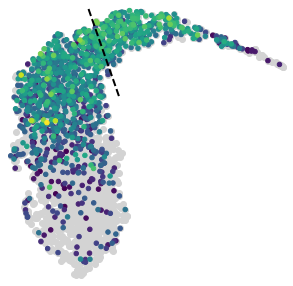

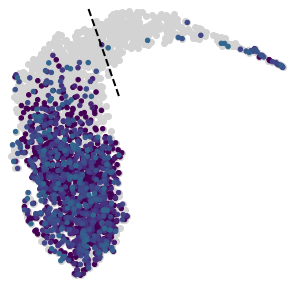

In [72]:
#ncols = 3
#nrows = 1
#fig, axes = plt.subplots(ncols = ncols, nrows = nrows, figsize = (5*ncols, 5*nrows))

add_perc = 0.2
#categories = ['10x', 'C1', 'Ivl']
grouping = 'Krt10_class_mean'
vmax = krt10_expr.max()
for ix, cat in enumerate([x for x in data_magic.obs[grouping].cat.categories]):
    fig, ax = plt.subplots(figsize = (5,5))
                           
    umap = data_magic.obsm['X_umap']
    
    tmp_pos = data_magic[data_magic.obs[grouping]==cat]
    
    tmp_values_pos = tmp_pos.raw[:, np.where(tmp_pos.raw.var_names=='Krt10')[0][0]].X.flatten()
    tmp_umap_pos = tmp_pos.obsm['X_umap']
    
    rank = np.argsort(tmp_values_pos)
    tmp_values_pos = np.array(tmp_values_pos)[rank]
    tmp_umap_pos = np.array(tmp_umap_pos)[rank]

    ax.scatter(x = umap[:, 0], y = umap[:, 1], color = 'lightgrey')
    ax.scatter(x = tmp_umap_pos[:, 0], y = tmp_umap_pos[:, 1], c = tmp_values_pos, cmap = 'viridis', s = 20, alpha = 1, vmax = vmax)
    
    
    ax.set_xlim([umap[:,0].min()-add_perc, umap[:,0].max()+add_perc])
    ax.set_ylim([umap[:,1].min()-add_perc, umap[:,1].max()+add_perc])
    
    plot_basal_suprabasal_cutoff(ax = ax, ls = '--', color = 'black', lw = 2)
    clean_axis(ax)
    
    fig.savefig(os.path.join(fig_path, 'IFE_umap_expression_{}_{}_wider.png'.format(grouping, cat)), transparent = True, bbox_inches = 'tight', dpi = 600)
#clean_subplots(ix, axes, ncols, keep_lone_xticklabels=False)
clear_output()
#fig.savefig(os.path.join(fig_path, 'IFE_umap_embedding-density_pred_cluster_wider.png'), transparent = True, bbox_inches = 'tight', dpi = 600)

In [306]:
data_magic

AnnData object with n_obs × n_vars = 2646 × 842 
    obs: '10x_leiden', 'Basa-Suprabasal', 'C1_pred_cluster', 'G2M_score', 'G2M_score_separate_original', 'Ivl_cells', 'Krt10 class', 'Krt10_group', 'Krt14_group', 'Location', 'S_score', 'S_score_separate_original', 'batch', 'cell_identity', 'clustering', 'dpt_pseudotime', 'layer', 'leiden', 'leiden_named', 'log1p_n_genes_by_counts', 'log1p_total_counts', 'log1p_total_counts_ERCC', 'log1p_total_counts_mito', 'n_genes', 'n_genes_by_counts', 'pct_counts_ERCC', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'pct_counts_in_top_50_genes', 'pct_counts_mito', 'phase', 'phase_c0', 'phase_c0.05', 'phase_c0.1', 'phase_c0.2', 'phase_separate_original', 'pred_cluster', 'pto_coords', 'pto_coords_diffmap', 'total_counts', 'total_counts_ERCC', 'total_counts_mito', 'umap_density_C1_pred_cluster', 'umap_density_Ivl_cells', 'umap_density_Krt10 class', 'umap_density_batch', 'umap_density_cell_identity', 'umap_de

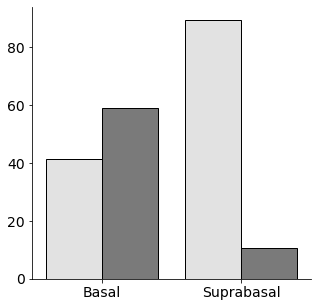

In [92]:
palette = sbn.color_palette(palette = 'Greys', n_colors = 4)

fig, ax = plt.subplots(figsize = (5,5))

df = (data_magic.obs.groupby('Location')['Krt10_class_mean'].value_counts().div(data_magic.obs.groupby('Location')['Krt10_class_mean'].count())*100).reset_index(name='Percentage')
sbn.barplot(data = df, y = 'Percentage', x = 'Location', hue = 'Krt10_class_mean', hue_order = ['Krt10+','Krt10-'], 
            palette = [palette[0], palette[-2]], ax = ax, edgecolor = 'k')
ax.set_ylabel('')
ax.set_xlabel('')
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

ax.tick_params(axis="y", labelsize=14)
ax.tick_params(axis="x", labelsize=14)

ax.legend(handles = [], frameon = False)

fig.savefig(os.path.join(fig_path, 'IFE_Barplot_Krt10_percentage_mean.pdf'.format(grouping, cat)), transparent = True, bbox_inches = 'tight', dpi = 600)

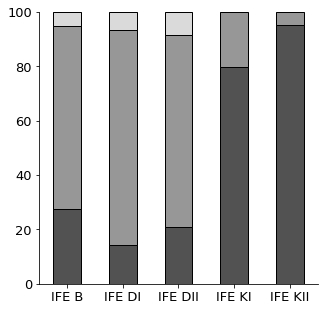

In [96]:
fig, ax = plt.subplots(figsize = (5,5))

group1 = 'pred_cluster_imp'
group2 = 'batch'

#df = (data_magic.obs.groupby(group1)[group2].value_counts().div(data_magic.obs.groupby(group1)[group2].count())*100).reset_index(name='Percentage')
"""sbn.barplot(data = df, y = 'Percentage', x = group1, hue = group2, palette = 'Greys', ax = ax, 
            hue_order = ['C1','10x','Ivl'])
"""
df = (data_magic.obs.groupby(group1)[group2].value_counts().div(data_magic.obs.groupby(group1)[group2].count())*100).reset_index(name='Percentage').reset_index().pivot(columns=group2, index=group1, values='Percentage').fillna(0)
df[['C1','10x','Ivl']].plot(kind = 'bar', stacked = True, colors = sbn.color_palette(palette = 'Greys_r', n_colors=3), ax = ax, legend = False,
                           fontsize = 13, edgecolor = 'k')

ax.set_ylabel('')
ax.set_xlabel('')
ax.set_xticklabels(labels = ax.get_xticklabels(), rotation = 0)

ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

ax.set_ylim([0,100])
fig.savefig(os.path.join(fig_path, 'IFE_Barplot_Clustering_percentage_in_Batch_stacked.pdf'), transparent = True, bbox_inches = 'tight', dpi = 600)

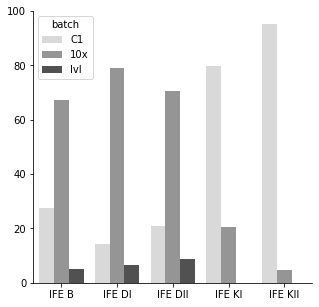

In [212]:
fig, ax = plt.subplots(figsize = (5,5))

group1 = 'pred_cluster_imp'
group2 = 'batch'

df = (data_magic.obs.groupby(group1)[group2].value_counts().div(data_magic.obs.groupby(group1)[group2].count())*100).reset_index(name='Percentage')
sbn.barplot(data = df, y = 'Percentage', x = group1, hue = group2, palette = 'Greys', ax = ax, 
            hue_order = ['C1','10x','Ivl'])

ax.set_ylabel('')
ax.set_xlabel('')
ax.set_xticklabels(labels = ax.get_xticklabels(), rotation = 0)

ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

fig.savefig(os.path.join(fig_path, 'IFE_Barplot_Clustering_percentage_in_Batch.png'), transparent = True, bbox_inches = 'tight', dpi = 600)

In [150]:
data_magic.obs['age'] = ['9w' if '9w' in name else '5w' if '5w' in name else '9w' for name in data_magic.obs_names]

... storing 'age' as categorical


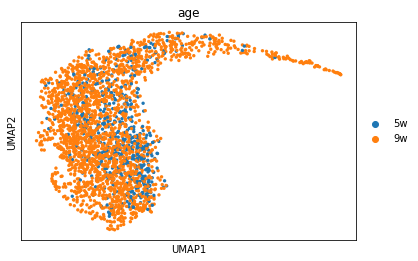

In [151]:
sc.pl.umap(data_magic, color = 'age')

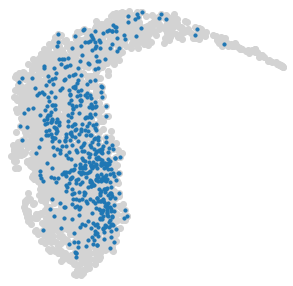

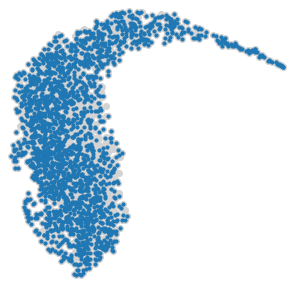

In [157]:
#ncols = 3
#nrows = 1
#fig, axes = plt.subplots(ncols = ncols, nrows = nrows, figsize = (5*ncols, 5*nrows))

add_perc = 0.2
categories = ['5w', '9w']
grouping = 'age'
for ix, cat in enumerate(categories):
    fig, ax = plt.subplots(figsize = (5,5))
                           
    umap = data_magic.obsm['X_umap']
    
    tmp_umap_pos = data_magic[data_magic.obs[grouping]==cat].obsm['X_umap']
    
    ax.scatter(x = umap[:, 0], y = umap[:, 1], color = 'lightgrey')
    ax.scatter(x = tmp_umap_pos[:, 0], y = tmp_umap_pos[:, 1], color = '#1f77b4', s = 10)
    #ax.set_title(cat)
    
    ax.set_xlim([umap[:,0].min()-add_perc, umap[:,0].max()+add_perc])
    ax.set_ylim([umap[:,1].min()-add_perc, umap[:,1].max()+add_perc])
    
    clean_axis(ax)
    
    fig.savefig(os.path.join(fig_path, 'IFE_umap_Hair_Cycle_{}_wider.png'.format(cat)), transparent = True, bbox_inches = 'tight', dpi = 600)
#clean_subplots(ix, axes, ncols, keep_lone_xticklabels=False)
clear_output()
#fig.savefig(os.path.join(fig_path, 'IFE_umap_embedding-density_pred_cluster_wider.png'), transparent = True, bbox_inches = 'tight', dpi = 600)

Line Solution is y = -2.817173155586682x + 5.325081674268546


C:\Users\karlan\AppData\Local\Continuum\anaconda3\envs\scanpy\lib\site-packages\ipykernel_launcher.py:12: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  if sys.path[0] == '':


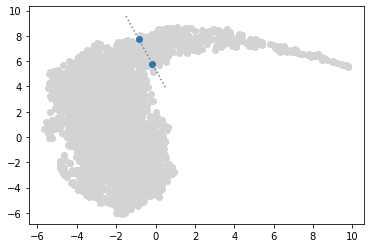

In [386]:
basal_cells = data_magic[(data_magic.obs['Location'] == 'Basal') & (data_magic.obs['Ivl_cells'] == 'Sorted basal')]
umap_coords = basal_cells[basal_cells.obs['pto_coords'].sort_values(ascending = False).index[:14]].obsm['X_umap']

x, y = zip(*data_magic.obsm['X_umap'])
plt.scatter(x, y, color = 'lightgrey')

x, y = zip(*umap_coords[[0,-1]])
plt.scatter(x,y)

x_coords, y_coords = zip(*umap_coords[[0,-1]])
A = vstack([x_coords,ones(len(x_coords))]).T
m, c = lstsq(A, y_coords)[0]
print("Line Solution is y = {m}x + {c}".format(m=m,c=c))

x0 = -1.5
x1 = 0.5

plt.plot([x0,x1], [m*x0+c, m*x1+c], ls = ':', c = 'grey')

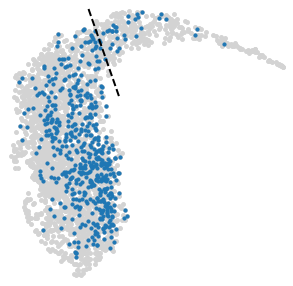

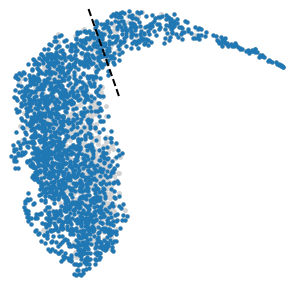

In [431]:
#ncols = 3
#nrows = 1
#fig, axes = plt.subplots(ncols = ncols, nrows = nrows, figsize = (5*ncols, 5*nrows))

add_perc = 0.2
categories = ['5w', '9w']
grouping = 'age'
for ix, cat in enumerate(categories):
    fig, ax = plt.subplots(figsize = (5,5))
                           
    umap = data_magic.obsm['X_umap']
    
    tmp_umap_pos = data_magic[data_magic.obs[grouping]==cat].obsm['X_umap']
    
    ax.scatter(x = umap[:, 0], y = umap[:, 1], color = 'lightgrey', s = 15)
    ax.scatter(x = tmp_umap_pos[:, 0], y = tmp_umap_pos[:, 1], color = '#1f77b4', s = 10)
    #ax.set_title(cat)
    
    ax.set_xlim([umap[:,0].min()-add_perc, umap[:,0].max()+add_perc])
    ax.set_ylim([umap[:,1].min()-add_perc, umap[:,1].max()+add_perc])
    
    plot_basal_suprabasal_cutoff(ax = ax, ls = '--', color = 'black', lw = 2)
    clean_axis(ax)
    
    fig.savefig(os.path.join(fig_path, 'IFE_umap_Hair_Cycle_{}_wider.png'.format(cat)), transparent = True, bbox_inches = 'tight', dpi = 600)
#clean_subplots(ix, axes, ncols, keep_lone_xticklabels=False)
clear_output()
#fig.savefig(os.path.join(fig_path, 'IFE_umap_embedding-density_pred_cluster_wider.png'), transparent = True, bbox_inches = 'tight', dpi = 600)

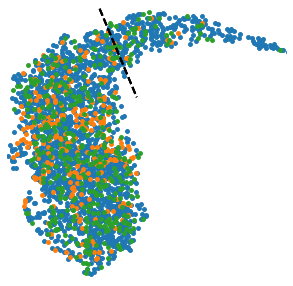

In [62]:
percentile = 99.9
add_perc = 0.3
fig, ax = plt.subplots(figsize = (5,5))
groupby = 'phase_c0.05'
for ix, phase in enumerate(data_magic.obs[groupby].cat.categories):
    umap = data_magic[data_magic.obs[groupby]==phase].obsm['X_umap']
    color = data_magic.uns['{}_colors'.format(groupby)][ix]
    
    ax.scatter(x = umap[:, 0], y = umap[:, 1], color = color, s = 15, alpha = 1)
    
    ax.set_xlim([umap[:,0].min()-add_perc, umap[:,0].max()+add_perc])
    ax.set_ylim([umap[:,1].min()-add_perc, umap[:,1].max()+add_perc])
    plot_basal_suprabasal_cutoff(ax, color = 'k')
clean_axis(ax)    
#plt.savefig(os.path.join(fig_path, 'IFE_umap_expression_downsampled_wider_cutoffLine_{}.png'.format(gene)), transparent = True, bbox_inches = 'tight', dpi = 600)

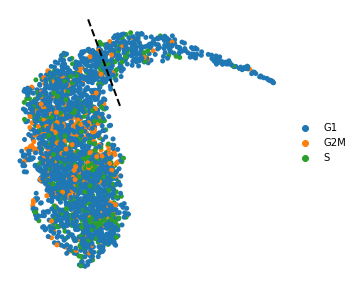

In [70]:
fig, ax = plt.subplots(1, figsize = (5,5))
#tmp = data_magic[data_magic.obs['batch']!='10x'].obsm['X_umap']
#ax.scatter(x = tmp[:, 0], y = tmp[:, 1], color = 'lightgrey')
sc.pl.umap(data_magic, color = ['phase_c0.05'], s = 100, frameon = False, ax = ax, show = False, title = '')
plot_basal_suprabasal_cutoff(ax, color = 'k')
fig.savefig(os.path.join(fig_path, 'IFE_umap_cell_cycle.png'), transparent = True, bbox_inches = 'tight')

C:\Users\karlan\AppData\Local\Continuum\anaconda3\envs\scanpy\lib\site-packages\anndata\_core\anndata.py:1172: ImplicitModificationWarning: Initializing view as actual.
  "Initializing view as actual.", ImplicitModificationWarning
Trying to set attribute `.obs` of view, copying.
... storing 'Krt10_class_mean' as categorical


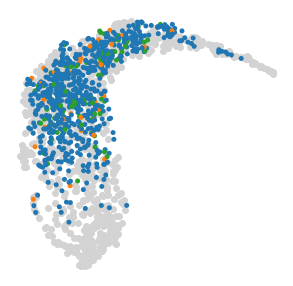

In [31]:
fig, ax = plt.subplots(1, figsize = (5,5))
tmp = data_magic[data_magic.obs['batch']!='10x'].obsm['X_umap']
ax.scatter(x = tmp[:, 0], y = tmp[:, 1], color = 'lightgrey')
sc.pl.umap(data_magic[(data_magic.obs['batch']=='10x') & (data_magic.obs['Krt10_class_mean']=='Krt10+')], 
           color = ['phase_c0.05'], s = 100, frameon = False, ax = ax, show = False, legend_loc = False, title = '')
#fig.savefig(os.path.join(fig_path, 'IFE_umap_10x_Krt10-pos_cc.pdf'), transparent = True, bbox_inches = 'tight')

Trying to set attribute `.obs` of view, copying.
... storing 'Krt10_class_mean' as categorical


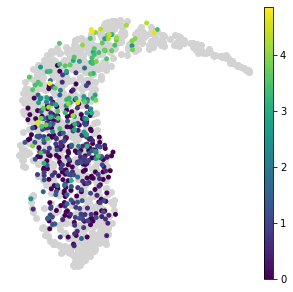

In [32]:
fig, ax = plt.subplots(1, figsize = (5,5))
tmp = data_magic[data_magic.obs['batch']!='10x'].obsm['X_umap']
ax.scatter(x = tmp[:, 0], y = tmp[:, 1], color = 'lightgrey')
sc.pl.umap(data_magic[(data_magic.obs['batch']=='10x') & (data_magic.obs['phase_c0.05'].isin(['G2M','S']))], 
           color = ['Krt10'], s = 100, frameon = False, ax = ax, show = False, title = '')
#fig.savefig(os.path.join(fig_path, 'IFE_umap_10x_Krt10_expression_in_cycling_cells.pdf'), transparent = True, bbox_inches = 'tight')

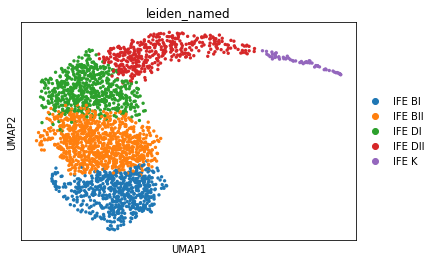

In [15]:
sc.pl.umap(data_magic, color = 'leiden_named')

In [16]:
sc.tl.rank_genes_groups(data_magic, groupby = 'leiden_named')

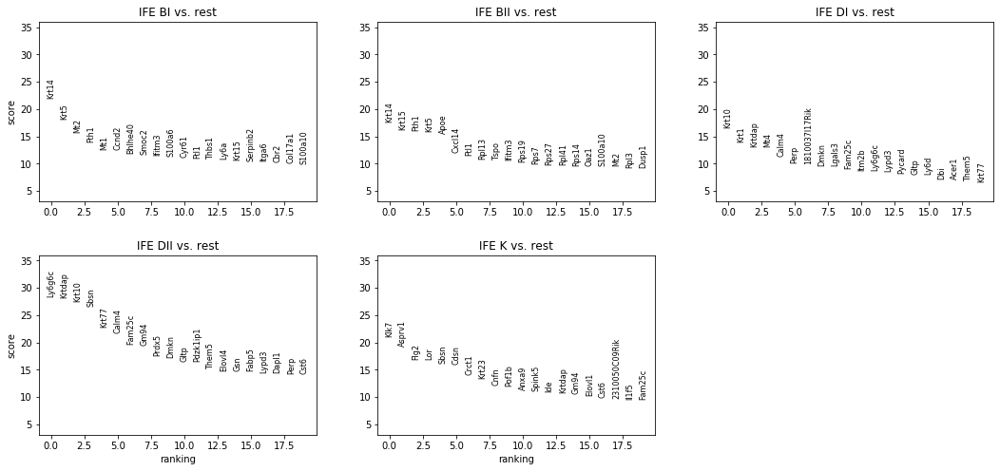

In [18]:
sc.pl.rank_genes_groups(data_magic, ncols = 3)

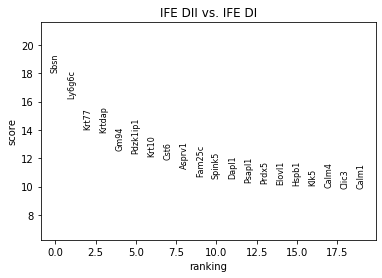

In [21]:
sc.tl.rank_genes_groups(data_magic, groupby = 'leiden_named', groups = ['IFE DII'], reference = 'IFE DI')
sc.pl.rank_genes_groups(data_magic, ncols = 3)

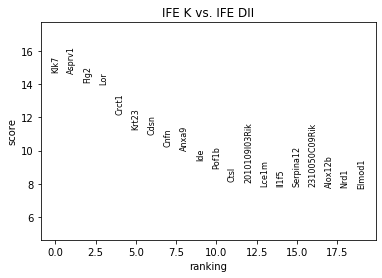

In [35]:
sc.tl.rank_genes_groups(data_magic, groupby = 'leiden_named', groups = ['IFE K'], reference = 'IFE DII')
sc.pl.rank_genes_groups(data_magic, ncols = 3)

In [24]:
data_magic

AnnData object with n_obs × n_vars = 2646 × 842 
    obs: '10x_leiden', 'Basa-Suprabasal', 'C1_pred_cluster', 'G2M_score', 'G2M_score_separate_original', 'Ivl_cells', 'Krt10 class', 'Krt10_group', 'Krt14_group', 'Location', 'S_score', 'S_score_separate_original', 'batch', 'cell_identity', 'clustering', 'dpt_pseudotime', 'layer', 'leiden', 'leiden_named', 'log1p_n_genes_by_counts', 'log1p_total_counts', 'log1p_total_counts_ERCC', 'log1p_total_counts_mito', 'n_genes', 'n_genes_by_counts', 'pct_counts_ERCC', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'pct_counts_in_top_50_genes', 'pct_counts_mito', 'phase', 'phase_c0', 'phase_c0.05', 'phase_c0.1', 'phase_c0.2', 'phase_separate_original', 'pred_cluster', 'pto_coords', 'pto_coords_diffmap', 'total_counts', 'total_counts_ERCC', 'total_counts_mito', 'umap_density_C1_pred_cluster', 'umap_density_Ivl_cells', 'umap_density_Krt10 class', 'umap_density_batch', 'umap_density_cell_identity', 'umap_de

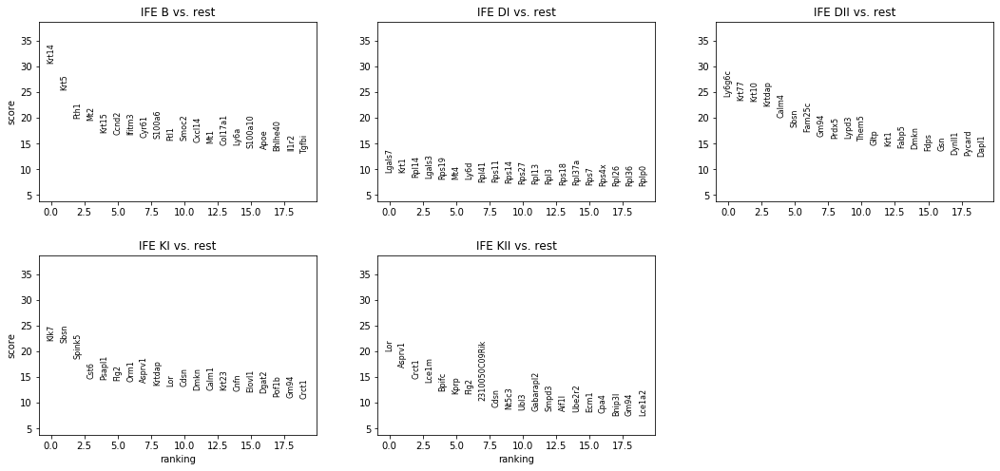

In [29]:
sc.tl.rank_genes_groups(data_magic, groupby = 'pred_cluster_imp')
sc.pl.rank_genes_groups(data_magic, ncols = 3)

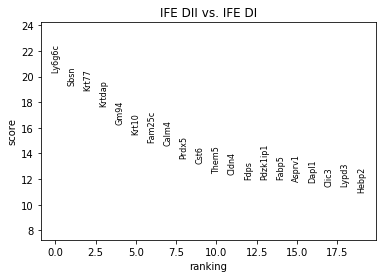

In [31]:
sc.tl.rank_genes_groups(data_magic, groupby = 'pred_cluster_imp', groups = ['IFE DII'], reference = 'IFE DI')
sc.pl.rank_genes_groups(data_magic, ncols = 3)

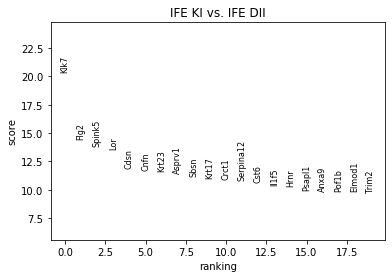

In [34]:
sc.tl.rank_genes_groups(data_magic, groupby = 'pred_cluster_imp', groups = ['IFE KI'], reference = 'IFE DII')
sc.pl.rank_genes_groups(data_magic, ncols = 3)

In [37]:
import itertools
from networkx.drawing.nx_agraph import graphviz_layout
import networkx as nx

In [51]:
data_magic.uns['iroot'] = data_magic.uns['iroot'][0]

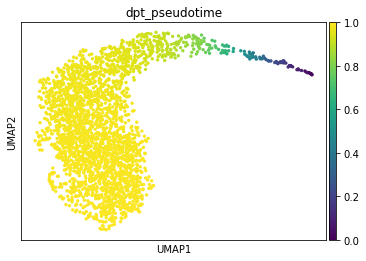

In [52]:
sc.tl.diffmap(data_magic)
sc.tl.dpt(data_magic)
sc.pl.umap(data_magic, color = 'dpt_pseudotime')

In [54]:
data_magic.obs['dpt_pseudotime'] = 1-data_magic.obs['dpt_pseudotime']

In [58]:
data_magic.obs['dpt_pseudotime_ordered'] = np.argsort(np.argsort(data_magic.obs['dpt_pseudotime']))

In [62]:
data_magic.obs['dpt_pseudotime_ordered'] = data_magic.obs['dpt_pseudotime_ordered'].div(data_magic.obs['dpt_pseudotime_ordered'].max())

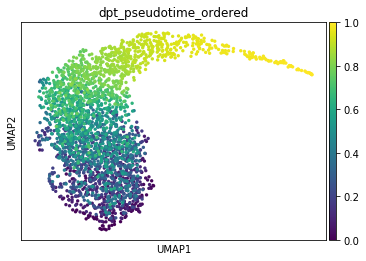

In [65]:
sc.pl.umap(data_magic, color = ['dpt_pseudotime_ordered'])

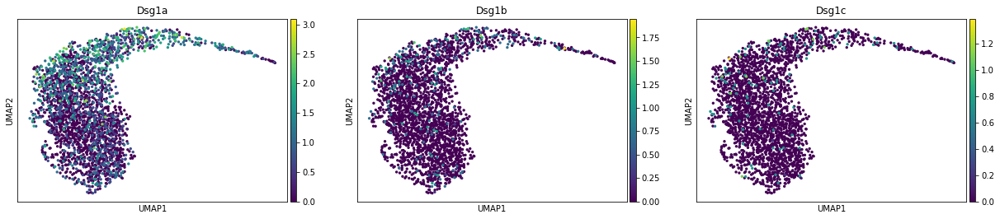

In [77]:
sc.pl.umap(data_magic, color = ['Dsg1a','Dsg1b','Dsg1c'])

In [129]:
data_magic.raw = sc.read_csv(os.path.join(path, '{}_raw_counts.csv'.format(raw_filename)))

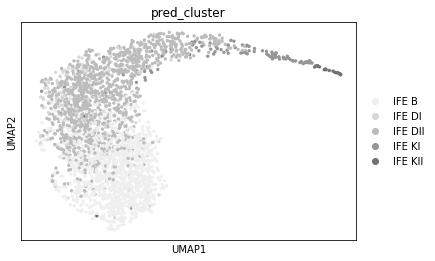

In [130]:
data_magic.uns['pred_cluster_colors'] = sbn.color_palette('Greys', n_colors=7)[:5]
data_magic.uns['pred_cluster_colors'] = convert_rgb_to_hex(adata = data_magic, color_name = 'pred_cluster')
sc.pl.umap(data_magic, color = 'pred_cluster')

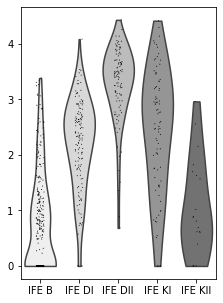

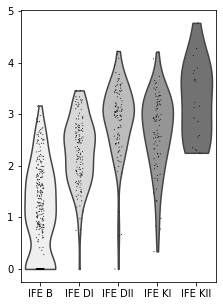

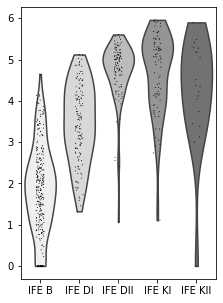

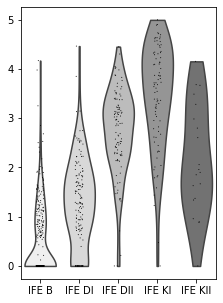

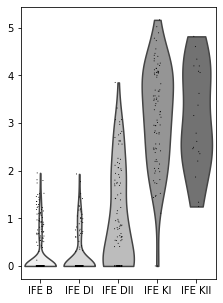

In [131]:
for gene in ['Ly6g6c','Calm4','Sbsn','Spink5','Klk7']:
    fig, ax = plt.subplots(figsize = (3.5,5))
    tmp = data_magic[data_magic.obs['batch']=='C1']
    sc.pl.violin(tmp, keys = gene, groupby = 'pred_cluster', frameon = False, ax = ax, show = False, use_raw = True)
    ax.set_xlabel('')
    ax.set_ylabel('')
    
    plt.savefig(os.path.join(fig_path, 'IFE_C1_violinplot_{}.png'.format(gene)), transparent = True, bbox_inches = 'tight', dpi = 600)

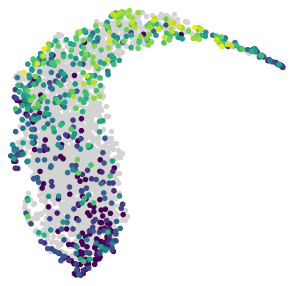

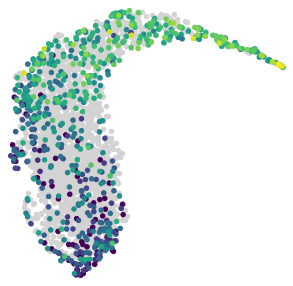

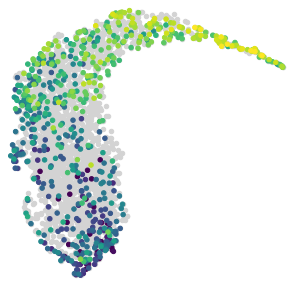

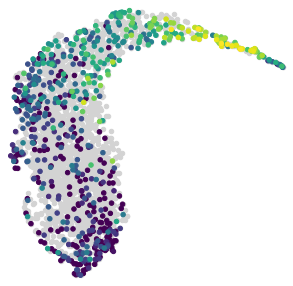

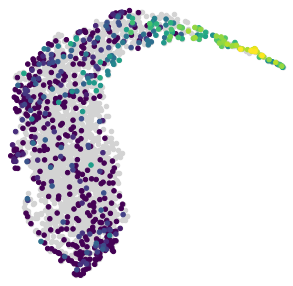

In [132]:
percentile = 99.9
add_perc = 0.2
for gene in ['Ly6g6c','Calm4','Sbsn','Spink5','Klk7']:
    fig, ax = plt.subplots(figsize = (5,5))
    
    ax.scatter(x = data_magic.obsm['X_umap'][:, 0], y = data_magic.obsm['X_umap'][:, 1], 
                   c = 'lightgrey', s = 20)
    
    vmax = np.percentile(data_magic.raw.X[:, np.where(
        data_magic.raw.var_names == gene)[0]].flatten(), q = percentile)
    umap = data_magic.obsm['X_umap']
    tmp = data_magic[data_magic.obs['batch']=='C1']
    expression = tmp.raw.X[:,np.where(tmp.raw.var_names == gene)[0]]
    
    expression = expression.flatten()
    rank = np.argsort(expression)
    expression = np.array(expression)[rank]
    umap = np.array(umap)[rank]
    
    ax.scatter(x = umap[:, 0], y = umap[:, 1], c = expression, cmap = 'viridis', s = 20, alpha = 1, vmax = vmax)
    
    ax.set_xlim([umap[:,0].min()-add_perc, umap[:,0].max()+add_perc])
    ax.set_ylim([umap[:,1].min()-add_perc, umap[:,1].max()+add_perc])
    clean_axis(ax)
    
    plt.savefig(os.path.join(fig_path, 'IFE_C1_umap_expression_wider_{}.png'.format(gene)), transparent = True, bbox_inches = 'tight', dpi = 600)

In [118]:
data_magic.raw = sc.read_csv(os.path.join(path, '{}_raw_counts.csv'.format(raw_filename_downsampled)))

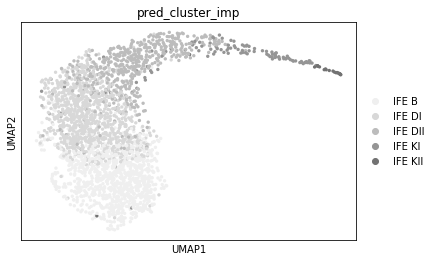

In [120]:
data_magic.uns['pred_cluster_imp_colors'] = sbn.color_palette('Greys', n_colors=7)[:5]
data_magic.uns['pred_cluster_imp_colors'] = convert_rgb_to_hex(adata = data_magic, color_name = 'pred_cluster_imp')
sc.pl.umap(data_magic, color = 'pred_cluster_imp')

In [39]:
n_colors = 8
colors = sbn.color_palette(palette = 'Greys', n_colors = n_colors)[1:]

ax = axes[ix]


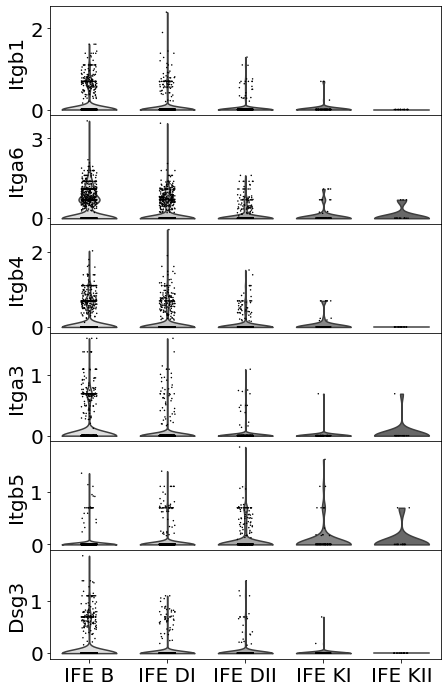

In [25]:
from matplotlib.ticker import MaxNLocator

genes = ['Itgb1','Itga6','Itgb4','Itga3','Itgb5','Dsg3']
#genes = ['Krt10', 'Krtdap', 'Sbsn', 'Krt14', 'Bhlhe40', 'Krt5', 'Mt4', 'Krt1', 'Krt77', 'Dsg1a', 'Ly6g6c', 'Calm4', 'Spink5', 'Klk7', 'Flg2', 'Lor']

fig, axes = initialize_subplots(groups_to_plot=len(genes), ncols = 1, figsize_multiplier=(7,2), gridspec_kw= {'hspace':0})
for ix, gene in enumerate(genes):
    ax = axes[ix]
    sc.pl.violin(data_magic, keys = gene, groupby = 'pred_cluster_imp', frameon = False, ax = ax, show = False, use_raw = True, palette = colors, 
                 size = 1.5, width = 0.7)
    ax.set_xlabel('')
    if ix != len(genes)-1:
        ax.set_xticks([])
    #yticks = ax.get_yticks()
    
    ax.yaxis.set_major_locator(MaxNLocator(integer=True, nbins = 2))
    
    ax.tick_params(axis="y", labelsize=20)
    ax.tick_params(axis="x", labelsize=20)
    ax.set_ylabel(gene, fontdict = {'size':20})

#plt.savefig(os.path.join(fig_path, 'Stacked_violin_gene_expression.pdf'), transparent = True, bbox_inches = 'tight', dpi = 1000)

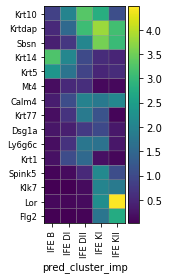

GridSpec(2, 3, height_ratios=[0, 3.0], width_ratios=[1.5, 0, 0.2])

In [186]:
sc.pl.matrixplot(data_magic, genes, groupby = 'pred_cluster_imp', swap_axes = True)

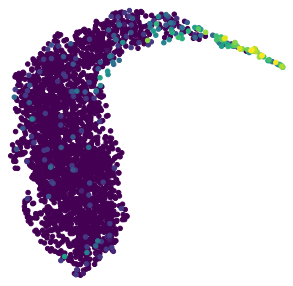

In [203]:
percentile = 99.9
add_perc = 0.2
genes = ['Flg2']
for gene in genes:
    fig, ax = plt.subplots(figsize = (5,5))
    
    vmax = np.percentile(data_magic.raw.X[:, np.where(
        data_magic.raw.var_names == gene)[0]].flatten(), q = percentile)
    umap = data_magic.obsm['X_umap']
    expression = data_magic.raw.X[:,np.where(data_magic.raw.var_names == gene)[0]]
    
    expression = expression.flatten()
    rank = np.argsort(expression)
    expression = np.array(expression)[rank]
    umap = np.array(umap)[rank]
    
    ax.scatter(x = umap[:, 0], y = umap[:, 1], c = expression, cmap = 'viridis', s = 20, alpha = 1, vmax = vmax)
    
    ax.set_xlim([umap[:,0].min()-add_perc, umap[:,0].max()+add_perc])
    ax.set_ylim([umap[:,1].min()-add_perc, umap[:,1].max()+add_perc])
    clean_axis(ax)
    
    plt.savefig(os.path.join(fig_path, 'IFE_umap_expression_downsampled__wider{}.png'.format(gene)), transparent = True, bbox_inches = 'tight', dpi = 600)

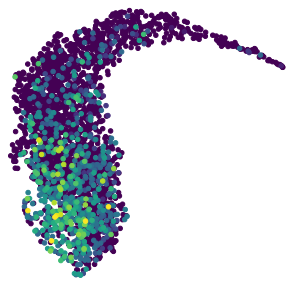

In [210]:
percentile = 99.9
add_perc = 0.2
for gene in [x for x in ['Bhlhe40'] if x in data_magic.raw.var_names]:
    fig, ax = plt.subplots(figsize = (5,5))
    
    vmax = np.percentile(data_magic.raw.X[:, np.where(
        data_magic.raw.var_names == gene)[0]].flatten(), q = percentile)
    umap = data_magic.obsm['X_umap']
    expression = data_magic.raw.X[:,np.where(data_magic.raw.var_names == gene)[0]]
    
    expression = expression.flatten()
    rank = np.argsort(expression)
    expression = np.array(expression)[rank]
    umap = np.array(umap)[rank]
    
    ax.scatter(x = umap[:, 0], y = umap[:, 1], c = expression, cmap = 'viridis', s = 20, alpha = 1, vmax = vmax)
    
    #ax.set_title(gene)
    ax.set_xlim([umap[:,0].min()-add_perc, umap[:,0].max()+add_perc])
    ax.set_ylim([umap[:,1].min()-add_perc, umap[:,1].max()+add_perc])
    clean_axis(ax)
    
    plt.savefig(os.path.join(fig_path, 'IFE_umap_expression_downsampled__wider{}.png'.format(gene)), transparent = True, bbox_inches = 'tight', dpi = 600)

In [ ]:
percentile = 99.9
add_perc = 0.2
for gene in ['Sbsn']:
    fig, ax = plt.subplots(figsize = (5,5))
    
    vmax = np.percentile(data_magic.raw.X[:, np.where(
        data_magic.raw.var_names == gene)[0]].flatten(), q = percentile)
    umap = data_magic.obsm['X_umap']
    expression = data_magic.raw.X[:,np.where(data_magic.raw.var_names == gene)[0]]
    
    expression = expression.flatten()
    rank = np.argsort(expression)
    expression = np.array(expression)[rank]
    umap = np.array(umap)[rank]
    
    ax.scatter(x = umap[:, 0], y = umap[:, 1], c = expression, cmap = 'viridis', s = 20, alpha = 1, vmax = vmax)
    
    ax.set_xlim([umap[:,0].min()-add_perc, umap[:,0].max()+add_perc])
    ax.set_ylim([umap[:,1].min()-add_perc, umap[:,1].max()+add_perc])
    clean_axis(ax)
    
    plt.savefig(os.path.join(fig_path, 'IFE_umap_expression_downsampled__wider{}.png'.format(gene)), transparent = True, bbox_inches = 'tight', dpi = 600)

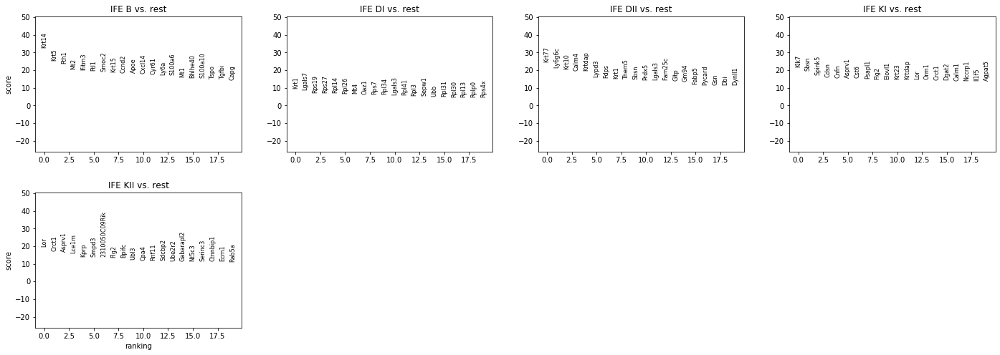

In [165]:
sc.tl.rank_genes_groups(data_magic, groupby = 'pred_cluster_imp', n_genes = len(data_magic.raw.var_names))
sc.pl.rank_genes_groups(data_magic)

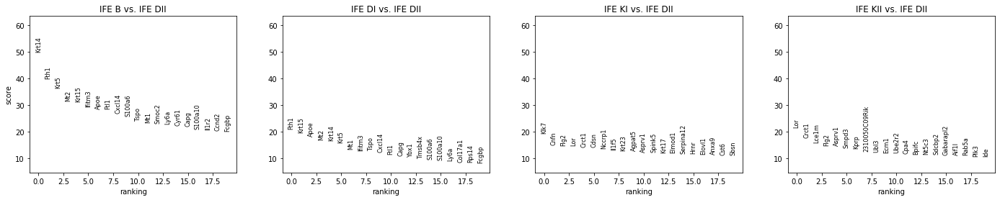

In [155]:
sc.tl.rank_genes_groups(data_magic, groupby = 'pred_cluster_imp', groups = 'all', reference = 'IFE DII')
sc.pl.rank_genes_groups(data_magic)

categories: IFE B, IFE DI, IFE DII, etc.
var_group_labels: IFE B, IFE DI, IFE KI, etc.


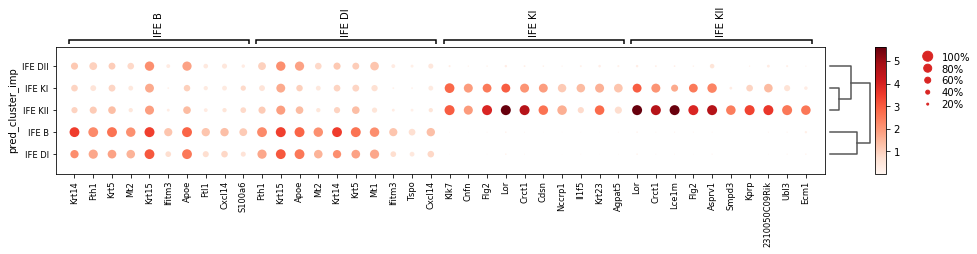

In [156]:
sc.pl.rank_genes_groups_dotplot(data_magic)

categories: IFE B, IFE DI, IFE DII, etc.
var_group_labels: IFE B, IFE DI, IFE KI, etc.


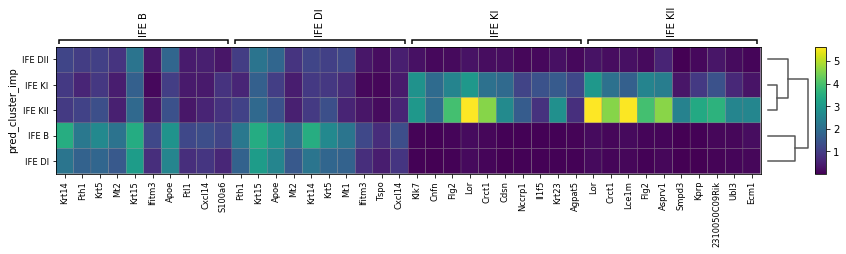

In [158]:
sc.pl.rank_genes_groups_matrixplot(data_magic)

In [199]:
tmp = sc.get.rank_genes_groups_df(data_magic, 'IFE DII')

In [50]:
from adjustText import adjust_text

In [ ]:
tmp = sc.get.rank_genes_groups_df(data_magic, 'IFE DII')
tmp['pvals_adj'] = -np.log10(tmp['pvals_adj'])
#tmp['logfoldchanges'] = np.log2(tmp['logfoldchanges'])
tmp['scores'] = abs(tmp['scores'])

500

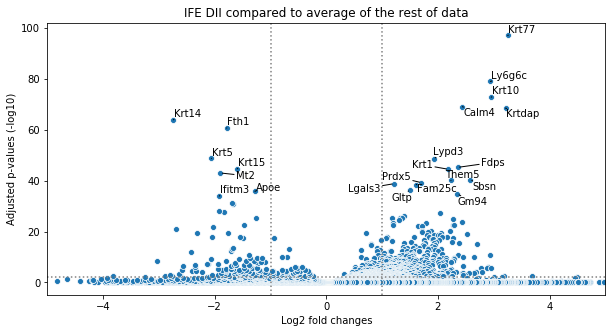

In [263]:
fig, ax = plt.subplots(1, figsize = (10,5))

sbn.scatterplot(data = tmp, x = 'logfoldchanges', y = 'pvals_adj', ax = ax)
"""g.set_yscale('log')
g.set_ylim([0,1])"""
ax.axvline(1, c = 'grey', ls = ':')
ax.axvline(-1, c = 'grey', ls = ':')
ax.axhline(2, c = 'grey', ls = ':')
ax.set_xlim([-5,5])
ax.set_ylabel('Adjusted p-values (-log10)')
ax.set_xlabel('Log2 fold changes')
ax.set_title('IFE DII compared to average of the rest of data')

texts = [ax.text(x = x, y = y, s = s, fontsize = 10) for x, y, s, score in tmp[['logfoldchanges','pvals_adj','names','scores']].values if score>13]
#adjust_text(texts, x = tmp['logfoldchanges'], y = tmp['pvals_adj'], arrowprops=dict(arrowstyle="-", color='k', lw=1))
adjust_text(texts, arrowprops=dict(arrowstyle="-", color='k', lw=1))


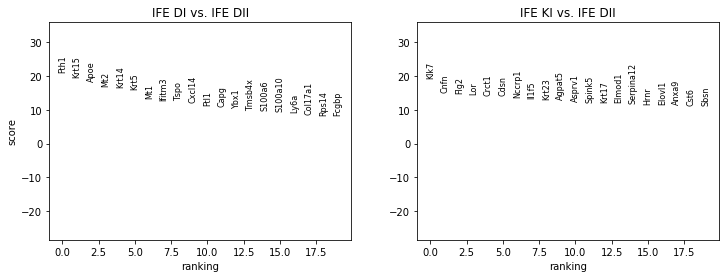

In [268]:
sc.tl.rank_genes_groups(data_magic, groupby = 'pred_cluster_imp', groups = ['IFE DI','IFE KI'], reference = 'IFE DII', n_genes = len(data_magic.raw.var_names))
sc.pl.rank_genes_groups(data_magic)

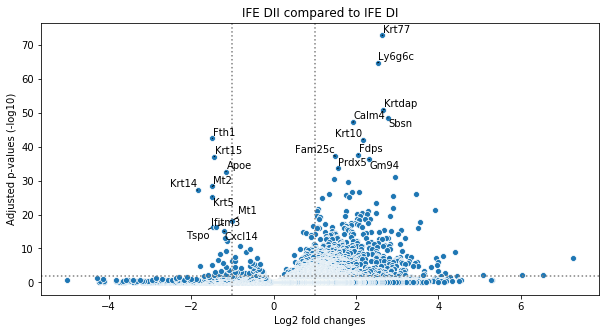

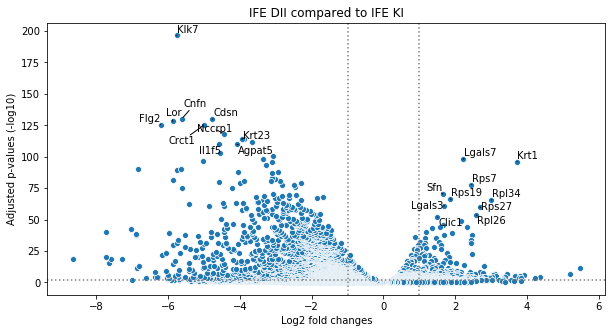

In [287]:
#fig, axes = initialize_subplots(groups_to_plot=2, ncols = 2, figsize_multiplier=(10,5))

for ix, group in enumerate(['IFE DI','IFE KI']):
    sc.tl.rank_genes_groups(data_magic, groupby = 'pred_cluster_imp', groups = ['IFE DII'], reference = group, n_genes = len(data_magic.raw.var_names))
    fig, ax = plt.subplots(1, figsize = (10,5))
    
    tmp = sc.get.rank_genes_groups_df(data_magic, 'IFE DII')
    tmp['pvals_adj'] = -np.log10(tmp['pvals_adj'])
    tmp['scores'] = abs(tmp['scores'])
    tmp = tmp.loc[abs(tmp['logfoldchanges'])<10]
    
    sbn.scatterplot(data = tmp, x = 'logfoldchanges', y = 'pvals_adj', ax = ax)
    ax.axvline(1, c = 'grey', ls = ':')
    ax.axvline(-1, c = 'grey', ls = ':')
    ax.axhline(2, c = 'grey', ls = ':')
    #ax.set_xlim([-5,5])
    ax.set_ylabel('Adjusted p-values (-log10)')
    ax.set_xlabel('Log2 fold changes')
    ax.set_title('IFE DII compared to {}'.format(group))
    
    texts = [ax.text(x = x, y = y, s = s, fontsize = 10) for x, y, s in tmp.loc[tmp['logfoldchanges']>0].sort_values(by = 'scores', ascending = False)[['logfoldchanges','pvals_adj','names']].iloc[:10].values]
    texts.extend([ax.text(x = x, y = y, s = s, fontsize = 10) for x, y, s in tmp.loc[tmp['logfoldchanges']<0].sort_values(by = 'scores', ascending = False)[['logfoldchanges','pvals_adj','names']].iloc[:10].values])
    #adjust_text(texts, x = tmp['logfoldchanges'], y = tmp['pvals_adj'], arrowprops=dict(arrowstyle="-", color='k', lw=1))
    adjust_text(texts, arrowprops=dict(arrowstyle="-", color='k', lw=1))


In [293]:
sc.tl.rank_genes_groups(data_magic, groupby = 'pred_cluster_imp', groups = ['IFE DII'], reference = 'IFE KI', n_genes = len(data_magic.raw.var_names))
tmp = sc.get.rank_genes_groups_df(data_magic, 'IFE DII')
tmp['pvals_adj'] = -np.log10(tmp['pvals_adj'])
#tmp['scores'] = abs(tmp['scores'])
tmp = tmp.loc[abs(tmp['logfoldchanges'])<10]
DII_vs_KI = tmp.copy()

In [311]:
DII_vs_KI_pos_genes = DII_vs_KI.sort_values(by = 'scores', ascending = False)['names'].iloc[:100].values
DII_vs_KI_neg_genes = DII_vs_KI.sort_values(by = 'scores', ascending = True)['names'].iloc[:100].values

In [315]:
sc.tl.rank_genes_groups(data_magic, groupby = 'pred_cluster_imp', groups = ['IFE DII'], reference = 'IFE DI', n_genes = len(data_magic.raw.var_names))
tmp = sc.get.rank_genes_groups_df(data_magic, 'IFE DII')
tmp['pvals_adj'] = -np.log10(tmp['pvals_adj'])
#tmp['scores'] = abs(tmp['scores'])
tmp = tmp.loc[abs(tmp['logfoldchanges'])<10]
DII_vs_KI = tmp.copy()

In [316]:
DII_vs_DI_pos_genes = DII_vs_KI.sort_values(by = 'scores', ascending = False)['names'].iloc[:100].values
DII_vs_DI_neg_genes = DII_vs_KI.sort_values(by = 'scores', ascending = True)['names'].iloc[:100].values

"plt.savefig(os.path.join(path_figures, figname), \n            format = 'pdf', \n            transparent = True, \n            bbox_inches = 'tight', \n            pad_inches = 0, \n            rasterized = True)"

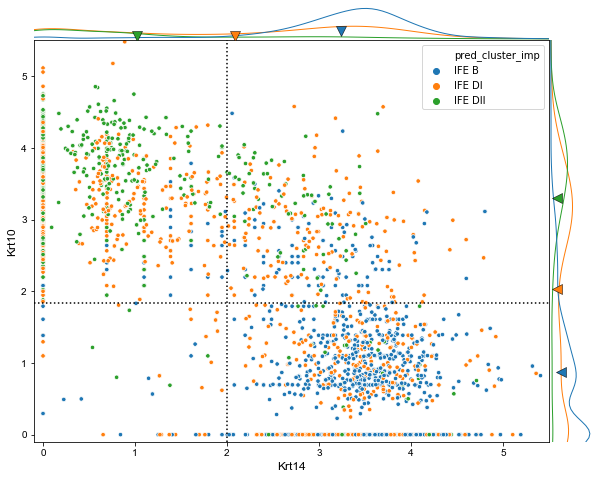

In [150]:
# Specify parameters
statistic = 'pred_cluster_imp'
xn = 'Krt14'
yn = 'Krt10'

tmp = data_magic[data_magic.obs['pred_cluster_imp'].isin(['IFE B','IFE DI','IFE DII'])]
df = pd.DataFrame(tmp.obs[statistic])
df[xn] = tmp.raw.X[:, np.where(tmp.raw.var_names==xn)[0][0]]
df[yn] = tmp.raw.X[:, np.where(tmp.raw.var_names==yn)[0][0]]

hue = 'pred_cluster_imp'
style = None
xlim = [-0.1,5.5]
ylim = [-0.1,5.5]

# Initialize figure and gs
fig, gs = plot_scatter_hist_initialize_gs(nrows = 2, ncols = 2, ratio = 12, figsize = (10,8), wspace = 0, hspace = 0)
#c_list = sbn.color_palette(n_colors=len(set(df[statistic])))
#c_list = list(cmap_stage.values())[::-1]
#c_list = sbn.color_palette(n_colors=4)[1:4:2][::-1]
c_list = {c: sbn.color_palette(palette = 'tab10', n_colors = 5)[ix] for ix, c in enumerate(tmp.obs[statistic].cat.categories)}

type_array = [df[df[statistic]==stat] for stat in set(df[statistic])]

bins = 10
alpha = 0.5
s = 20

# Define scatterplot gs axes
ax_g = plt.subplot(gs[1,0])
scatterplots = [ax_g]

# Plot scatterplots
g = sbn.scatterplot(data = df, x=xn, y=yn, hue = hue, s = s, ax = ax_g, legend = 'brief', style = style)

# Modify axes, plot trendline
for ix, tmp_df in enumerate(type_array):
    for ax_ix, ax in enumerate(scatterplots):
        """plot_trendline_scatter_hist(df = tmp_df, x = xn, y = yn, ax = ax, 
                                    color = c_list[list(set(tmp_df[hue]))[0]],plot_text = False,
                                    statistic = statistic, plot_equation=False, text_offset = 0.01)"""
        hide_y = False if ax_ix==0 else True
        plot_scatter_hist_set_axes(ax, xlabel = '', ylabel = '',
                                   xlim = xlim, ylim = ylim, hide_y = hide_y)

g.set_ylabel(yn)
g.set_xlabel(xn)

# Set titles

#Specify legends
#g_dcn.legend(title='Age', labels = ['p33','p63'])
#g.legend('',frameon = False)

# Plot side histograms
plot_hist_side(type_array, statistic=xn, lim = xlim, axes = gs[0,0], c_list = [c_list[stat] for stat in set(df[hue])], plot_axis = 'x', 
               hist_range = 100, bins = bins, xlim = xlim, ylim = ylim)

plot_hist_side(type_array, statistic=yn, lim = ylim, axes = gs[1, 1], c_list = [c_list[stat] for stat in set(df[hue])], plot_axis = 'y', 
               hist_range = 100, bins = bins, xlim = xlim, ylim = ylim)

ax_g.axhline(1.84, c = 'k', ls = ':')
ax_g.axvline(2, c = 'k', ls = ':')

clear_output()
figname = 'Anagen10x_images_Sparc_Dcn_HF-compartment_scatterplots_normalized_stat-tests_v3_lighter.pdf'
"""plt.savefig(os.path.join(path_figures, figname), 
            format = 'pdf', 
            transparent = True, 
            bbox_inches = 'tight', 
            pad_inches = 0, 
            rasterized = True)"""

In [138]:
for col, cat in enumerate([x for x in data_magic.obs[grouping].cat.categories]):
        ax = axes[row, col]
        umap = data_magic.obsm['X_umap']

        tmp_pos = data_magic[data_magic.obs[grouping]==cat]
        tmp_neg = data_magic[data_magic.obs[grouping]!=cat]

,Krt10,Krt14
Krt10,1.000000,-0.740145
Krt14,-0.740145,1.000000


In [143]:
def plot_hist_side(type_array, statistic, lim, axes, c_list, plot_axis, hist_range = 1000, bins = 15, zorder = 3,
                   marker_s = 100, marker_lw = 0.5, marker_edge_color = 'k', marker_offset = 0.25, hist_lw = 1, xlim = [0,1.1], ylim = [0,1.61]):
    x_range = [lim[0],lim[1], hist_range]
    if type(axes)!=list:
        axes = [axes]
    for ix, tmp_df in enumerate(type_array): 
        try:
            array = tmp_df[statistic]
            xx, kde = get_kde_with_total_weight(array, x_range=x_range, bins = bins)
            col = c_list[ix]
        except:
            continue
        for ax_tmp in axes:
            ax = plt.subplot(ax_tmp)
            if plot_axis == 'x':
                ax.plot(xx,kde, c = c_list[ix], alpha = 1, lw = hist_lw)
                ax.scatter(np.mean(array), marker_offset*ax.get_ylim()[1], marker = "v", color = col, s = marker_s, 
                           edgecolors=marker_edge_color, zorder = zorder, linewidths = marker_lw)
                ax.set_xlim(xlim)
            elif plot_axis == 'y':
                ax.plot(kde, xx, c = c_list[ix], alpha = 1, lw = hist_lw)
                ax.scatter(marker_offset*ax.get_xlim()[1], np.mean(array), marker = "<", color = col, s = marker_s, 
                           edgecolors=marker_edge_color, zorder = zorder, linewidths = marker_lw)
                ax.set_ylim(ylim)
            ax.axis('off')

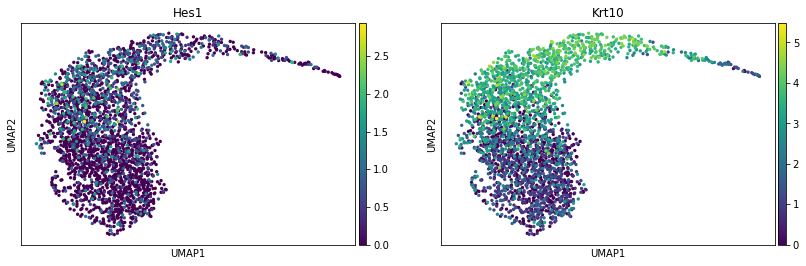

In [54]:
sc.pl.umap(data_magic, color = ['Hes1', 'Krt10'])

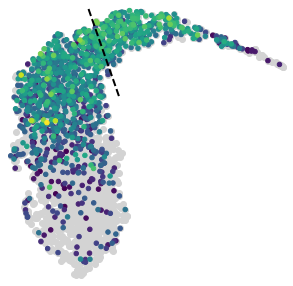

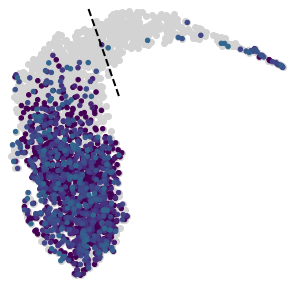

In [55]:
#ncols = 3
#nrows = 1
#fig, axes = plt.subplots(ncols = ncols, nrows = nrows, figsize = (5*ncols, 5*nrows))

add_perc = 0.2
#categories = ['10x', 'C1', 'Ivl']
grouping = 'Krt10_class_mean'
vmax = krt10_expr.max()
for ix, cat in enumerate([x for x in data_magic.obs[grouping].cat.categories]):
    fig, ax = plt.subplots(figsize = (5,5))
                           
    umap = data_magic.obsm['X_umap']
    
    tmp_pos = data_magic[data_magic.obs[grouping]==cat]
    
    tmp_values_pos = tmp_pos.raw[:, np.where(tmp_pos.raw.var_names=='Krt10')[0][0]].X.flatten()
    tmp_umap_pos = tmp_pos.obsm['X_umap']
    
    rank = np.argsort(tmp_values_pos)
    tmp_values_pos = np.array(tmp_values_pos)[rank]
    tmp_umap_pos = np.array(tmp_umap_pos)[rank]

    ax.scatter(x = umap[:, 0], y = umap[:, 1], color = 'lightgrey')
    ax.scatter(x = tmp_umap_pos[:, 0], y = tmp_umap_pos[:, 1], c = tmp_values_pos, cmap = 'viridis', s = 20, alpha = 1, vmax = vmax)
    
    
    ax.set_xlim([umap[:,0].min()-add_perc, umap[:,0].max()+add_perc])
    ax.set_ylim([umap[:,1].min()-add_perc, umap[:,1].max()+add_perc])
    
    plot_basal_suprabasal_cutoff(ax = ax, ls = '--', color = 'black', lw = 2)
    clean_axis(ax)
    
    #fig.savefig(os.path.join(fig_path, 'IFE_umap_expression_{}_{}_wider.png'.format(grouping, cat)), transparent = True, bbox_inches = 'tight', dpi = 600)
#clean_subplots(ix, axes, ncols, keep_lone_xticklabels=False)
clear_output()
#fig.savefig(os.path.join(fig_path, 'IFE_umap_embedding-density_pred_cluster_wider.png'), transparent = True, bbox_inches = 'tight', dpi = 600)

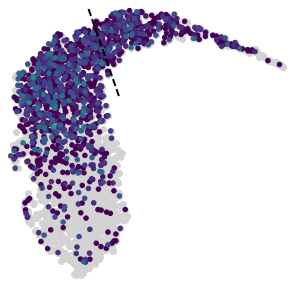

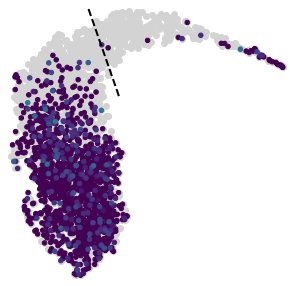

In [56]:
#ncols = 3
#nrows = 1
#fig, axes = plt.subplots(ncols = ncols, nrows = nrows, figsize = (5*ncols, 5*nrows))

add_perc = 0.2
#categories = ['10x', 'C1', 'Ivl']
grouping = 'Krt10_class_mean'
vmax = krt10_expr.max()
for ix, cat in enumerate([x for x in data_magic.obs[grouping].cat.categories]):
    fig, ax = plt.subplots(figsize = (5,5))
                           
    umap = data_magic.obsm['X_umap']
    
    tmp_pos = data_magic[data_magic.obs[grouping]==cat]
    
    tmp_values_pos = tmp_pos.raw[:, np.where(tmp_pos.raw.var_names=='Hes1')[0][0]].X.flatten()
    tmp_umap_pos = tmp_pos.obsm['X_umap']
    
    rank = np.argsort(tmp_values_pos)
    tmp_values_pos = np.array(tmp_values_pos)[rank]
    tmp_umap_pos = np.array(tmp_umap_pos)[rank]

    ax.scatter(x = umap[:, 0], y = umap[:, 1], color = 'lightgrey')
    ax.scatter(x = tmp_umap_pos[:, 0], y = tmp_umap_pos[:, 1], c = tmp_values_pos, cmap = 'viridis', s = 20, alpha = 1, vmax = vmax)
    
    
    ax.set_xlim([umap[:,0].min()-add_perc, umap[:,0].max()+add_perc])
    ax.set_ylim([umap[:,1].min()-add_perc, umap[:,1].max()+add_perc])
    
    plot_basal_suprabasal_cutoff(ax = ax, ls = '--', color = 'black', lw = 2)
    clean_axis(ax)
    
    #fig.savefig(os.path.join(fig_path, 'IFE_umap_expression_{}_{}_wider.png'.format(grouping, cat)), transparent = True, bbox_inches = 'tight', dpi = 600)
#clean_subplots(ix, axes, ncols, keep_lone_xticklabels=False)
clear_output()
#fig.savefig(os.path.join(fig_path, 'IFE_umap_embedding-density_pred_cluster_wider.png'), transparent = True, bbox_inches = 'tight', dpi = 600)

# Checkpoint 6

In [3]:
fig_path = '{}/Users/karlan/Google Drive/MKA/Papers/Greco/Katie/Figure_output'.format(root)
path = '{}/Users/karlan/Google Drive/MKA/Epidermal stem cells at the point of no return/Sequencing results/Combined_With_Joost_IFE/'.format(root)
filename = '20200918_ingest_combined_imputed_cc-regressed'
raw_filename = '20200408_ingest_combined_imputed_cc-regressed'
raw_filename_downsampled = '20200415_ingest_combined_imputed_cc-regressed_downscaled'

sc.settings.figdir = fig_path

data_magic = sc.read_loom(os.path.join(path, '{}.loom'.format(filename)))

data_magic.raw = sc.read_csv(os.path.join(path, '{}_raw_counts.csv'.format(raw_filename_downsampled)))

with open(os.path.join(path, '{}_MST.pickle'.format(raw_filename)), 'rb') as file:
    MST = pickle.load(file)
    
with open(os.path.join(path, '{}_uns.pickle'.format(filename)), 'rb') as file:
    data_magic.uns = pickle.load(file)

C:\Users\karlan\AppData\Local\Continuum\anaconda3\envs\scanpy\lib\site-packages\loompy\loom_validator.py:48: H5pyDeprecationWarning: The default file mode will change to 'r' (read-only) in h5py 3.0. To suppress this warning, pass the mode you need to h5py.File(), or set the global default h5.get_config().default_file_mode, or set the environment variable H5PY_DEFAULT_READONLY=1. Available modes are: 'r', 'r+', 'w', 'w-'/'x', 'a'. See the docs for details.
  with h5py.File(path) as f:


# Look for genes correlated with K10 expression

In [31]:
expression_df = pd.DataFrame(data = data_magic.raw.X, columns = data_magic.raw.var_names, index = data_magic.raw.obs_names)

In [34]:
k10_corr = expression_df.corrwith(expression_df['Krt10'], axis = 0)

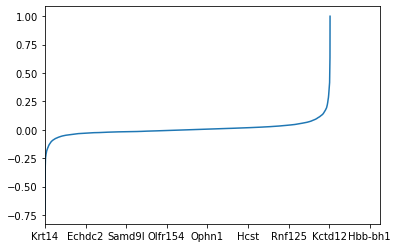

In [35]:
k10_corr.sort_values().plot()

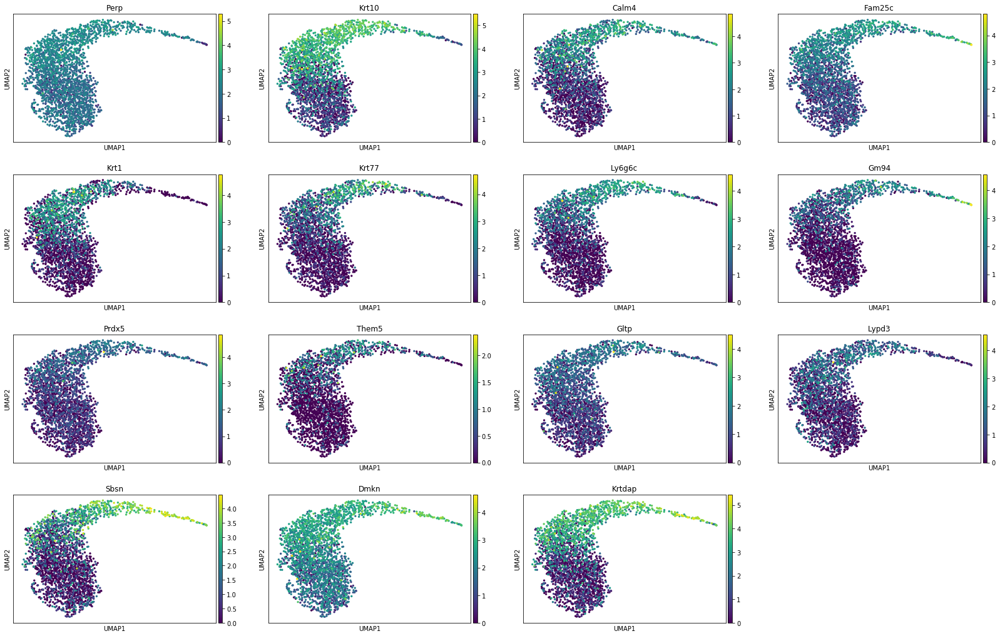

In [40]:
genes = k10_corr[k10_corr > 0.5].index
sc.pl.umap(data_magic, color = genes)

"plt.savefig(os.path.join(path_figures, figname), \n            format = 'pdf', \n            transparent = True, \n            bbox_inches = 'tight', \n            pad_inches = 0, \n            rasterized = True)"

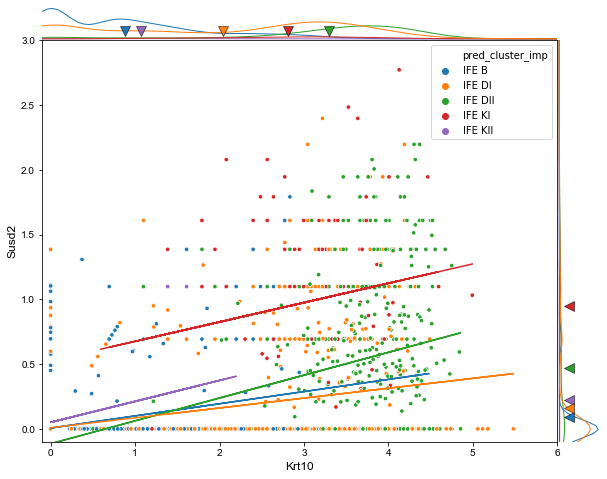

In [84]:
# Specify parameters
statistic = 'pred_cluster_imp'
xn = 'Krt10'
yn = 'Susd2'

#tmp = data_magic[data_magic.obs['pred_cluster_imp'].isin(['IFE B','IFE DI','IFE DII'])]
tmp = data_magic.copy()
df = pd.DataFrame(tmp.obs[statistic])
df[xn] = tmp.raw.X[:, np.where(tmp.raw.var_names==xn)[0][0]]
df[yn] = tmp.raw.X[:, np.where(tmp.raw.var_names==yn)[0][0]]

hue = 'pred_cluster_imp'
style = None
xlim = [-0.1,6]
ylim = [-0.1,3]

# Initialize figure and gs
fig, gs = plot_scatter_hist_initialize_gs(nrows = 2, ncols = 2, ratio = 12, figsize = (10,8), wspace = 0, hspace = 0)
#c_list = sbn.color_palette(n_colors=len(set(df[statistic])))
#c_list = list(cmap_stage.values())[::-1]
#c_list = sbn.color_palette(n_colors=4)[1:4:2][::-1]
c_list = {c: sbn.color_palette(palette = 'tab10', n_colors = 5)[ix] for ix, c in enumerate(tmp.obs[statistic].cat.categories)}

type_array = [df[df[statistic]==stat] for stat in set(df[statistic])]

bins = 10
alpha = 0.5
s = 20

# Define scatterplot gs axes
ax_g = plt.subplot(gs[1,0])
scatterplots = [ax_g]

# Plot scatterplots
g = sbn.scatterplot(data = df, x=xn, y=yn, hue = hue, s = s, ax = ax_g, legend = 'brief', style = style)

# Modify axes, plot trendline
for ix, tmp_df in enumerate(type_array):
    for ax_ix, ax in enumerate(scatterplots):
        plot_trendline_scatter_hist(df = tmp_df, x = xn, y = yn, ax = ax, 
                                    color = c_list[list(set(tmp_df[hue]))[0]],plot_text = False,
                                    statistic = statistic, plot_equation=False, text_offset = 0.01)
        hide_y = False if ax_ix==0 else True
        plot_scatter_hist_set_axes(ax, xlabel = '', ylabel = '',
                                   xlim = xlim, ylim = ylim, hide_y = hide_y)

g.set_ylabel(yn)
g.set_xlabel(xn)

# Set titles

#Specify legends
#g_dcn.legend(title='Age', labels = ['p33','p63'])
#g.legend('',frameon = False)

# Plot side histograms
plot_hist_side(type_array, statistic=xn, lim = xlim, axes = gs[0,0], c_list = [c_list[stat] for stat in set(df[hue])], plot_axis = 'x', 
               hist_range = 100, bins = bins, xlim = xlim, ylim = ylim)

plot_hist_side(type_array, statistic=yn, lim = ylim, axes = gs[1, 1], c_list = [c_list[stat] for stat in set(df[hue])], plot_axis = 'y', 
               hist_range = 100, bins = bins, xlim = xlim, ylim = ylim)

#ax_g.axhline(1.84, c = 'k', ls = ':')
#ax_g.axvline(2, c = 'k', ls = ':')

clear_output()
figname = 'Anagen10x_images_Sparc_Dcn_HF-compartment_scatterplots_normalized_stat-tests_v3_lighter.pdf'
"""plt.savefig(os.path.join(path_figures, figname), 
            format = 'pdf', 
            transparent = True, 
            bbox_inches = 'tight', 
            pad_inches = 0, 
            rasterized = True)"""

"plt.savefig(os.path.join(path_figures, figname), \n            format = 'pdf', \n            transparent = True, \n            bbox_inches = 'tight', \n            pad_inches = 0, \n            rasterized = True)"

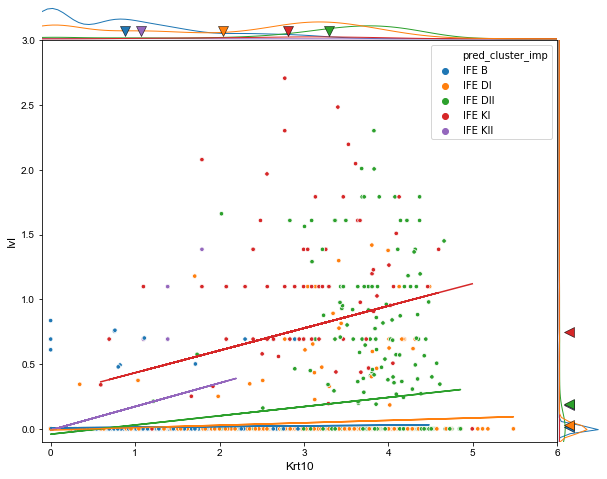

In [117]:
# Specify parameters
statistic = 'pred_cluster_imp'
xn = 'Krt10'
yn = 'Ivl'

#tmp = data_magic[data_magic.obs['pred_cluster_imp'].isin(['IFE B','IFE DI','IFE DII'])]
tmp = data_magic.copy()
df = pd.DataFrame(tmp.obs[statistic])
df[xn] = tmp.raw.X[:, np.where(tmp.raw.var_names==xn)[0][0]]
df[yn] = tmp.raw.X[:, np.where(tmp.raw.var_names==yn)[0][0]]

hue = 'pred_cluster_imp'
style = None
xlim = [-0.1,6]
ylim = [-0.1,3]

# Initialize figure and gs
fig, gs = plot_scatter_hist_initialize_gs(nrows = 2, ncols = 2, ratio = 12, figsize = (10,8), wspace = 0, hspace = 0)
#c_list = sbn.color_palette(n_colors=len(set(df[statistic])))
#c_list = list(cmap_stage.values())[::-1]
#c_list = sbn.color_palette(n_colors=4)[1:4:2][::-1]
c_list = {c: sbn.color_palette(palette = 'tab10', n_colors = 5)[ix] for ix, c in enumerate(tmp.obs[statistic].cat.categories)}

type_array = [df[df[statistic]==stat] for stat in set(df[statistic])]

bins = 10
alpha = 0.5
s = 20

# Define scatterplot gs axes
ax_g = plt.subplot(gs[1,0])
scatterplots = [ax_g]

# Plot scatterplots
g = sbn.scatterplot(data = df, x=xn, y=yn, hue = hue, s = s, ax = ax_g, legend = 'brief', style = style)

# Modify axes, plot trendline
for ix, tmp_df in enumerate(type_array):
    for ax_ix, ax in enumerate(scatterplots):
        plot_trendline_scatter_hist(df = tmp_df, x = xn, y = yn, ax = ax, 
                                    color = c_list[list(set(tmp_df[hue]))[0]],plot_text = False,
                                    statistic = statistic, plot_equation=False, text_offset = 0.01)
        hide_y = False if ax_ix==0 else True
        plot_scatter_hist_set_axes(ax, xlabel = '', ylabel = '',
                                   xlim = xlim, ylim = ylim, hide_y = hide_y)

g.set_ylabel(yn)
g.set_xlabel(xn)

# Set titles

#Specify legends
#g_dcn.legend(title='Age', labels = ['p33','p63'])
#g.legend('',frameon = False)

# Plot side histograms
plot_hist_side(type_array, statistic=xn, lim = xlim, axes = gs[0,0], c_list = [c_list[stat] for stat in set(df[hue])], plot_axis = 'x', 
               hist_range = 100, bins = bins, xlim = xlim, ylim = ylim)

plot_hist_side(type_array, statistic=yn, lim = ylim, axes = gs[1, 1], c_list = [c_list[stat] for stat in set(df[hue])], plot_axis = 'y', 
               hist_range = 100, bins = bins, xlim = xlim, ylim = ylim)

#ax_g.axhline(1.84, c = 'k', ls = ':')
#ax_g.axvline(2, c = 'k', ls = ':')

clear_output()
figname = 'Anagen10x_images_Sparc_Dcn_HF-compartment_scatterplots_normalized_stat-tests_v3_lighter.pdf'
"""plt.savefig(os.path.join(path_figures, figname), 
            format = 'pdf', 
            transparent = True, 
            bbox_inches = 'tight', 
            pad_inches = 0, 
            rasterized = True)"""

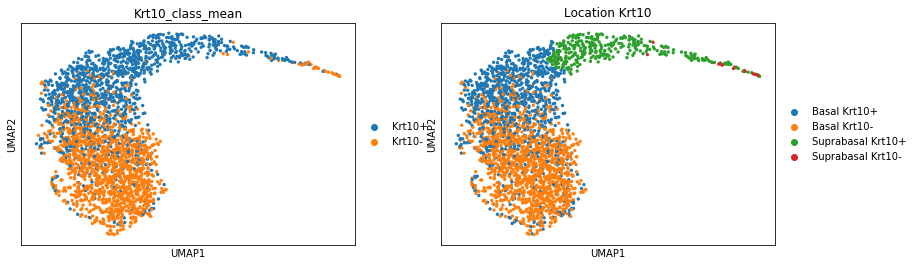

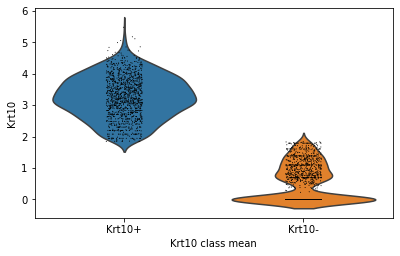

In [36]:
sc.pl.umap(data_magic, color = ['Krt10_class_mean', 'Location Krt10'])
sc.pl.violin(data_magic, 'Krt10', groupby = 'Krt10_class_mean')

# Compare Krt10+ and Krt10- basal cells

In [46]:
sc.tl.rank_genes_groups(data_magic, groupby = 'Location Krt10', groups = ['Basal Krt10+', 'Basal Krt10-'], n_genes = len(data_magic.raw.var_names))

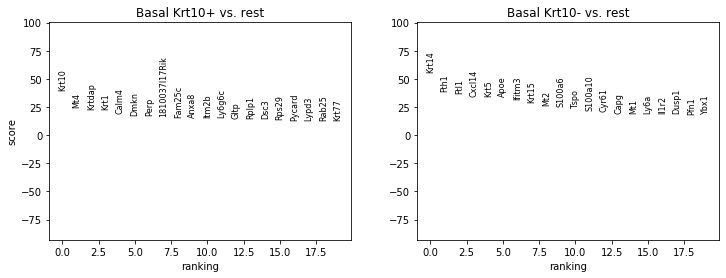

In [47]:
sc.pl.rank_genes_groups(data_magic)

18

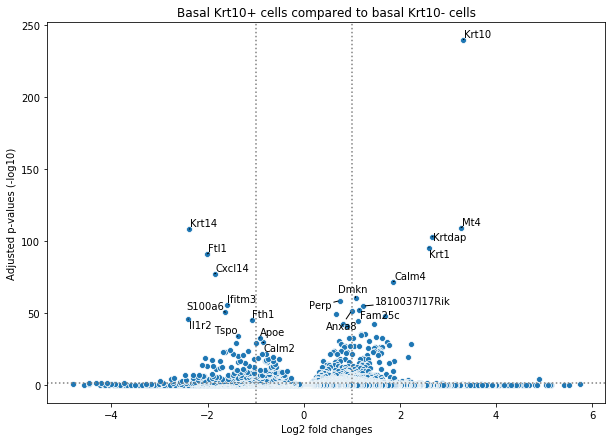

In [54]:
fig, ax = plt.subplots(1, figsize = (10,7))

group = 'Basal Krt10+'

tmp = sc.get.rank_genes_groups_df(data_magic, 'Basal Krt10+')
tmp['pvals_adj'] = -np.log10(tmp['pvals_adj'])
tmp['scores'] = abs(tmp['scores'])
tmp = tmp.loc[abs(tmp['logfoldchanges'])<10]

sbn.scatterplot(data = tmp, x = 'logfoldchanges', y = 'pvals_adj', ax = ax)
ax.axvline(1, c = 'grey', ls = ':')
ax.axvline(-1, c = 'grey', ls = ':')
ax.axhline(2, c = 'grey', ls = ':')
#ax.set_xlim([-5,5])
ax.set_ylabel('Adjusted p-values (-log10)')
ax.set_xlabel('Log2 fold changes')
ax.set_title('Basal Krt10+ cells compared to basal Krt10- cells')

texts = [ax.text(x = x, y = y, s = s, fontsize = 10) for x, y, s in tmp.loc[tmp['logfoldchanges']>0].sort_values(by = 'scores', ascending = False)[['logfoldchanges','pvals_adj','names']].iloc[:10].values]
texts.extend([ax.text(x = x, y = y, s = s, fontsize = 10) for x, y, s in tmp.loc[tmp['logfoldchanges']<0].sort_values(by = 'scores', ascending = False)[['logfoldchanges','pvals_adj','names']].iloc[:10].values])
#adjust_text(texts, x = tmp['logfoldchanges'], y = tmp['pvals_adj'], arrowprops=dict(arrowstyle="-", color='k', lw=1))
adjust_text(texts, arrowprops=dict(arrowstyle="-", color='k', lw=1))

# Compare basal vs suprabasal Krt10+ cells

In [55]:
sc.tl.rank_genes_groups(data_magic, groupby = 'Location Krt10', groups = ['Basal Krt10+', 'Suprabasal Krt10+'], n_genes = len(data_magic.raw.var_names))

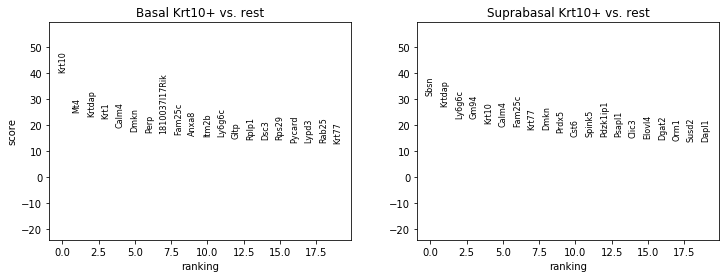

In [57]:
sc.pl.rank_genes_groups(data_magic)

219

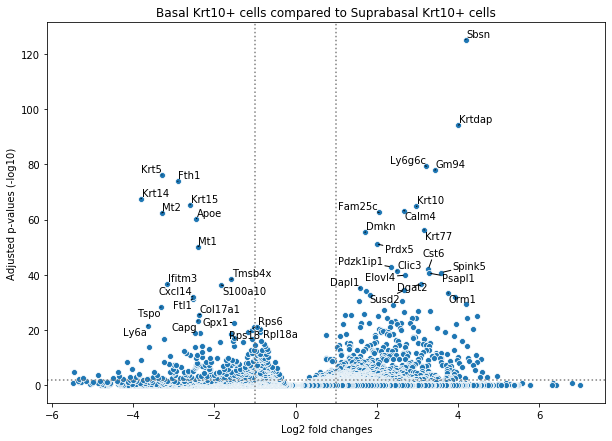

In [60]:
fig, ax = plt.subplots(1, figsize = (10,7))

group = 'Suprabasal Krt10+'

tmp = sc.get.rank_genes_groups_df(data_magic, group)
tmp['pvals_adj'] = -np.log10(tmp['pvals_adj'])
tmp['scores'] = abs(tmp['scores'])
tmp = tmp.loc[abs(tmp['logfoldchanges'])<10]

sbn.scatterplot(data = tmp, x = 'logfoldchanges', y = 'pvals_adj', ax = ax)
ax.axvline(1, c = 'grey', ls = ':')
ax.axvline(-1, c = 'grey', ls = ':')
ax.axhline(2, c = 'grey', ls = ':')
#ax.set_xlim([-5,5])
ax.set_ylabel('Adjusted p-values (-log10)')
ax.set_xlabel('Log2 fold changes')
ax.set_title('Basal Krt10+ cells compared to Suprabasal Krt10+ cells')

texts = [ax.text(x = x, y = y, s = s, fontsize = 10) for x, y, s in tmp.loc[tmp['logfoldchanges']>0].sort_values(by = 'scores', ascending = False)[['logfoldchanges','pvals_adj','names']].iloc[:20].values]
texts.extend([ax.text(x = x, y = y, s = s, fontsize = 10) for x, y, s in tmp.loc[tmp['logfoldchanges']<0].sort_values(by = 'scores', ascending = False)[['logfoldchanges','pvals_adj','names']].iloc[:20].values])
#adjust_text(texts, x = tmp['logfoldchanges'], y = tmp['pvals_adj'], arrowprops=dict(arrowstyle="-", color='k', lw=1))
adjust_text(texts, arrowprops=dict(arrowstyle="-", color='k', lw=1))

# Compare suprabasal Krt10+ vs suprabasal Krt10- cells

In [61]:
sc.tl.rank_genes_groups(data_magic, groupby = 'Location Krt10', groups = ['Suprabasal Krt10+', 'Suprabasal Krt10-'], n_genes = len(data_magic.raw.var_names))

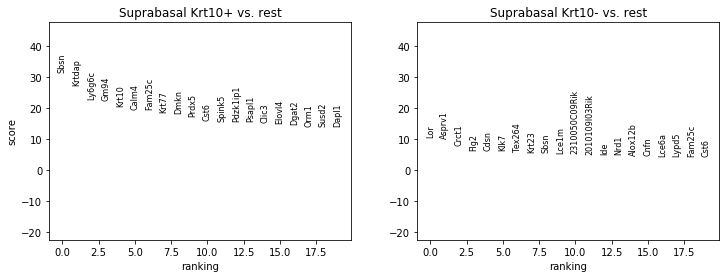

In [62]:
sc.pl.rank_genes_groups(data_magic)

500

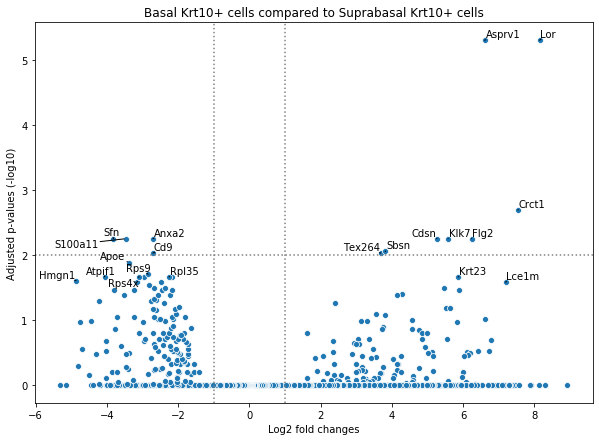

In [65]:
fig, ax = plt.subplots(1, figsize = (10,7))

group = 'Suprabasal Krt10-'

tmp = sc.get.rank_genes_groups_df(data_magic, group)
tmp['pvals_adj'] = -np.log10(tmp['pvals_adj'])
tmp['scores'] = abs(tmp['scores'])
tmp = tmp.loc[abs(tmp['logfoldchanges'])<10]

sbn.scatterplot(data = tmp, x = 'logfoldchanges', y = 'pvals_adj', ax = ax)
ax.axvline(1, c = 'grey', ls = ':')
ax.axvline(-1, c = 'grey', ls = ':')
ax.axhline(2, c = 'grey', ls = ':')
#ax.set_xlim([-5,5])
ax.set_ylabel('Adjusted p-values (-log10)')
ax.set_xlabel('Log2 fold changes')
ax.set_title('Basal Krt10+ cells compared to Suprabasal Krt10+ cells')

texts = [ax.text(x = x, y = y, s = s, fontsize = 10) for x, y, s in tmp.loc[tmp['logfoldchanges']>0].sort_values(by = 'scores', ascending = False)[['logfoldchanges','pvals_adj','names']].iloc[:10].values]
texts.extend([ax.text(x = x, y = y, s = s, fontsize = 10) for x, y, s in tmp.loc[tmp['logfoldchanges']<0].sort_values(by = 'scores', ascending = False)[['logfoldchanges','pvals_adj','names']].iloc[:10].values])
#adjust_text(texts, x = tmp['logfoldchanges'], y = tmp['pvals_adj'], arrowprops=dict(arrowstyle="-", color='k', lw=1))
adjust_text(texts, arrowprops=dict(arrowstyle="-", color='k', lw=1))

# Analysis from meeting

In [4]:
ivl_data = data_magic[data_magic.obs['cell_identity'].isin(['Tomato+', 'Tomato-'])].copy()
b_sb_cutoff = data_magic[data_magic.obs['Location'] == 'Suprabasal'].obs['pto_coords'].min()

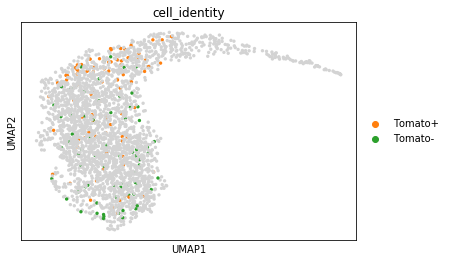

In [6]:
sc.pl.umap(data_magic, color = 'cell_identity', groups=['Tomato+','Tomato-'])

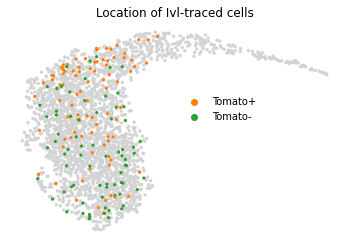

In [17]:
fig, ax = plt.subplots()
sc.pl.umap(data_magic, ax = ax, frameon = False, show = False)
sc.pl.umap(data_magic[data_magic.obs['cell_identity'].isin(['Tomato+','Tomato-'])], color = 'cell_identity', ax = ax, frameon = False, show = False, title = 'Location of Ivl-traced cells', size = 40)
ax.legend(bbox_to_anchor = (0.5, 0.7), frameon = False)
fig.savefig(os.path.join(fig_path, 'UMAP_Ivl_traced_cells.png'), pad_inches = 0.1, bbox_inches = 'tight', dpi = 300)

0.39918007895535984
2.81338910435025e-06


Text(0.5, 0.98, 'Distribution of Ivl-cre/Tomato cells along pseudotime')

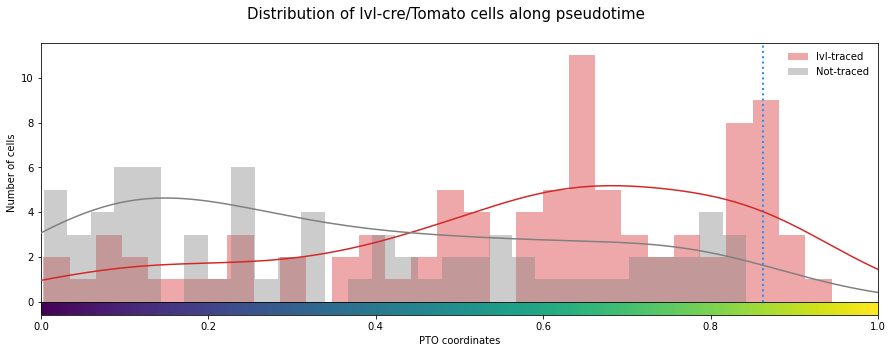

In [18]:
cmap = mpl.cm.viridis

fig, axes = plt.subplots(2, figsize = (15, 5), gridspec_kw={'height_ratios':[1, 0.05], 'hspace':0})
tmp = ivl_data.obs[['pto_coords','cell_identity']]

#plotting axis
ax = axes[0]
#Cbar axis
cax = axes[1]


g = sbn.distplot(tmp[tmp['cell_identity'] == 'Tomato+']['pto_coords'], bins = 30, ax = ax, rug = False, color = 'tab:red', kde = False)
g = sbn.distplot(tmp[tmp['cell_identity'] == 'Tomato-']['pto_coords'], bins = 30, ax = ax, rug = False, color = 'grey', kde = False)
    
ax2 = ax.twinx()
g = sbn.distplot(tmp[tmp['cell_identity'] == 'Tomato+']['pto_coords'], bins = 30, ax = ax2, rug = False, color = 'tab:red', hist = False)
g = sbn.distplot(tmp[tmp['cell_identity'] == 'Tomato-']['pto_coords'], bins = 30, ax = ax2, rug = False, color = 'grey', hist = False)

ax2.set_ylim([0, 3.5])

ax.set_xlim([0, 1])
ax.legend(labels = ['Ivl-traced','Not-traced'], frameon = False)
#ax.set_xticks([])
ax.set_ylabel('Number of cells')
ax.set_xlabel('')
ax.axvline(b_sb_cutoff, c = 'dodgerblue', linewidth = 2, zorder = 1, ls = ':')
clean_axis(ax2)

cbar = mpl.colorbar.ColorbarBase(cax, cmap=cmap, orientation = 'horizontal')
cax.set_xlabel('PTO coordinates')

data2 = tmp[tmp['cell_identity'] == 'Tomato+']['pto_coords'].values
data1 = tmp[tmp['cell_identity'] == 'Tomato-']['pto_coords'].values
stat, p = scipy.stats.ks_2samp(data1, data2)
print(stat)
print(p)

#fig.suptitle('Distribution of Ivl-cre/Tomato cells along pseudotime\nDistributions are significantly different: (p = {})'.format(p), fontsize = 15)
fig.suptitle('Distribution of Ivl-cre/Tomato cells along pseudotime', fontsize = 15)

#fig.savefig(os.path.join(fig_path, 'UMAP_Ivl_traced_cells.png'), pad_inches = 0.1, bbox_inches = 'tight', dpi = 300)

In [66]:
data_magic

AnnData object with n_obs × n_vars = 2646 × 842 
    obs: '10x_leiden', 'Basa-Suprabasal', 'C1_pred_cluster', 'G2M_score', 'G2M_score_separate_original', 'Ivl_cells', 'Krt10 class', 'Krt10_class_mean', 'Krt10_group', 'Krt14_group', 'Location', 'S_score', 'S_score_separate_original', 'batch', 'cell_identity', 'clustering', 'dpt_pseudotime', 'layer', 'leiden', 'leiden_named', 'log1p_n_genes_by_counts', 'log1p_total_counts', 'log1p_total_counts_ERCC', 'log1p_total_counts_mito', 'n_genes', 'n_genes_by_counts', 'pct_counts_ERCC', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'pct_counts_in_top_50_genes', 'pct_counts_mito', 'phase', 'phase_c0', 'phase_c0.05', 'phase_c0.1', 'phase_c0.2', 'phase_separate_original', 'pred_cluster', 'pred_cluster_ds', 'pred_cluster_imp', 'pto_coords', 'pto_coords_diffmap', 'total_counts', 'total_counts_ERCC', 'total_counts_mito', 'umap_density_C1_pred_cluster', 'umap_density_Ivl_cells', 'umap_density_Krt10 class', '

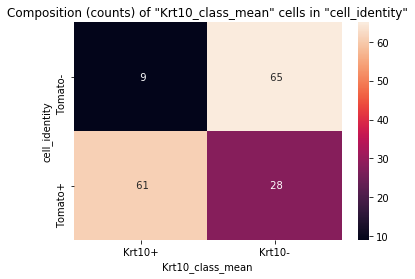

In [67]:
plot_group_composition_heatmap(ivl_data.obs, groupby_name = 'cell_identity', count_group_name = 'Krt10_class_mean', percentage = False)

In [90]:
ivl_data.obs['batch'] = ['b'+x[4].split('_')[1] for x in ivl_data.obs_names[ivl_data.obs_names.str.contains('Tomato')].str.split('-')]

In [91]:
tmp = pd.DataFrame(ivl_data.obs.groupby(by = ['cell_identity','Krt10_class_mean'])['batch'].value_counts())
tmp.columns = ['Krt10_count']
tmp = tmp.reset_index()

In [96]:
tmp

,cell_identity,Krt10_class_mean,batch,Krt10_count
0,Tomato+,Krt10+,b1710,34
1,Tomato+,Krt10+,b2209,27
2,Tomato+,Krt10-,b1710,19
3,Tomato+,Krt10-,b2209,9
4,Tomato-,Krt10+,b1710,6
5,Tomato-,Krt10+,b2209,3
6,Tomato-,Krt10-,b1710,48
7,Tomato-,Krt10-,b2209,17


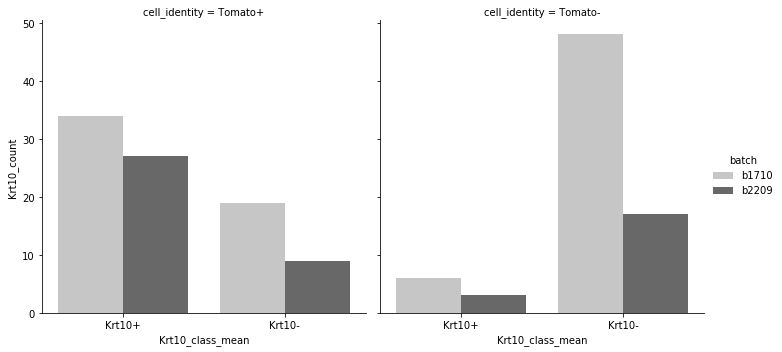

In [101]:
sbn.catplot(data = tmp, x = 'Krt10_class_mean', hue = 'batch', y = 'Krt10_count', col = 'cell_identity', palette = 'Greys', kind = 'bar')

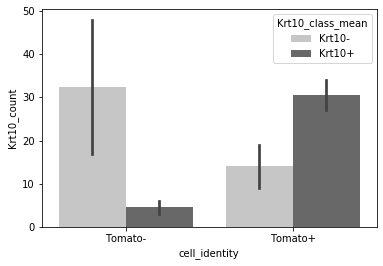

In [94]:
g = sbn.barplot(data = tmp, hue = 'Krt10_class_mean', x = 'cell_identity', y = 'Krt10_count', order = ['Tomato-','Tomato+'], hue_order = ['Krt10-','Krt10+'], palette = 'Greys')

In [16]:
k10_data = data_magic[data_magic.obs['Krt10_class_mean']=='Krt10+'].copy()

In [17]:
k10_data

AnnData object with n_obs × n_vars = 1251 × 842 
    obs: '10x_leiden', 'Basa-Suprabasal', 'C1_pred_cluster', 'G2M_score', 'G2M_score_separate_original', 'Ivl_cells', 'Krt10 class', 'Krt10_class_mean', 'Krt10_group', 'Krt14_group', 'Location', 'S_score', 'S_score_separate_original', 'batch', 'cell_identity', 'clustering', 'dpt_pseudotime', 'layer', 'leiden', 'leiden_named', 'log1p_n_genes_by_counts', 'log1p_total_counts', 'log1p_total_counts_ERCC', 'log1p_total_counts_mito', 'n_genes', 'n_genes_by_counts', 'pct_counts_ERCC', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'pct_counts_in_top_50_genes', 'pct_counts_mito', 'phase', 'phase_c0', 'phase_c0.05', 'phase_c0.1', 'phase_c0.2', 'phase_separate_original', 'pred_cluster', 'pred_cluster_ds', 'pred_cluster_imp', 'pto_coords', 'pto_coords_diffmap', 'total_counts', 'total_counts_ERCC', 'total_counts_mito', 'umap_density_C1_pred_cluster', 'umap_density_Ivl_cells', 'umap_density_Krt10 class', '

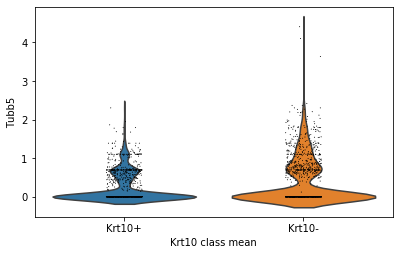

In [18]:
sc.pl.violin(data_magic, keys = 'Tubb5', groupby = 'Krt10_class_mean')

In [7]:
data_magic.obs['Location']

1772067075-D05-ife-C1    Basal
1772067086-E12-ife-C1    Basal
1772072282-G12-ife-C1    Basal
1772067078-F11-ife-C1    Basal
1772067078-G05-ife-C1    Basal
                         ...  
TTTAGCTGGGTTAC-9w-10x    Basal
TTTAGGCTAGAGTA-9w-10x    Basal
TTTCCAGAGCGATT-9w-10x    Basal
TTTCGAACAAGGTA-9w-10x    Basal
TTTGACTGTCGCAA-9w-10x    Basal
Name: Location, Length: 2646, dtype: object

In [17]:
b_sb_cutoff = data_magic[data_magic.obs['Location'] == 'Suprabasal'].obs['pto_coords'].min()

In [4]:
ivl_data = data_magic[data_magic.obs['cell_identity'].isin(['Tomato+', 'Tomato-'])].copy()
b_sb_cutoff = data_magic[data_magic.obs['Location'] == 'Suprabasal'].obs['pto_coords'].min()

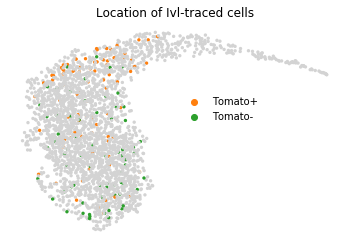

In [257]:
fig, ax = plt.subplots()
sc.pl.umap(data_magic, color = 'cell_identity', groups=['Tomato+','Tomato-'], ax = ax, frameon = False, show = False, title = 'Location of Ivl-traced cells')
ax.legend(bbox_to_anchor = (0.5, 0.7), frameon = False)
#fig.savefig(os.path.join(fig_path, 'UMAP_Ivl_traced_cells.png'), pad_inches = 0.1, bbox_inches = 'tight', dpi = 300)

In [41]:
tmp_path = 'C:/Users/karlan/Downloads/select.txt'
df = pd.read_table(tmp_path, header = None)
df.head(20)

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15
0,MGI:MGI:1927144,salvador family WW domain containing 1,Sav1,NaN,GO:0035329,"{""relationship"": {""relation"": [{""id"": ""BFO:000...",MGI,NCBITaxon:10090,IMP,MGI:MGI:2654594|MGI:MGI:4430538,PANTHER:PTHR10316,protein,NaN,MGI:MGI:4948149|PMID:21512031,20110829,1700040G09Rik|Salv|WW45
1,MGI:MGI:1927144,salvador family WW domain containing 1,Sav1,NaN,GO:0035329,NaN,UniProt,NCBITaxon:10090,IMP,NaN,PANTHER:PTHR10316,protein,NaN,MGI:MGI:4420842|PMID:20080689,20100412,1700040G09Rik|Salv|WW45
2,MGI:MGI:1927144,salvador family WW domain containing 1,Sav1,NaN,GO:0035329,"{""relationship"": {""relation"": [{""id"": ""BFO:000...",MGI,NCBITaxon:10090,IGI,MGI:MGI:103262|MGI:MGI:1333883|MGI:MGI:1354386...,PANTHER:PTHR10316,protein,NaN,MGI:MGI:3785211|PMID:18369314,20110425,1700040G09Rik|Salv|WW45
3,MGI:MGI:6121571,"Predicted gene, 49361",Gm49361,NaN,GO:0035329,NaN,GO_Central,NCBITaxon:10090,IBA,FB:FBgn0011739|MGI:MGI:1333883|MGI:MGI:1354386...,PANTHER:PTHR24356,protein,NaN,PMID:21873635,20200809,UniProtKB:G3UXG3|PTN007797720
4,MGI:MGI:2671987,SH3 and multiple ankyrin repeat domains 2,Shank2,NaN,GO:0035331,NaN,MGI,NCBITaxon:10090,ISO,UniProtKB:Q9UPX8,PANTHER:PTHR24135,protein,NaN,GO_REF:0000096|MGI:MGI:4834177,20200805,ProSAP1
5,MGI:MGI:1261872,"WW, C2 and coiled-coil domain containing 2",Wwc2,NaN,GO:0035331,NaN,MGI,NCBITaxon:10090,ISO,UniProtKB:Q6AWC2,PANTHER:PTHR14791,protein,NaN,GO_REF:0000096|MGI:MGI:4834177,20140512,D8Ertd594e
6,MGI:MGI:3045256,FAT atypical cadherin 4,Fat4,NaN,GO:0035329,NaN,UniProt,NCBITaxon:10090,IMP,NaN,PANTHER:PTHR24026,protein,NaN,MGI:MGI:5544531|PMID:24056717,20140324,6030410K14Rik
7,MGI:MGI:2442631,MOB kinase activator 1A,Mob1a,NaN,GO:0035329,NaN,MGI,NCBITaxon:10090,ISO,UniProtKB:Q9H8S9,PANTHER:PTHR22599,protein,NaN,GO_REF:0000096|MGI:MGI:4834177,20100413,4022402H07Rik|Mobk1b|Mobkl1b
8,MGI:MGI:1917649,WW domain containing transcription regulator 1,Wwtr1,NaN,GO:0035329,NaN,MGI,NCBITaxon:10090,ISO,UniProtKB:Q9GZV5,PANTHER:PTHR17616,protein,NaN,GO_REF:0000096|MGI:MGI:4834177,20100414,2310058J06Rik|2610021I22Rik|TAZ|transcriptiona...
9,MGI:MGI:1917649,WW domain containing transcription regulator 1,Wwtr1,NaN,GO:0035329,NaN,GO_Central,NCBITaxon:10090,IBA,FB:FBgn0034970|MGI:MGI:103262|PANTHER:PTN00042...,PANTHER:PTHR17616,protein,NaN,PMID:21873635,20190306,2310058J06Rik|2610021I22Rik|TAZ|transcriptiona...


In [13]:
bins = 10
data_magic.obs['pto_binned'] = pd.Categorical(np.digitize(data_magic.obs['pto_coords'].values, bins = np.arange(0,1,1/bins)))

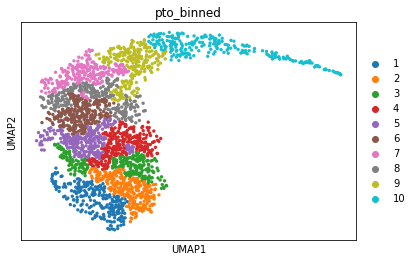

In [20]:
sc.pl.umap(data_magic, color = 'pto_binned', palette = 'tab10')

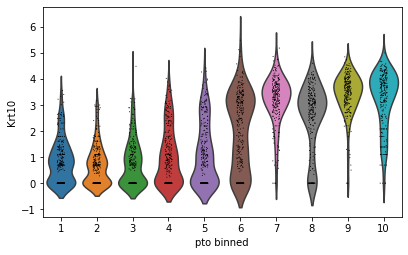

In [21]:
sc.pl.violin(data_magic, keys = 'Krt10', groupby = 'pto_binned')

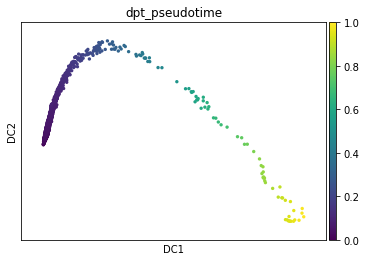

In [10]:
sc.tl.diffmap(data_magic)
data_magic.uns['iroot'] = np.argmin(data_magic.obsm['X_diffmap'][:, 1])
sc.tl.dpt(data_magic)
sc.pl.diffmap(data_magic, color = 'dpt_pseudotime')

In [11]:
dpt_ordered = np.argsort(np.argsort(data_magic.obs['dpt_pseudotime']))
data_magic.obs['dpt_ordered'] = dpt_ordered/max(dpt_ordered)

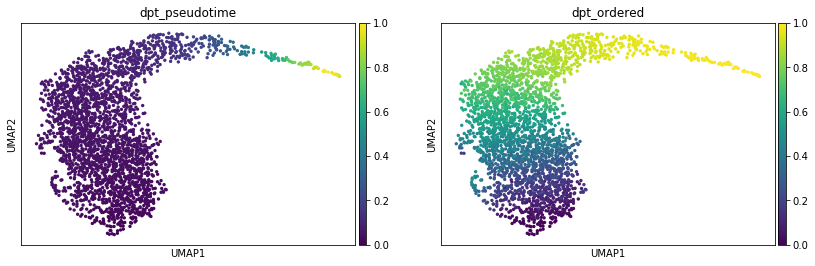

In [44]:
sc.pl.umap(data_magic, color = ['dpt_pseudotime', 'dpt_ordered'])

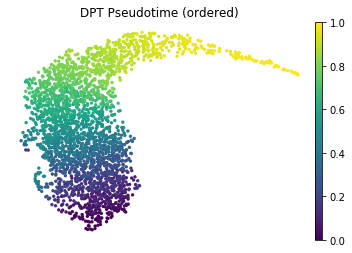

In [255]:
fig, ax = plt.subplots()
sc.pl.umap(data_magic, color = 'dpt_ordered', ax = ax, show = False, frameon = False, title = 'DPT Pseudotime (ordered)')
fig.savefig(os.path.join(fig_path, 'Dpt_pseudotime.png'), pad_inches = 0.1, bbox_inches = 'tight', dpi = 300)

In [13]:
dpt = 'dpt_pseudotime'
bins = 10
data_magic.obs['dpt_binned'] = pd.Categorical(np.digitize(data_magic.obs[dpt].values, bins = np.arange(0,1,1/bins)))

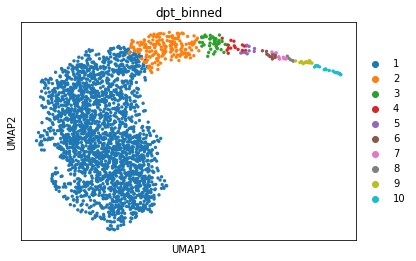

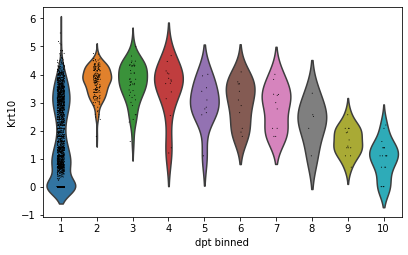

In [14]:
sc.pl.umap(data_magic, color = 'dpt_binned', palette = 'tab10')
sc.pl.violin(data_magic, keys = 'Krt10', groupby = 'dpt_binned')

In [140]:
new_col = 'cluster_ordered_binned'
data_magic.obs[new_col] = np.nan
pto = 'dpt_ordered'
group = 'pred_cluster_imp'
bins = 5

clusters = data_magic.obs[group].cat.categories
for ix, cl in enumerate(clusters):
    pto_coords = data_magic[data_magic.obs[group] == cl].obs[pto]
    start = min(pto_coords)
    end = max(pto_coords)
    data_magic.obs[new_col].loc[pto_coords.index] = ['{}_{}'.format(cl, x_bin) for x_bin in np.digitize(pto_coords, bins = np.arange(start,end,1/bins))]
    #data_magic.obs[new_col].loc[pto_coords.index] = pd.Categorical(np.digitize(pto_coords, bins = np.arange(start,end,1/bins)) + bins*ix)

data_magic.obs[new_col] = pd.Categorical(data_magic.obs[new_col])

C:\Users\karlan\AppData\Local\Continuum\anaconda3\envs\scanpy\lib\site-packages\pandas\core\indexing.py:205: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)


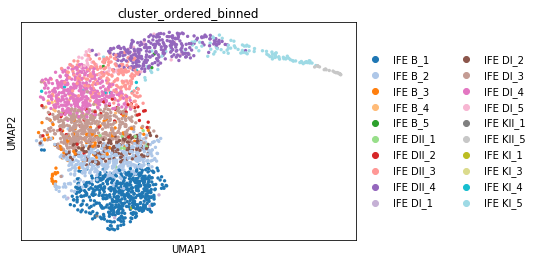

In [141]:
sc.pl.umap(data_magic, color = 'cluster_ordered_binned', palette = 'tab20')

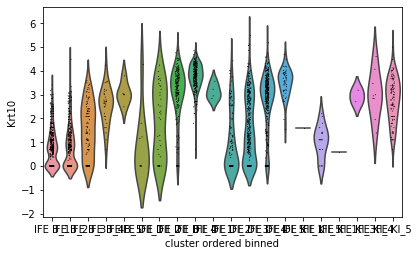

In [142]:
sc.pl.violin(data_magic, keys = 'Krt10', groupby = 'cluster_ordered_binned')

In [275]:
new_col = 'binned_delamination'
data_magic.obs[new_col] = np.nan
pto = 'dpt_ordered'

bins1 = 6
pto_coords = data_magic[data_magic.obs[pto] < b_sb_cutoff_v2].obs[pto]
data_magic.obs[new_col].loc[pto_coords.index] = np.digitize(pto_coords, bins = np.arange(min(pto_coords),max(pto_coords),(max(pto_coords)-min(pto_coords))/bins1))

bins2 = 4
pto_coords = data_magic[data_magic.obs[pto] >= b_sb_cutoff_v2].obs[pto]
data_magic.obs[new_col].loc[pto_coords.index] = np.digitize(pto_coords, bins = np.arange(min(pto_coords),max(pto_coords),(max(pto_coords)-min(pto_coords))/bins2))+bins1

data_magic.obs[new_col] = pd.Categorical(data_magic.obs[new_col])

C:\Users\karlan\AppData\Local\Continuum\anaconda3\envs\scanpy\lib\site-packages\pandas\core\indexing.py:205: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)


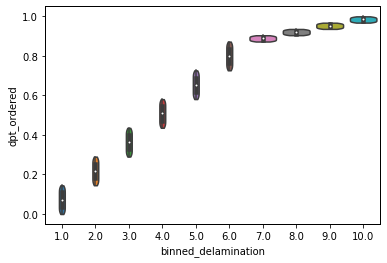

In [276]:
tmp = data_magic.obs[['dpt_ordered', 'binned_delamination']]
sbn.violinplot(data = tmp, x = 'binned_delamination', y = 'dpt_ordered', cut = 0)

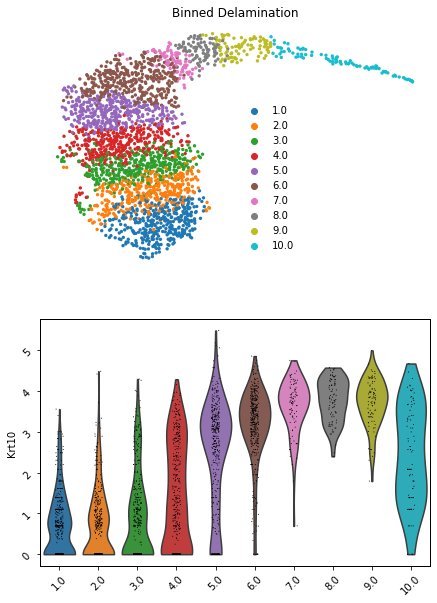

In [95]:
fig, axes = plt.subplots(nrows = 2, ncols = 1, figsize = (7, 10))
palette = 'tab10'
new_col = 'binned_delamination'

if type(data_magic.obs['binned_delamination']) != pd.CategoricalDtype:
    data_magic.obs['binned_delamination'] = pd.Categorical(data_magic.obs['binned_delamination'])

sc.pl.umap(data_magic, color = new_col, palette = palette, frameon = False, ax = axes[0], show = False)
axes[0].legend(bbox_to_anchor = (0.5, 0.7), frameon = False)
axes[0].set_title(new_col.title().replace('_', ' '))
sc.pl.violin(data_magic, keys = 'Krt10', groupby = new_col, cut = 0, palette = palette, rotation = 45, ax = axes[1], show = False)
#fig.savefig(os.path.join(fig_path, 'Binned_dpt_pseudotime_Krt10.png'), pad_inches = 0.1, bbox_inches = 'tight', dpi = 300)

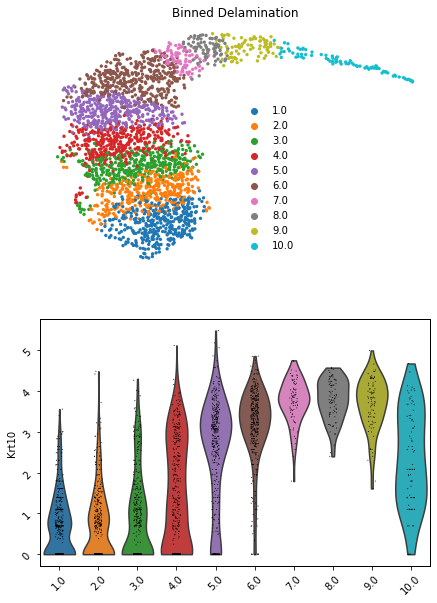

In [277]:
fig, axes = plt.subplots(nrows = 2, ncols = 1, figsize = (7, 10))
palette = 'tab10'
new_col = 'binned_delamination'

if type(data_magic.obs['binned_delamination']) != pd.CategoricalDtype:
    data_magic.obs['binned_delamination'] = pd.Categorical(data_magic.obs['binned_delamination'])

sc.pl.umap(data_magic, color = new_col, palette = palette, frameon = False, ax = axes[0], show = False)
axes[0].legend(bbox_to_anchor = (0.5, 0.7), frameon = False)
axes[0].set_title(new_col.title().replace('_', ' '))
sc.pl.violin(data_magic, keys = 'Krt10', groupby = new_col, cut = 0, palette = palette, rotation = 45, ax = axes[1], show = False)
#fig.savefig(os.path.join(fig_path, 'Binned_dpt_pseudotime_Krt10.png'), pad_inches = 0.1, bbox_inches = 'tight', dpi = 300)

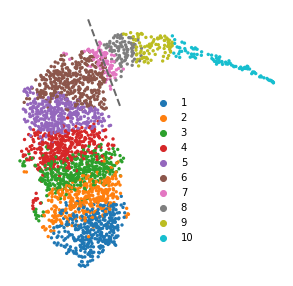

In [117]:
fig, axes = plt.subplots(nrows = 1, ncols = 1, figsize = (5, 5))
palette = 'tab10'
new_col = 'binned_delamination'

if type(data_magic.obs['binned_delamination']) != pd.CategoricalDtype:
    data_magic.obs['binned_delamination'] = pd.Categorical(data_magic.obs['binned_delamination'])

sc.pl.umap(data_magic, color = new_col, palette = palette, frameon = False, ax = axes, show = False)
axes.legend(bbox_to_anchor = (0.5, 0.7), frameon = False)
axes.set_title('')
handles, labels = axes.get_legend_handles_labels()
axes.legend(labels = [str(int(float(x))) for x in labels], handles = handles, frameon = False, bbox_to_anchor = (0.7, 0.7))
#sc.pl.violin(data_magic, keys = 'Krt10', groupby = new_col, cut = 0, palette = palette, rotation = 45, ax = axes[1], show = False)
plot_basal_suprabasal_cutoff(axes)
fig.savefig(os.path.join(fig_path, 'Binned_dpt_pseudotime_Krt10_cutoffLine.png'), pad_inches = 0.1, bbox_inches = 'tight', dpi = 300)

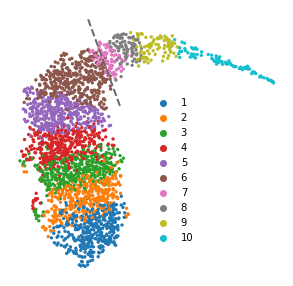

In [285]:
fig, axes = plt.subplots(nrows = 1, ncols = 1, figsize = (5, 5))
palette = 'tab10'
new_col = 'binned_delamination'

if type(data_magic.obs['binned_delamination']) != pd.CategoricalDtype:
    data_magic.obs['binned_delamination'] = pd.Categorical(data_magic.obs['binned_delamination'])

sc.pl.umap(data_magic, color = new_col, palette = palette, frameon = False, ax = axes, show = False)
axes.legend(bbox_to_anchor = (0.5, 0.7), frameon = False)
axes.set_title('')
handles, labels = axes.get_legend_handles_labels()
axes.legend(labels = [str(int(float(x))) for x in labels], handles = handles, frameon = False, bbox_to_anchor = (0.7, 0.7))
#sc.pl.violin(data_magic, keys = 'Krt10', groupby = new_col, cut = 0, palette = palette, rotation = 45, ax = axes[1], show = False)
plot_basal_suprabasal_cutoff(axes)
#fig.savefig(os.path.join(fig_path, 'Binned_dpt_pseudotime_Krt10_cutoffLine.png'), pad_inches = 0.1, bbox_inches = 'tight', dpi = 300)

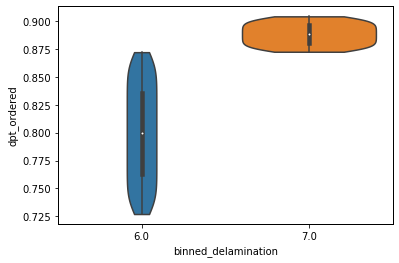

In [283]:
tmp = data_magic[data_magic.obs['binned_delamination'].isin([6.0, 7.0])].obs[['dpt_ordered', 'binned_delamination']]
sbn.violinplot(data = tmp, x = 'binned_delamination', y = 'dpt_ordered', cut = 0)

## Redo the basal-suprabasal classification based on orderd dpt

Basal suprabasal cutoff according to 95 percentile of sorted (Ivl+ and Ivl-) cells on the ordered dpt.

In [320]:
ivl_data = data_magic[data_magic.obs['batch'] == 'Ivl']
b_sb_cutoff_v2 = np.percentile(ivl_data.obs['dpt_ordered'], q = 95)

... storing 'Location' as categorical


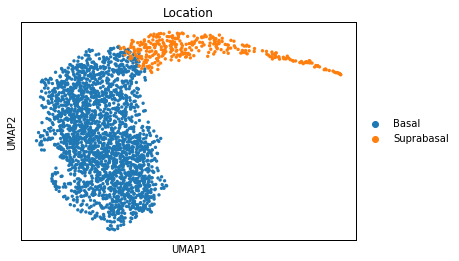

In [324]:
data_magic.obs['Location'] = ['Basal' if x else 'Suprabasal' for x in data_magic.obs['dpt_ordered'] < b_sb_cutoff_v2]
sc.pl.umap(data_magic, color = ['Location'])

Cutoff line for umap:
Base the cutoff line according to the cells at the border of bin 6 and 7, filter out some cells that are far away (x<-2) and would interfere with the trendline too much

In [298]:
r_dict = {}
for i in range(5, 100, 2):
    n_cells = i
    bin6_border = tmp[tmp['binned_delamination'] == 6.0].sort_values(by = 'dpt_ordered', ascending = False).iloc[:n_cells].index
    bin7_border = tmp[tmp['binned_delamination'] == 7.0].sort_values(by = 'dpt_ordered', ascending = True).iloc[:n_cells].index
    border_cells = bin6_border.append(bin7_border)
    border_data = data_magic[border_cells]
    x, y = zip(*border_data.obsm['X_umap'])
    x = np.array(x)
    y = np.array(y)
    ix = np.where(x>-2)[0]
    x = x[ix]
    y = y[ix]
    z = np.polyfit(x, y, 1)
    p = np.poly1d(z)(x)
    r_dict[i] = r2_score(y,p)

Text(23, 0.6432172130616907, 'n_cells: 23; R2: 0.623')

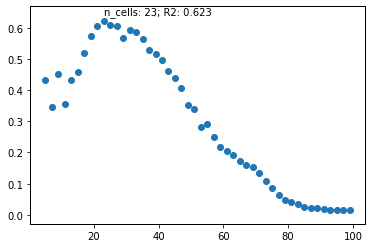

In [316]:
x, y = zip(*r_dict.items())
plt.scatter(x, y)
plt.text(x = x[np.argmax(y)], y = max(y)+0.02, s = 'n_cells: {}; R2: {}'.format(x[np.argmax(y)], round(max(y), 3)))

Coefficients: [-1.09807084  5.8597005 ]


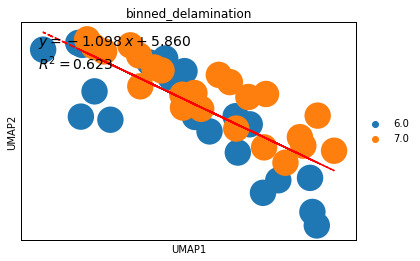

In [317]:
from sklearn.metrics import r2_score
n_cells = 23
bin6_border = tmp[tmp['binned_delamination'] == 6.0].sort_values(by = 'dpt_ordered', ascending = False).iloc[:n_cells].index
bin7_border = tmp[tmp['binned_delamination'] == 7.0].sort_values(by = 'dpt_ordered', ascending = True).iloc[:n_cells].index

fix, ax = plt.subplots()
border_cells = bin6_border.append(bin7_border)
border_data = data_magic[border_cells]

x, y = zip(*border_data.obsm['X_umap'])
x = np.array(x)
y = np.array(y)
ix = np.where(x>-2)[0]
x = x[ix]
y = y[ix]

#ax.scatter(x, y, c = border_data.obs['binned_delamination'][ix])
sc.pl.umap(border_data[ix], color = 'binned_delamination', show = False, ax = ax)
z = np.polyfit(x, y, 1)
p = np.poly1d(z)(x)
ax.plot(x,p,"r--")

text = f"$y={z[0]:0.3f}\;x{z[1]:+0.3f}$\n$R^2 = {r2_score(y,p):0.3f}$"
plt.gca().text(0.05, 0.95, text,transform=plt.gca().transAxes,
     fontsize=14, verticalalignment='top')

print('Coefficients:', z)

In [318]:
def plot_basal_suprabasal_cutoff_v2(ax, x0 = -2.5, x1 = 1, m = -1.09807084, c = 5.8597005, ls = '--', color = 'dimgrey', lw = 2): 
    ax.plot([x0,x1], [m*x0+c, m*x1+c], ls = ls, c = color, lw = lw)

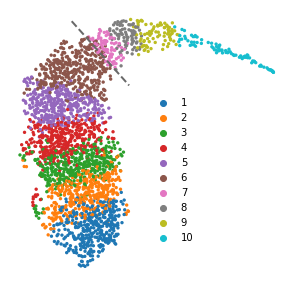

In [66]:
fig, axes = plt.subplots(nrows = 1, ncols = 1, figsize = (5, 5))
palette = 'tab10'
new_col = 'binned_delamination'

if type(data_magic.obs['binned_delamination']) != pd.CategoricalDtype:
    data_magic.obs['binned_delamination'] = pd.Categorical(data_magic.obs['binned_delamination'])

sc.pl.umap(data_magic, color = new_col, palette = palette, frameon = False, ax = axes, show = False)
axes.legend(bbox_to_anchor = (0.5, 0.7), frameon = False)
axes.set_title('')
handles, labels = axes.get_legend_handles_labels()
axes.legend(labels = [str(int(float(x))) for x in labels], handles = handles, frameon = False, bbox_to_anchor = (0.7, 0.7))
#sc.pl.violin(data_magic, keys = 'Krt10', groupby = new_col, cut = 0, palette = palette, rotation = 45, ax = axes[1], show = False)
plot_basal_suprabasal_cutoff_v2(axes, x0 = -2.5, x1 = 1)
#plot_basal_suprabasal_cutoff(axes)
fig.savefig(os.path.join(fig_path, 'Binned_dpt_pseudotime_Krt10_cutoffLine.png'), pad_inches = 0.1, bbox_inches = 'tight', dpi = 300)

ax = axes[ix]


C:\Users\karlan\AppData\Local\Continuum\anaconda3\envs\scanpy\lib\site-packages\anndata\core\anndata.py:299: FutureWarning: In anndata v0.7+, arrays contained within an AnnData object will maintain their dimensionality. For example, prior to v0.7 `adata[0, 0].X` returned a scalar and `adata[0, :]` returned a 1d array, post v0.7 they will return two dimensional arrays. If you would like to get a one dimensional array from your AnnData object, consider using the `adata.obs_vector`, `adata.var_vector` methods or accessing the array directly.
  warn_flatten()


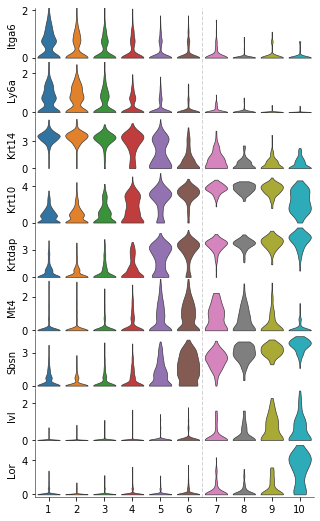

In [80]:
mpl.rcParams['axes.linewidth'] = 0.5

q = 99.9

#genes = ['Krt10', 'Krtdap', 'Sbsn', 'Krt14', 'Bhlhe40', 'Itga6','Ly6a', 'Col17a1', 'Krt5', 'Mt2', 'Mt4', 'Krt1', 'Krt77', 'Dsg1a', 'Ly6g6c', 'Calm4', 'Spink5', 'Klk7', 'Flg2', 'Lor']
genes = ['Itga6', 'Ly6a', 'Krt14', 'Krt10', 'Krtdap', 'Mt4', 'Sbsn','Ivl','Lor']
fig, axes = initialize_subplots(len(genes), ncols = 1, figsize_multiplier=(5, 1), sharex = True, gridspec_kw = {'hspace': 0.0})

for ix, g in enumerate(genes):
    ax = axes[ix]
    sc.pl.violin(data_magic, keys = g, groupby = new_col, cut = 0, palette = palette, rotation = 0, ax = ax, show = False, stripplot = False, linewidth = 0.7)
    
    if g in ['Itga6','Ly6a', 'Mt4']:
        vmax = np.percentile(data_magic.raw[:, g].X, q = q)
        ax.set_ylim([ax.get_ylim()[0], vmax])
    
    ax.yaxis.set_major_locator(MaxNLocator(integer=True, nbins = 2))
    if ix < len(genes)-1:
        ax.tick_params(
        axis='x',          # changes apply to the x-axis
        which='both',      # both major and minor ticks are affected
        bottom=False,      # ticks along the bottom edge are off
        top=False,         # ticks along the top edge are off
        labelbottom=False)
        
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)
    
                  
    if ix == len(genes)-1:
        ax.set_xticklabels([str(int(float(x.get_text()))) for x in ax.get_xticklabels()])
    else:
        ax.spines['bottom'].set_visible(False)
    ax.axvline(5.5, ls = '--', c = 'lightgrey', lw = 1)
#fig.suptitle('Gene expression over PTO bins', y = 0.91)
fig.savefig(os.path.join(fig_path, 'Binned_dpt_pseudotime_violinplots_v3.pdf'), pad_inches = 0.1, bbox_inches = 'tight', dpi = 600)
fig.savefig(os.path.join(fig_path, 'Binned_dpt_pseudotime_violinplots_v3.pdf'), pad_inches = 0.1, bbox_inches = 'tight', dpi = 600)

mpl.rcParams['axes.linewidth'] = 1

In [80]:
genes = ['Krt10', 'Krtdap', 'Sbsn', 'Krt14', 'Bhlhe40', 'Itga6','Ly6a', 'Col17a1', 'Krt5', 'Mt2', 'Mt4', 'Krt1', 'Krt77', 'Dsg1a', 'Ly6g6c', 'Calm4', 'Spink5', 'Klk7', 'Flg2', 'Lor']
genes = ['Itga6', 'Ly6a', 'Krt14', 'Krt10', 'Krtdap', 'Mt4', 'Sbsn','Ivl','Lor']
rank = np.argsort(data_magic.obs['dpt_ordered'])
df = pd.DataFrame()
df_norm = pd.DataFrame()
for g in genes:
    expr = data_magic.raw[rank][:, g].X
    df[g] = expr
    df_norm[g] = expr/max(expr)

0.4372912238080777
1.792010662082788e-07


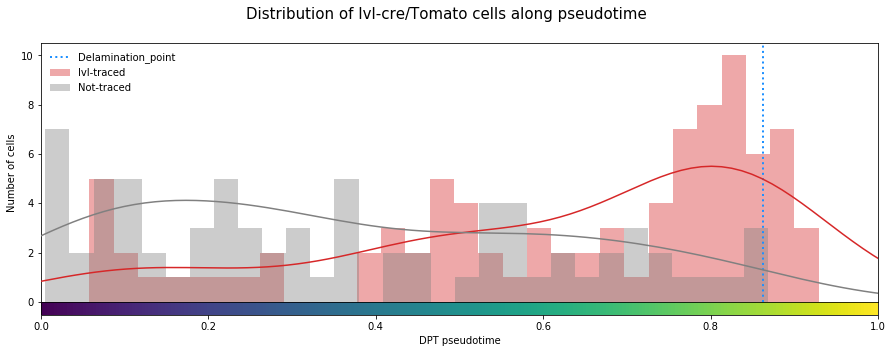

In [298]:
pto = 'dpt_ordered'
cmap = mpl.cm.viridis

fig, axes = plt.subplots(2, figsize = (15, 5), gridspec_kw={'height_ratios':[1, 0.05], 'hspace':0})
tmp = ivl_data.obs[[pto,'cell_identity']]

#plotting axis
ax = axes[0]
#Cbar axis
cax = axes[1]


g = sbn.distplot(tmp[tmp['cell_identity'] == 'Tomato+'][pto], bins = 30, ax = ax, rug = False, color = 'tab:red', kde = False)
g = sbn.distplot(tmp[tmp['cell_identity'] == 'Tomato-'][pto], bins = 30, ax = ax, rug = False, color = 'grey', kde = False)
    
ax2 = ax.twinx()
g = sbn.distplot(tmp[tmp['cell_identity'] == 'Tomato+'][pto], bins = 30, ax = ax2, rug = False, color = 'tab:red', hist = False)
g = sbn.distplot(tmp[tmp['cell_identity'] == 'Tomato-'][pto], bins = 30, ax = ax2, rug = False, color = 'grey', hist = False)

ax2.set_ylim([0, 3.5])

ax.set_xlim([0, 1])

#ax.set_xticks([])
ax.set_ylabel('Number of cells')
ax.set_xlabel('')
ax.axvline(b_sb_cutoff, c = 'dodgerblue', linewidth = 2, zorder = 1, ls = ':')
#ax.axvline(0.5, c = 'k', linewidth = 2, zorder = 1, ls = ':')
ax.legend(labels = ['Delamination_point', 'Ivl-traced','Not-traced'], frameon = False)
clean_axis(ax2)

cbar = mpl.colorbar.ColorbarBase(cax, cmap=cmap, orientation = 'horizontal')
cax.set_xlabel('DPT pseudotime')

data2 = tmp[tmp['cell_identity'] == 'Tomato+'][pto].values
data1 = tmp[tmp['cell_identity'] == 'Tomato-'][pto].values
stat, p = scipy.stats.ks_2samp(data1, data2)
print(stat)
print(p)

#fig.suptitle('Distribution of Ivl-cre/Tomato cells along pseudotime\nDistributions are significantly different: (p = {})'.format(p), fontsize = 15)
fig.suptitle('Distribution of Ivl-cre/Tomato cells along pseudotime', fontsize = 15)

fig.savefig(os.path.join(fig_path, 'Ivl_cells_over_pseudotime.png'), pad_inches = 0.1, bbox_inches = 'tight', dpi = 300)

0.4372912238080777
1.792010662082788e-07


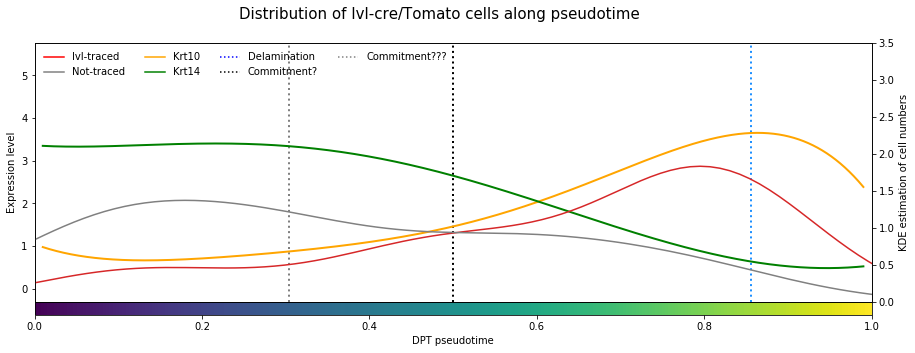

In [303]:
pto = 'dpt_ordered'
cmap = mpl.cm.viridis

fig, axes = plt.subplots(2, figsize = (15, 5), gridspec_kw={'height_ratios':[1, 0.05], 'hspace':0})
tmp = ivl_data.obs[[pto,'cell_identity']]

#plotting axis
ax = axes[0]
#Cbar axis
cax = axes[1]

ax2 = ax.twinx()
g = sbn.distplot(tmp[tmp['cell_identity'] == 'Tomato+'][pto], bins = 30, ax = ax2, rug = False, color = 'tab:red', hist = False)
g = sbn.distplot(tmp[tmp['cell_identity'] == 'Tomato-'][pto], bins = 30, ax = ax2, rug = False, color = 'grey', hist = False)

ax2.set_ylim([0, 3.5])
ax2.set_ylabel('KDE estimation of cell numbers')

ax.set_xlim([0, 1])
ax.legend(labels = ['Ivl-traced','Not-traced'], frameon = False)
#ax.set_xticks([])
ax.set_xlabel('')

line_kwargs = {'c': 'orange', 'ls': '-', 'lw': 2}
plot_pseudotime_gene_expression(data_magic, 'Krt10', color = 'cell_identity', pseudotime_col=pto, use_raw=True,alpha=0,
                                plot_regression=True, regression_step_size=0.0001, regressionLineOrder=5, 
                                **line_kwargs, return_axis=True, plot_reg_expr_intercept=False, cbar=False,
                                round_decimals=3, expr_cutoff=3, print_intercept=True, ax=ax, legend=False)
line_kwargs = {'c': 'green', 'ls': '-', 'lw': 2}
plot_pseudotime_gene_expression(data_magic, 'Krt14', color = 'cell_identity', pseudotime_col=pto, use_raw=True,alpha=0,
                                plot_regression=True, regression_step_size=0.0001, regressionLineOrder=5, 
                                **line_kwargs, return_axis=True, plot_reg_expr_intercept=False, cbar=False,
                                round_decimals=3, expr_cutoff=3, print_intercept=True, ax=ax, legend=False)

ax.set_ylabel('Expression level')

custom_lines = [mpl.lines.Line2D([0], [0], color='red'),
                mpl.lines.Line2D([0], [0], color='gray'),
                mpl.lines.Line2D([0], [0], color='orange'),
                mpl.lines.Line2D([0], [0], color='green'),
                mpl.lines.Line2D([0], [0], color='blue', ls = ':'),
                mpl.lines.Line2D([0], [0], color='k', ls = ':'),
                mpl.lines.Line2D([0], [0], color='grey', ls = ':')]

ax.legend(custom_lines, ['Ivl-traced','Not-traced', 'Krt10', 'Krt14', 'Delamination','Commitment?', 'Commitment???'], ncol = 4, loc = 'upper left', frameon = False)


ax.axvline(b_sb_cutoff, c = 'dodgerblue', linewidth = 2, zorder = 1, ls = ':')
ax.axvline(0.5, c = 'k', linewidth = 2, zorder = 1, ls = ':')
ax.axvline(0.3, c = 'grey', linewidth = 2, zorder = 1, ls = ':')
#clean_axis(ax)

cbar = mpl.colorbar.ColorbarBase(cax, cmap=cmap, orientation = 'horizontal')
cax.set_xlabel('DPT pseudotime')

data2 = tmp[tmp['cell_identity'] == 'Tomato+'][pto].values
data1 = tmp[tmp['cell_identity'] == 'Tomato-'][pto].values
stat, p = scipy.stats.ks_2samp(data1, data2)
print(stat)
print(p)

fig.suptitle('Distribution of Ivl-cre/Tomato cells along pseudotime', fontsize = 15)
fig.savefig(os.path.join(fig_path, 'Ivl_cells_over_pseudotime_with_Krt10_Krt14.png'), pad_inches = 0.1, bbox_inches = 'tight', dpi = 300)

In [381]:
sc.tl.embedding_density(data_magic, basis = 'umap', groupby = 'cell_identity')

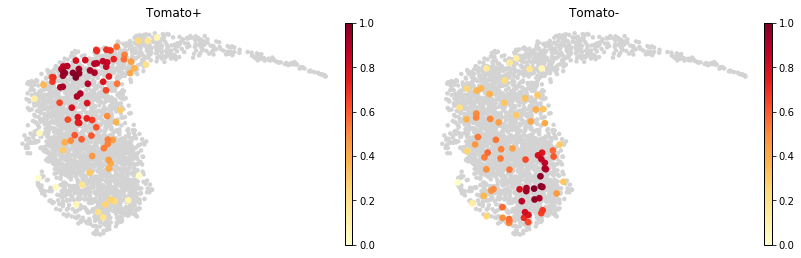

In [388]:
sc.pl.embedding_density(data_magic, basis = 'umap', group = ['Tomato+', 'Tomato-'], key = 'umap_density_cell_identity', frameon = False, save = 'Ivl-traced_embedding_density.pdf')


In [104]:
sc.pp.pca(data_magic)
sc.pp.neighbors(data_magic)

... storing '10x_leiden' as categorical
... storing 'Basa-Suprabasal' as categorical
... storing 'C1_pred_cluster' as categorical
... storing 'Ivl_cells' as categorical
... storing 'Krt10 class' as categorical
... storing 'Krt10_class_mean' as categorical
... storing 'Krt10_group' as categorical
... storing 'Krt14_group' as categorical
... storing 'Location' as categorical
... storing 'batch' as categorical
... storing 'cell_identity' as categorical
... storing 'clustering' as categorical
... storing 'layer' as categorical
... storing 'leiden' as categorical
... storing 'leiden_named' as categorical
... storing 'phase' as categorical
... storing 'phase_c0' as categorical
... storing 'phase_c0.05' as categorical
... storing 'phase_c0.1' as categorical
... storing 'phase_c0.2' as categorical
... storing 'phase_separate_original' as categorical
... storing 'pred_cluster' as categorical
... storing 'pred_cluster_ds' as categorical
... storing 'pred_cluster_imp' as categorical


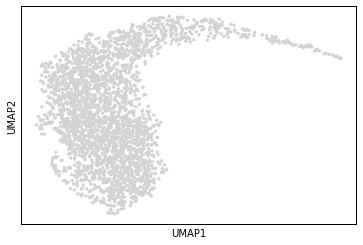

In [105]:
sc.pl.umap(data_magic)

In [111]:
sc.logging.print_versions()

scanpy==1.4.4.post1 anndata==0.6.22.post1 umap==0.3.10 numpy==1.17.3 scipy==1.3.2 pandas==0.25.3 scikit-learn==0.22.2.post1 statsmodels==0.10.2 python-igraph==0.7.1+4.bed07760 louvain==0.6.1


In [411]:
sc.tl.rank_genes_groups(data_magic, groupby = 'pred_cluster_imp')

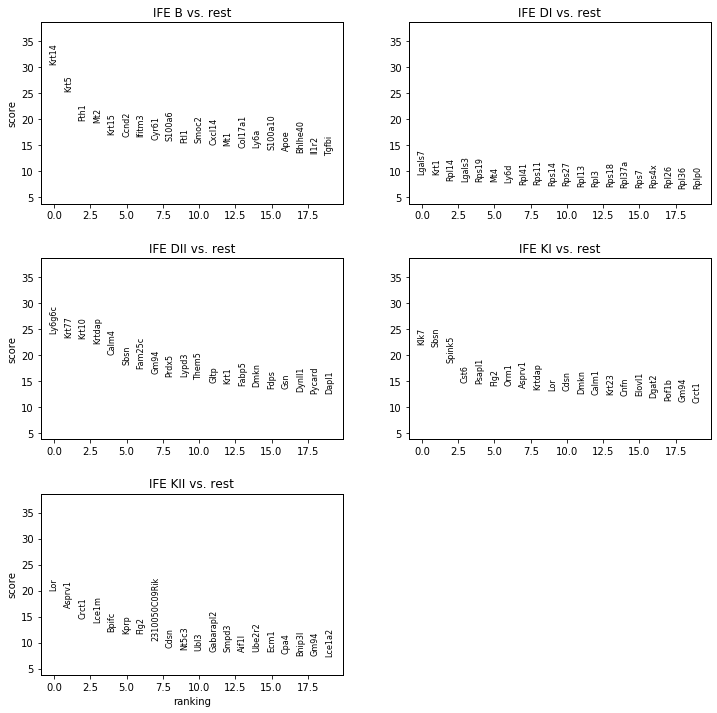

In [412]:
sc.pl.rank_genes_groups(data_magic, ncols = 2)

# Checkpoint 7

In [3]:
fig_path = '{}/Users/karlan/Google Drive/MKA/Papers/Greco/Katie/Figure_output'.format(root)
path = '{}/Users/karlan/Google Drive/MKA/Epidermal stem cells at the point of no return/Sequencing results/Combined_With_Joost_IFE/'.format(root)
filename = '20201008_ingest_combined_imputed_cc-regressed'
raw_filename = '20200408_ingest_combined_imputed_cc-regressed'
raw_filename_downsampled = '20200415_ingest_combined_imputed_cc-regressed_downscaled'

sc.settings.figdir = fig_path

data_magic = sc.read_loom(os.path.join(path, '{}.loom'.format(filename)))

data_magic.raw = sc.read_csv(os.path.join(path, '{}_raw_counts.csv'.format(raw_filename_downsampled)))

with open(os.path.join(path, '{}_MST.pickle'.format(raw_filename)), 'rb') as file:
    MST = pickle.load(file)
    
with open(os.path.join(path, '{}_uns.pickle'.format(filename)), 'rb') as file:
    data_magic.uns = pickle.load(file)
    
b_sb_cutoff_old = data_magic[data_magic.obs['Location'] == 'Suprabasal'].obs['pto_coords'].min()
b_sb_cutoff = 0.8725141776937618

data_magic.obs['binned_delamination'] = pd.Categorical(data_magic.obs['binned_delamination'])

def plot_basal_suprabasal_cutoff_v2(ax, x0 = -2.5, x1 = 1, m = -1.09807084, c = 5.8597005, ls = '--', color = 'dimgrey', lw = 2): 
    ax.plot([x0,x1], [m*x0+c, m*x1+c], ls = ls, c = color, lw = lw)

C:\Users\karlan\AppData\Local\Continuum\anaconda3\envs\scanpy\lib\site-packages\loompy\loom_validator.py:48: H5pyDeprecationWarning: The default file mode will change to 'r' (read-only) in h5py 3.0. To suppress this warning, pass the mode you need to h5py.File(), or set the global default h5.get_config().default_file_mode, or set the environment variable H5PY_DEFAULT_READONLY=1. Available modes are: 'r', 'r+', 'w', 'w-'/'x', 'a'. See the docs for details.
  with h5py.File(path) as f:


ax = axes[ix]


C:\Users\karlan\AppData\Local\Continuum\anaconda3\envs\scanpy\lib\site-packages\anndata\core\anndata.py:299: FutureWarning: In anndata v0.7+, arrays contained within an AnnData object will maintain their dimensionality. For example, prior to v0.7 `adata[0, 0].X` returned a scalar and `adata[0, :]` returned a 1d array, post v0.7 they will return two dimensional arrays. If you would like to get a one dimensional array from your AnnData object, consider using the `adata.obs_vector`, `adata.var_vector` methods or accessing the array directly.
  warn_flatten()


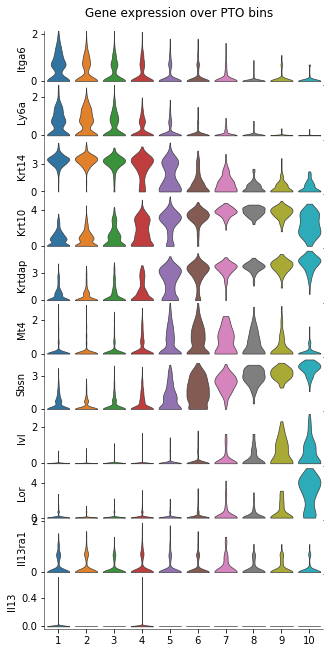

In [326]:
mpl.rcParams['axes.linewidth'] = 0.5

palette = 'tab10'
new_col = 'binned_delamination'
q = 99.9

#genes = ['Krt10', 'Krtdap', 'Sbsn', 'Krt14', 'Bhlhe40', 'Itga6','Ly6a', 'Col17a1', 'Krt5', 'Mt2', 'Mt4', 'Krt1', 'Krt77', 'Dsg1a', 'Ly6g6c', 'Calm4', 'Spink5', 'Klk7', 'Flg2', 'Lor']
genes = ['Itga6', 'Ly6a', 'Krt14', 'Krt10', 'Krtdap', 'Mt4', 'Sbsn','Ivl','Lor', 'Il13ra1','Il4r', 'Il13']
genes = [x for x in genes if x in data_magic.raw.var_names]

fig, axes = initialize_subplots(len(genes), ncols = 1, figsize_multiplier=(5, 1), sharex = True, gridspec_kw = {'hspace': 0})


for ix, g in enumerate(genes):
    ax = axes[ix]
    sc.pl.violin(data_magic, keys = g, groupby = new_col, cut = 0, palette = palette, rotation = 0, ax = ax, show = False, stripplot = False, linewidth = 0.7)
    
    if g in ['Itga6','Ly6a', 'Mt4']:
        vmax = np.percentile(data_magic.raw[:, g].X, q = q)
        ax.set_ylim([ax.get_ylim()[0], vmax])
    
    ax.yaxis.set_major_locator(MaxNLocator(integer=True, nbins = 2))
    if ix < len(genes)-1:
        ax.tick_params(
        axis='x',          # changes apply to the x-axis
        which='both',      # both major and minor ticks are affected
        bottom=False,      # ticks along the bottom edge are off
        top=False,         # ticks along the top edge are off
        labelbottom=False)
        
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)
                  
    if ix == len(genes)-1:
        ax.set_xticklabels([str(int(float(x.get_text()))) for x in ax.get_xticklabels()])
    
fig.suptitle('Gene expression over PTO bins', y = 0.91)
#fig.savefig(os.path.join(fig_path, 'Binned_dpt_pseudotime_violinplots_v2.pdf'), pad_inches = 0.1, bbox_inches = 'tight', dpi = 300)

mpl.rcParams['axes.linewidth'] = 1

In [59]:
tmp.uns['batch_colors']

['#D3D3D3', '#6495ED', '#FF4500']

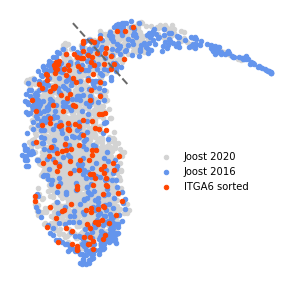

In [65]:
cmap = ['lightgrey','cornflowerblue', 'orangered']
data_magic.uns['batch_colors'] = [mpl.colors.cnames[x] for x in cmap]

fig, ax = plt.subplots(figsize = (5,5))
batches = ['10x', 'C1', 'Ivl']

for ix, batch in enumerate(batches):
    tmp = data_magic[data_magic.obs['batch']==batch]
    umap = tmp.obsm['X_umap']
    ax.scatter(x = umap[:, 0], y = umap[:, 1], color = tmp.uns['batch_colors'], s = 20, alpha = 1)

ax.legend(labels = ['Joost 2020','Joost 2016','ITGA6 sorted'], frameon = False, bbox_to_anchor = (0.5,0.5))
clean_axis(ax)
plot_basal_suprabasal_cutoff_v2(ax)
plt.savefig(os.path.join(fig_path, 'UMAP_ingest_batch_wider_cutoffLine.png'), transparent = True, bbox_inches = 'tight', dpi = 600)
plt.savefig(os.path.join(fig_path, 'UMAP_ingest_batch_wider_cutoffLine.pdf'), transparent = True, bbox_inches = 'tight', dpi = 600)

ax = axes[ix]


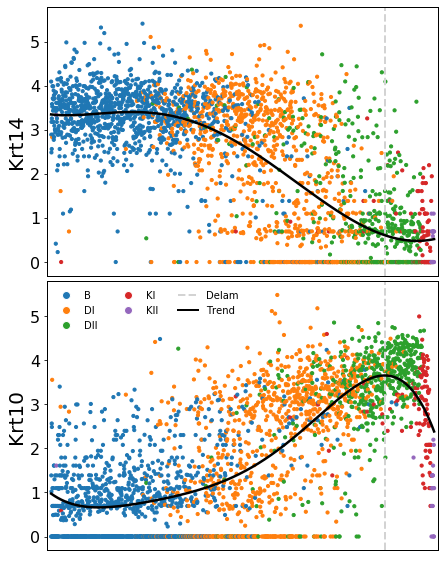

In [402]:
line_kwargs = {'c': 'k', 'ls': '-', 'lw': 2.5}
genes = ['Krt14','Krt10']
ncols = 1

fig, axes = initialize_subplots(len(genes), ncols = ncols, gridspec_kw = {'hspace': 0.02}, sharey = True)

for ix, g in enumerate(genes):
    ax = axes[ix]
    plot_pseudotime_gene_expression(data_magic, g, color = 'pred_cluster_imp', pseudotime_col='dpt_ordered', use_raw=True,
                                plot_regression=True, regression_step_size=0.0001, regressionLineOrder=5, legend = False,
                                **line_kwargs, plot_reg_expr_intercept=False, ax = ax, cbar = False)
    ax.axvline(b_sb_cutoff, c ='lightgrey', linewidth = 2, zorder = 1, ls = '--')
    #ax.set_yticklabels([x.get_text() for x in list(ax.get_yticklabels())])
    ax.tick_params(axis='y', which='major', labelsize=16)
    ax.set_ylabel(g, fontsize = 20)
    
    if ix == len(genes)-1:
        #Custom legend
        handles = [Line2D([0], [0], marker = 'o', color = 'w', label = label.split(' ')[-1], 
                      markerfacecolor = col, markersize = 8) 
               for label, col in zip(data_magic.obs['pred_cluster_imp'].cat.categories, data_magic.uns['pred_cluster_imp_colors'])]
        ax.legend(handles = handles, ncol = 3, frameon = False)
        handles.append(Line2D([0], [0], color='lightgrey', lw=2, label='Delam', LINESTYLE = '--'))
        handles.append(Line2D([0], [0], color='k', lw=2, label='Trend'))
        #handles = [Line2D([0], [0], color='lightgrey', lw=2, label='Delam'),
        #           Line2D([0], [0], color='k', lw=2, label='Trend')]
        ax.legend(handles = handles, ncol = 3, frameon = False)
plt.savefig(os.path.join(fig_path, 'PTO_dpt-ordered_Krt14_Krt10.png'), transparent = True, bbox_inches = 'tight', dpi = 600)

ax = axes[ix]


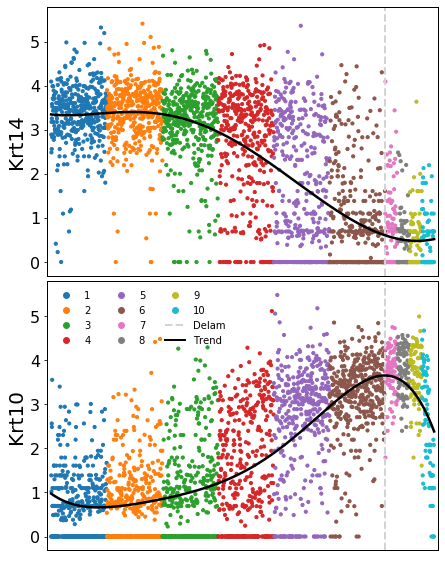

In [405]:
line_kwargs = {'c': 'k', 'ls': '-', 'lw': 2.5}
genes = ['Krt14','Krt10']
ncols = 1

group = 'binned_delamination'

fig, axes = initialize_subplots(len(genes), ncols = ncols, gridspec_kw = {'hspace': 0.02}, sharey = True)

for ix, g in enumerate(genes):
    ax = axes[ix]
    plot_pseudotime_gene_expression(data_magic, g, color = group, pseudotime_col='dpt_ordered', use_raw=True,
                                plot_regression=True, regression_step_size=0.0001, regressionLineOrder=5, legend = False,
                                **line_kwargs, plot_reg_expr_intercept=False, ax = ax, cbar = False)
    ax.axvline(b_sb_cutoff, c ='lightgrey', linewidth = 2, zorder = 1, ls = '--')
    #ax.set_yticklabels([x.get_text() for x in list(ax.get_yticklabels())])
    ax.tick_params(axis='y', which='major', labelsize=16)
    ax.set_ylabel(g, fontsize = 20)
    
    if ix == len(genes)-1:
        #Custom legend
        handles = [Line2D([0], [0], marker = 'o', color = 'w', label = str(int(float(label))), 
                      markerfacecolor = col, markersize = 8) 
               for label, col in zip(data_magic.obs[group].cat.categories, data_magic.uns['{}_colors'.format(group)])]
        ax.legend(handles = handles, ncol = 3, frameon = False)
        handles.append(Line2D([0], [0], color='lightgrey', lw=2, label='Delam', LINESTYLE = '--'))
        handles.append(Line2D([0], [0], color='k', lw=2, label='Trend'))
        #handles = [Line2D([0], [0], color='lightgrey', lw=2, label='Delam'),
        #           Line2D([0], [0], color='k', lw=2, label='Trend')]
        ax.legend(handles = handles, ncol = 3, frameon = False)
#plt.savefig(os.path.join(fig_path, 'PTO_dpt-ordered_Krt14_Krt10.png'), transparent = True, bbox_inches = 'tight', dpi = 600)

In [174]:
cmap_2nd.keys()

dict_keys([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24])

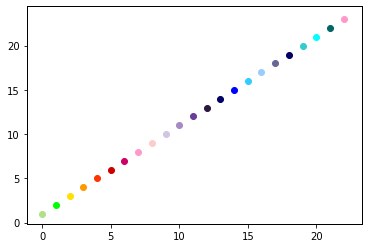

In [177]:
cmap_1st = {2:'#00CC00',
          1:'#FFE000',
          8:'#FF9900',
          0:'#FF3300',
          10:'#CC0000',
          6:'#cab2d6',
          3:'#A68BC2',
          4:'#65429A',
          5:'#000066',
          7:'#0066FF',
          9:'#33CCCC',
          11:'#FF99CC',
          12:'#660033'}

cmap_2nd = {0: '#33a02c',
            1: '#b2df8a',
            2: '#00FF00',
            3:'#FFE000',
            4:'#FF9900',
            5:'#FF3300',
            6:'#CC0000',
            7:'#CC0066',
            8:'#FF99CC',
            9:'#FFCCCC',
            10:'#D2C5E1',
            11:'#A68BC2',
            12:'#6a3d9a',
            13:'#2A183E',
            14:'#000066',
            15:'#0000FF',
            16:'#33CCFF',
            17:'#99CCFF',
            18:'#666699',
            19:'#000066',
            20:'#33CCCC',
            21:'#00FFFF',
            22:'#006666',
            23:'#FF99CC',
            24:'#660033'}

for ix, i in enumerate(range(1, max(cmap_2nd.keys()))):
    plt.scatter(x = ix, y = i, c = cmap_2nd[i])

In [172]:
cmap = mpl.colors.LinearSegmentedColormap.from_list("", ["green","yellow","red"])
cmap

In [ ]:
1: '#b2df8a',
            2: '#00FF00',
            3:'#FFE000',
            4:'#FF9900',
            5:'#FF3300'

In [179]:
data_magic.obs['pred_cluster_imp'].cat.categories

Index(['IFE B', 'IFE DI', 'IFE DII', 'IFE KI', 'IFE KII'], dtype='object')

In [ ]:
2: '#00FF00',
            3:'#FFE000',
            4:'#FF9900',
            5:'#FF3300',
            6:'#CC0000',

In [186]:
old_colors = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd']
new_colors = ['#00FF00', '#FFE000', '#FF9900', '#FF3300', '#CC0000']

In [187]:
data_magic.uns['pred_cluster_imp_colors'] = new_colors

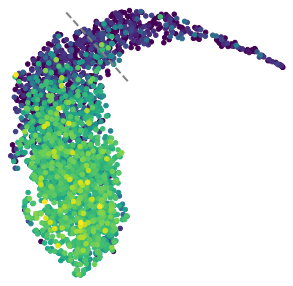

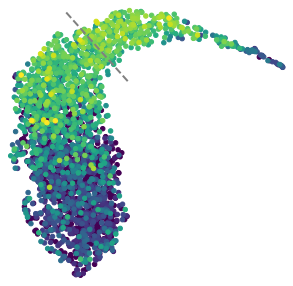

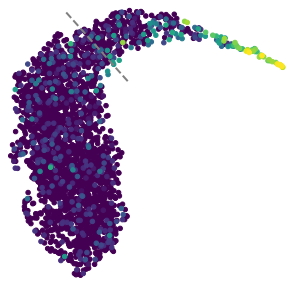

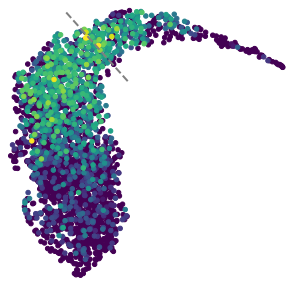

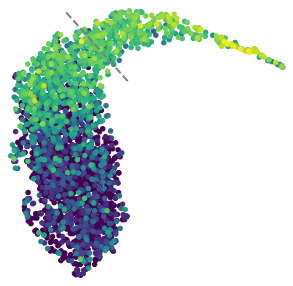

In [226]:
percentile = 99.9
add_perc = 0.2

genes = ['Krt14','Krt10','Lor','Krt1','Krtdap']
genes = [x for x in genes if x in data_magic.raw.var_names]

for gene in genes:
    fig, ax = plt.subplots(figsize = (5,5))
    
    vmax = np.percentile(data_magic.raw.X[:, np.where(
        data_magic.raw.var_names == gene)[0]].flatten(), q = percentile)
    umap = data_magic.obsm['X_umap']
    expression = data_magic.raw.X[:,np.where(data_magic.raw.var_names == gene)[0]]
    
    expression = expression.flatten()
    rank = np.argsort(expression)
    expression = np.array(expression)[rank]
    umap = np.array(umap)[rank]
    
    ax.scatter(x = umap[:, 0], y = umap[:, 1], c = expression, cmap = 'viridis', s = 20, alpha = 1, vmax = vmax)
    
    ax.set_xlim([umap[:,0].min()-add_perc, umap[:,0].max()+add_perc])
    ax.set_ylim([umap[:,1].min()-add_perc, umap[:,1].max()+add_perc])
    plot_basal_suprabasal_cutoff_v2(ax, color = 'grey')
    #ax.set_title(gene)
    clean_axis(ax)
    
    plt.savefig(os.path.join(fig_path, 'IFE_umap_expression_downsampled_wider_cutoffLine_{}.png'.format(gene)), transparent = True, bbox_inches = 'tight', dpi = 600)
    plt.savefig(os.path.join(fig_path, 'IFE_umap_expression_downsampled_wider_cutoffLine_{}.pdf'.format(gene)), transparent = True, bbox_inches = 'tight', dpi = 600)

ax = axes[ix]


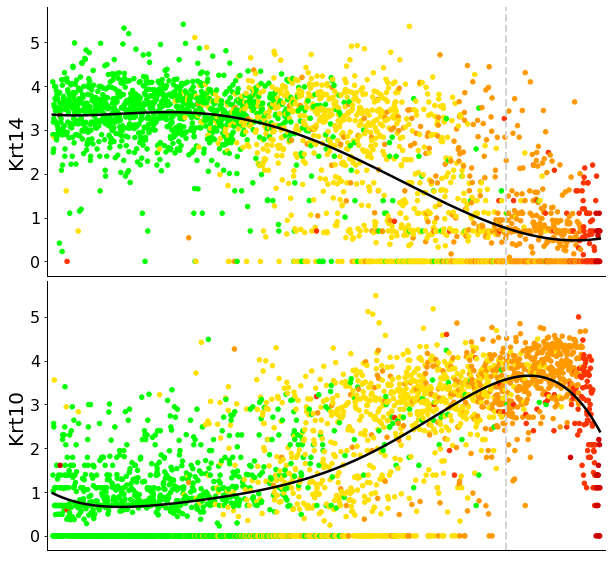

In [248]:
line_kwargs = {'c': 'k', 'ls': '-', 'lw': 2.5}
genes = ['Krt14','Krt10']
ncols = 1

fig, axes = initialize_subplots(len(genes), ncols = ncols, gridspec_kw = {'hspace': 0.02}, sharey = True, figsize_multiplier=(10, 5))

for ix, g in enumerate(genes):
    ax = axes[ix]
    plot_pseudotime_gene_expression(data_magic, g, color = 'pred_cluster_imp', pseudotime_col='dpt_ordered', use_raw=True,
                                plot_regression=True, regression_step_size=0.0001, regressionLineOrder=5, legend = False,
                                **line_kwargs, plot_reg_expr_intercept=False, ax = ax, cbar = False, s=20)
    ax.axvline(b_sb_cutoff, c ='lightgrey', linewidth = 2, zorder = 1, ls = '--')
    #ax.set_yticklabels([x.get_text() for x in list(ax.get_yticklabels())])
    ax.tick_params(axis='y', which='major', labelsize=16)
    ax.set_ylabel(g, fontsize = 20)
    
    for side in ['top','right']:
        ax.spines[side].set_visible(False)
    
    #if ix == len(genes)-1:
    #if ix == 0:
    """if g == 'Krt10':
        #Custom legend
        handles = [Line2D([0], [0], marker = 'o', color = 'w', label = label.split(' ')[-1], 
                      markerfacecolor = col, markersize = 8) 
               for label, col in zip(data_magic.obs['pred_cluster_imp'].cat.categories, data_magic.uns['pred_cluster_imp_colors'])]
        ax.legend(handles = handles, ncol = 3, frameon = False)
        handles.append(Line2D([0], [0], color='lightgrey', lw=2, label='Delam', LINESTYLE = '--'))
        handles.append(Line2D([0], [0], color='k', lw=2, label='Trend'))
        #handles = [Line2D([0], [0], color='lightgrey', lw=2, label='Delam'),
        #           Line2D([0], [0], color='k', lw=2, label='Trend')]
        ax.legend(handles = handles, ncol = 4, frameon = False)"""
plt.savefig(os.path.join(fig_path, 'PTO_dpt-ordered_Krt14_Krt10.png'), transparent = True, bbox_inches = 'tight', dpi = 600)
plt.savefig(os.path.join(fig_path, 'PTO_dpt-ordered_Krt14_Krt10.pdf'), transparent = True, bbox_inches = 'tight', dpi = 600)

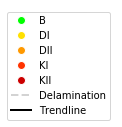

In [270]:
fig, ax = plt.subplots(figsize = (0.5,0.5))
handles = [Line2D([0], [0], marker = 'o', color = 'w', label = label.split(' ')[-1], 
                      markerfacecolor = col, markersize = 8) 
                    for label, col in zip(data_magic.obs['pred_cluster_imp'].cat.categories, data_magic.uns['pred_cluster_imp_colors'])]
#ax.legend(handles = handles, ncol = 3, frameon = False)
handles.append(Line2D([0], [0], color='lightgrey', lw=2, label='Delamination', LINESTYLE = '--'))
handles.append(Line2D([0], [0], color='k', lw=2, label='Trendline'))
#handles = [Line2D([0], [0], color='lightgrey', lw=2, label='Delam'),
#           Line2D([0], [0], color='k', lw=2, label='Trend')]
ax.legend(handles = handles, ncol = 1, frameon = True)
clean_axis(ax)
plt.savefig(os.path.join(fig_path, 'PTO_dpt-ordered_Krt14_Krt10_legend_dots.pdf'), transparent = True, bbox_inches = 'tight', dpi = 600)

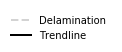

In [265]:
fig, ax = plt.subplots(figsize = (0.5,0.5))
#handles = [Line2D([0], [0], marker = 'o', color = 'w', label = label.split(' ')[-1], 
#                      markerfacecolor = col, markersize = 8) 
#                    for label, col in zip(data_magic.obs['pred_cluster_imp'].cat.categories, data_magic.uns['pred_cluster_imp_colors'])]
#ax.legend(handles = handles, ncol = 3, frameon = False)
handles = []
handles.append(Line2D([0], [0], color='lightgrey', lw=2, label='Delamination', LINESTYLE = '--'))
handles.append(Line2D([0], [0], color='k', lw=2, label='Trendline'))
#handles = [Line2D([0], [0], color='lightgrey', lw=2, label='Delam'),
#           Line2D([0], [0], color='k', lw=2, label='Trend')]
ax.legend(handles = handles, ncol = 1, frameon = False)
clean_axis(ax)
plt.savefig(os.path.join(fig_path, 'PTO_dpt-ordered_Krt14_Krt10_legend_lines.pdf'), transparent = True, bbox_inches = 'tight', dpi = 600)

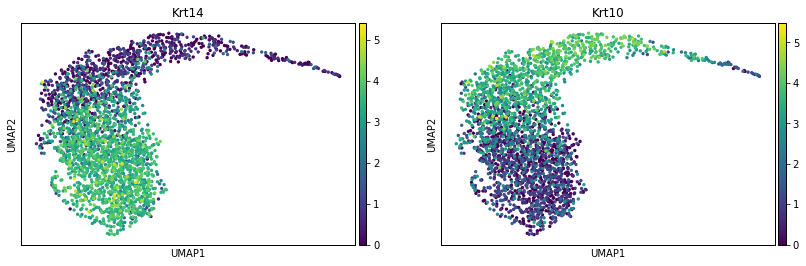

In [201]:
sc.pl.umap(data_magic, color = ['Krt14','Krt10'])

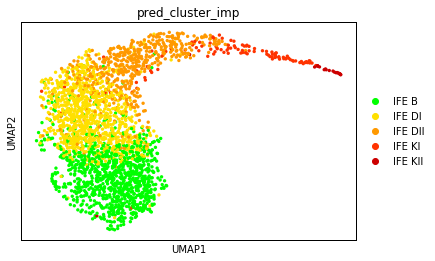

In [188]:
sc.pl.umap(data_magic, color = 'pred_cluster_imp')

In [241]:
colors = data_magic.uns['pred_cluster_imp_colors']
n_colors = 11

norm=plt.Normalize(0,n_colors)
cmap = mpl.colors.LinearSegmentedColormap.from_list("", [mpl.colors.to_rgb(x) for x in colors])
m = mpl.cm.ScalarMappable(cmap=cmap, norm = norm)
#c = [mpl.colors.to_hex(m.to_rgba(x)) for x in np.append(np.arange(0,6),np.append(np.arange(n_colors-6,n_colors-4), np.arange(n_colors-2,n_colors)))]
c = [mpl.colors.to_hex(m.to_rgba(x)) for x in np.arange(0,10)]

ax = axes[ix]


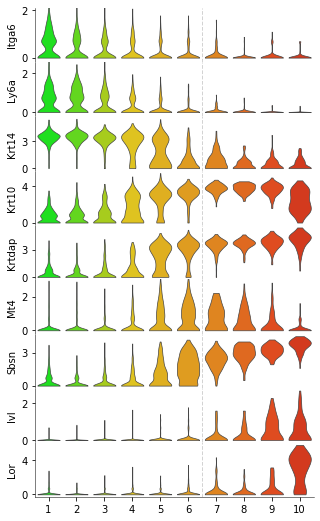

In [243]:
mpl.rcParams['axes.linewidth'] = 0.5

q = 99.9

#genes = ['Krt10', 'Krtdap', 'Sbsn', 'Krt14', 'Bhlhe40', 'Itga6','Ly6a', 'Col17a1', 'Krt5', 'Mt2', 'Mt4', 'Krt1', 'Krt77', 'Dsg1a', 'Ly6g6c', 'Calm4', 'Spink5', 'Klk7', 'Flg2', 'Lor']
genes = ['Itga6', 'Ly6a', 'Krt14', 'Krt10', 'Krtdap', 'Mt4', 'Sbsn','Ivl','Lor']
fig, axes = initialize_subplots(len(genes), ncols = 1, figsize_multiplier=(5, 1), sharex = True, gridspec_kw = {'hspace': 0.0})

for ix, g in enumerate(genes):
    ax = axes[ix]
    sc.pl.violin(data_magic, keys = g, groupby = new_col, cut = 0, rotation = 0, ax = ax, show = False, stripplot = False, linewidth = 0.7, palette = c)
    
    if g in ['Itga6','Ly6a', 'Mt4']:
        vmax = np.percentile(data_magic.raw[:, g].X, q = q)
        ax.set_ylim([ax.get_ylim()[0], vmax])
    
    ax.yaxis.set_major_locator(MaxNLocator(integer=True, nbins = 2))
    if ix < len(genes)-1:
        ax.tick_params(
        axis='x',          # changes apply to the x-axis
        which='both',      # both major and minor ticks are affected
        bottom=False,      # ticks along the bottom edge are off
        top=False,         # ticks along the top edge are off
        labelbottom=False)
        
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)
    
                  
    if ix == len(genes)-1:
        ax.set_xticklabels([str(int(float(x.get_text()))) for x in ax.get_xticklabels()])
    else:
        ax.spines['bottom'].set_visible(False)
    ax.axvline(5.5, ls = '--', c = 'lightgrey', lw = 1)
#fig.suptitle('Gene expression over PTO bins', y = 0.91)
fig.savefig(os.path.join(fig_path, 'Binned_dpt_pseudotime_violinplots_v3.pdf'), pad_inches = 0.1, bbox_inches = 'tight', dpi = 600)
fig.savefig(os.path.join(fig_path, 'Binned_dpt_pseudotime_violinplots_v3.pdf'), pad_inches = 0.1, bbox_inches = 'tight', dpi = 600)

mpl.rcParams['axes.linewidth'] = 1

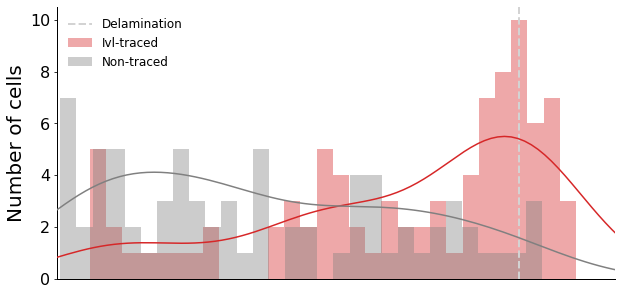

In [224]:
pto = 'dpt_ordered'
cmap = mpl.cm.viridis

fig, axes = plt.subplots(1, figsize = (10, 5))
tmp = ivl_data.obs[[pto,'cell_identity']]

#plotting axis
ax = axes
#Cbar axis
#cax = axes[-1]


g = sbn.distplot(tmp[tmp['cell_identity'] == 'Tomato+'][pto], bins = 30, ax = ax, rug = False, color = 'tab:red', kde = False)
g = sbn.distplot(tmp[tmp['cell_identity'] == 'Tomato-'][pto], bins = 30, ax = ax, rug = False, color = 'grey', kde = False)
    
ax2 = ax.twinx()
g = sbn.distplot(tmp[tmp['cell_identity'] == 'Tomato+'][pto], bins = 30, ax = ax2, rug = False, color = 'tab:red', hist = False)
g = sbn.distplot(tmp[tmp['cell_identity'] == 'Tomato-'][pto], bins = 30, ax = ax2, rug = False, color = 'grey', hist = False)

ax2.set_ylim([0, 3.5])

ax.set_xlim([0, 1])

#ax.set_xticks([])
ax.tick_params(axis='y', which='major', labelsize=16)
ax.set_ylabel('Number of cells', fontsize = 20)
ax.set_xlabel('')
ax.axvline(b_sb_cutoff, c = 'lightgrey', linewidth = 2, zorder = 1, ls = '--')
#ax.axvline(0.5, c = 'k', linewidth = 2, zorder = 1, ls = ':')
ax.legend(labels = ['Delamination', 'Ivl-traced','Non-traced'], frameon = False, fontsize = 12)
clean_axis(ax2)

for side in ['top','right']:
    ax.spines[side].set_visible(False)

#cbar = mpl.colorbar.ColorbarBase(cax, cmap=cmap, orientation = 'horizontal')
#cax.set_xlabel('Pseudotime', fontsize = 20)
#cbar.set_ticks([])

#data2 = tmp[tmp['cell_identity'] == 'Tomato+'][pto].values
#data1 = tmp[tmp['cell_identity'] == 'Tomato-'][pto].values
#stat, p = scipy.stats.ks_2samp(data1, data2)
#print(stat)
#print(p)

#fig.suptitle('Distribution of Ivl-cre/Tomato cells along pseudotime\nDistributions are significantly different: (p = {})'.format(p), fontsize = 15)
#fig.suptitle('Distribution of Ivl-cre/Tomato cells along pseudotime', fontsize = 15)

fig.savefig(os.path.join(fig_path, 'Ivl_cells_over_pseudotime_smaller_noCbar.png'), pad_inches = 0.1, bbox_inches = 'tight', dpi = 300)
fig.savefig(os.path.join(fig_path, 'Ivl_cells_over_pseudotime_smaller_noCbar.pdf'), pad_inches = 0.1, bbox_inches = 'tight', dpi = 300)

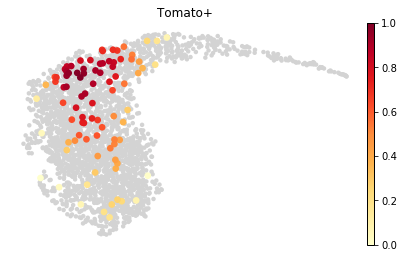

In [225]:
sc.pl.embedding_density(data_magic, basis = 'umap', group = group, key = 'umap_density_cell_identity', frameon = False)

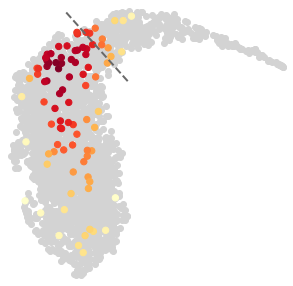

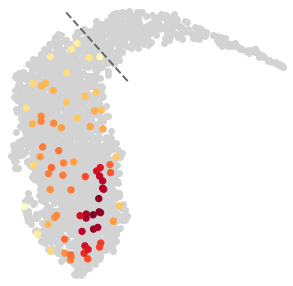

In [57]:
#ncols = 3
#nrows = 1
#fig, axes = plt.subplots(ncols = ncols, nrows = nrows, figsize = (5*ncols, 5*nrows))

add_perc = 0.2
#categories = ['10x', 'C1', 'Ivl']
grouping = 'cell_identity'
for ix, cat in enumerate(['Tomato+', 'Tomato-']):
    fig, ax = plt.subplots(figsize = (5,5))
                           
    umap = data_magic.obsm['X_umap']
    
    tmp_values_pos = data_magic[data_magic.obs[grouping]==cat].obs['umap_density_{}'.format(grouping)].values
    tmp_umap_pos = data_magic[data_magic.obs[grouping]==cat].obsm['X_umap']
    
    ax.scatter(x = umap[:, 0], y = umap[:, 1], color = 'lightgrey')
    #color = [plt.cm.YlOrRd(x) if cat == 'Tomato+' else plt.cm.YlGn(x) for x in tmp_values_pos]
    color = [plt.cm.YlOrRd(x) for x in tmp_values_pos]
    ax.scatter(x = tmp_umap_pos[:, 0], y = tmp_umap_pos[:, 1], color = color, s = 40)
    #ax.set_title(cat)
    
    ax.set_xlim([umap[:,0].min()-add_perc, umap[:,0].max()+add_perc])
    ax.set_ylim([umap[:,1].min()-add_perc, umap[:,1].max()+add_perc])
    
    clean_axis(ax)
    
    plot_basal_suprabasal_cutoff_v2(ax)
    
    fig.savefig(os.path.join(fig_path, 'IFE_umap_embedding-density_{}_{}_wider.png'.format(grouping, cat)), transparent = True, bbox_inches = 'tight', dpi = 600)
    fig.savefig(os.path.join(fig_path, 'IFE_umap_embedding-density_{}_{}_wider.pdf'.format(grouping, cat)), transparent = True, bbox_inches = 'tight', dpi = 600)
#clean_subplots(ix, axes, ncols, keep_lone_xticklabels=False)
clear_output()
#fig.savefig(os.path.join(fig_path, 'IFE_umap_embedding-density_pred_cluster_wider.png'), transparent = True, bbox_inches = 'tight', dpi = 600)

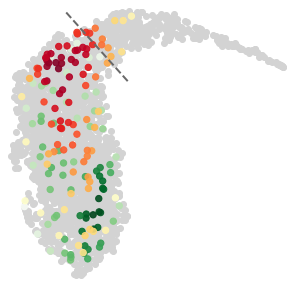

In [330]:
#ncols = 3
#nrows = 1
#fig, axes = plt.subplots(ncols = ncols, nrows = nrows, figsize = (5*ncols, 5*nrows))

add_perc = 0.2
#categories = ['10x', 'C1', 'Ivl']
grouping = 'cell_identity'
fig, ax = plt.subplots(figsize = (5,5))

#for ix, cat in enumerate(['Tomato+', 'Tomato-']):
umap = data_magic.obsm['X_umap']
    
#plot first group
cat = 'Tomato-'
tmp_values_pos = data_magic[data_magic.obs[grouping]==cat].obs['umap_density_{}'.format(grouping)].values
tmp_umap_pos = data_magic[data_magic.obs[grouping]==cat].obsm['X_umap']

color = [plt.cm.YlOrRd(x) if cat == 'Tomato+' else plt.cm.Greens(x) for x in tmp_values_pos]
#color = 'forestgreen' if cat == 'Tomato-' else 'tomato'
ax.scatter(x = umap[:, 0], y = umap[:, 1], color = 'lightgrey')
ax.scatter(x = tmp_umap_pos[:, 0], y = tmp_umap_pos[:, 1], color = color, s = 40, alpha = 0.9)
#ax.set_title(cat)

#plot second group
cat = 'Tomato+'
tmp_values_pos = data_magic[data_magic.obs[grouping]==cat].obs['umap_density_{}'.format(grouping)].values
tmp_umap_pos = data_magic[data_magic.obs[grouping]==cat].obsm['X_umap']

color = [plt.cm.YlOrRd(x) if cat == 'Tomato+' else plt.cm.Greens(x) for x in tmp_values_pos]
#color = 'forestgreen' if cat == 'Tomato-' else 'tomato'
ax.scatter(x = tmp_umap_pos[:, 0], y = tmp_umap_pos[:, 1], color = color, s = 40, alpha = 0.9)

ax.set_xlim([umap[:,0].min()-add_perc, umap[:,0].max()+add_perc])
ax.set_ylim([umap[:,1].min()-add_perc, umap[:,1].max()+add_perc])
    
clean_axis(ax)

plot_basal_suprabasal_cutoff_v2(ax)
clear_output()
#fig.savefig(os.path.join(fig_path, 'IFE_umap_embedding-density_pred_cluster_wider.png'), transparent = True, bbox_inches = 'tight', dpi = 600)

In [12]:
sc.tl.rank_genes_groups(data_magic, groupby = 'binned_delamination')

... storing '10x_leiden' as categorical
... storing 'Basa-Suprabasal' as categorical
... storing 'C1_pred_cluster' as categorical
... storing 'Ivl_cells' as categorical
... storing 'Krt10 class' as categorical
... storing 'Krt10_class_mean' as categorical
... storing 'Krt10_group' as categorical
... storing 'Krt14_group' as categorical
... storing 'Location' as categorical
... storing 'batch' as categorical
... storing 'cell_identity' as categorical
... storing 'clustering' as categorical
... storing 'layer' as categorical
... storing 'leiden' as categorical
... storing 'leiden_named' as categorical
... storing 'phase' as categorical
... storing 'phase_c0' as categorical
... storing 'phase_c0.05' as categorical
... storing 'phase_c0.1' as categorical
... storing 'phase_c0.2' as categorical
... storing 'phase_separate_original' as categorical
... storing 'pred_cluster' as categorical
... storing 'pred_cluster_ds' as categorical
... storing 'pred_cluster_imp' as categorical


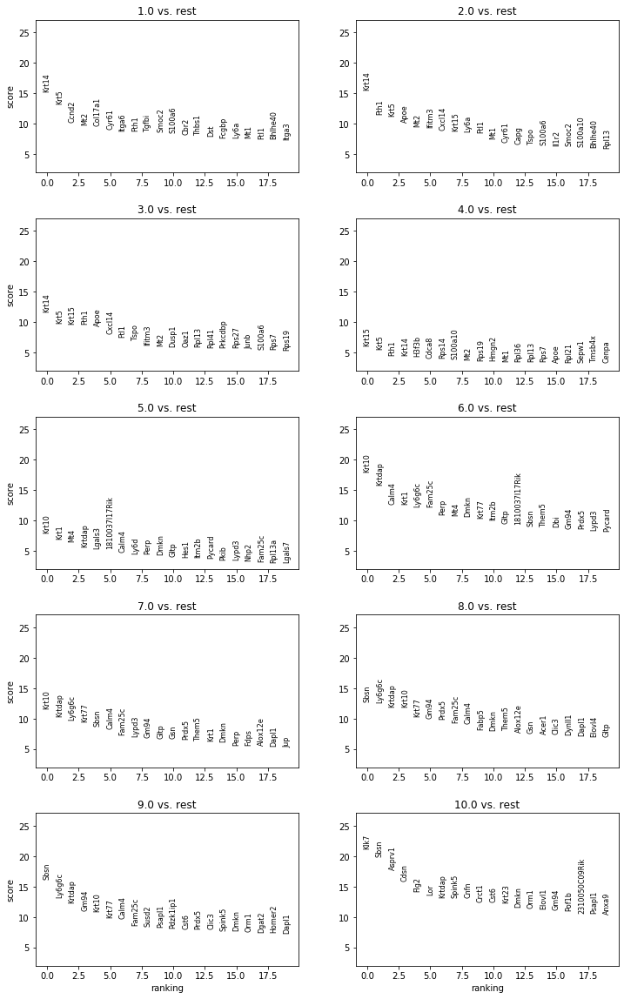

In [13]:
sc.pl.rank_genes_groups(data_magic, ncols = 2)

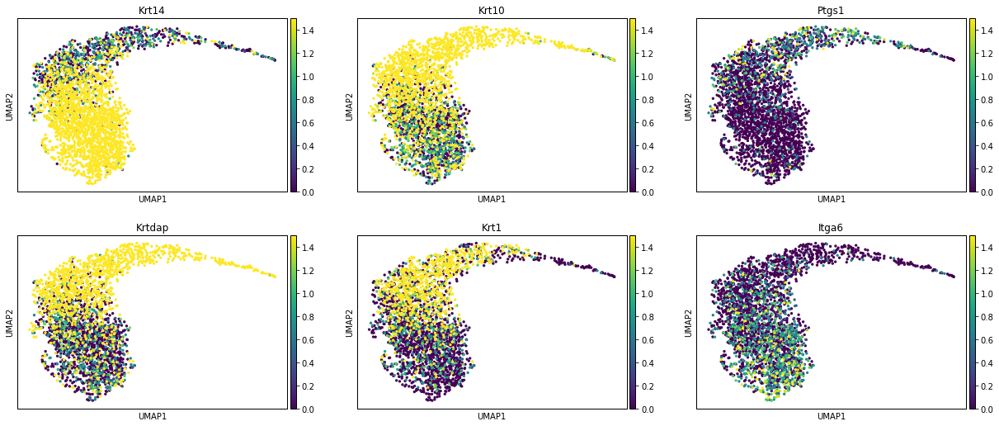

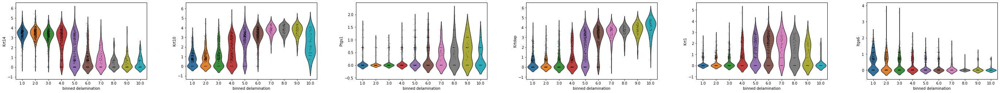

In [29]:
genes = ['Krt14','Krt10','Ptgs1', 'Krtdap', 'Krt1', 'Itga6']
sc.pl.umap(data_magic, color = genes, ncols = 3, vmax= 1.5)
sc.pl.violin(data_magic, keys = genes, groupby = 'binned_delamination')

ax = axes[ix]


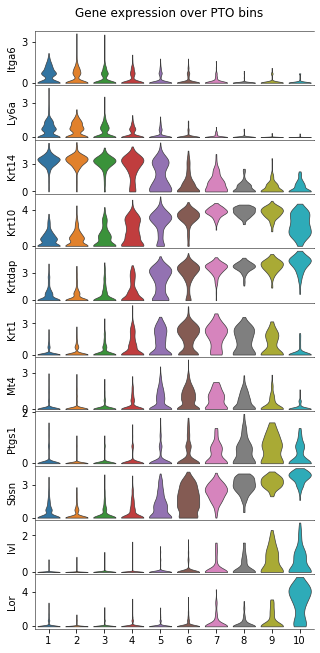

In [70]:
mpl.rcParams['axes.linewidth'] = 0.5

palette = 'tab10'
new_col = 'binned_delamination'
q = 99.9

#genes = ['Krt10', 'Krtdap', 'Sbsn', 'Krt14', 'Bhlhe40', 'Itga6','Ly6a', 'Col17a1', 'Krt5', 'Mt2', 'Mt4', 'Krt1', 'Krt77', 'Dsg1a', 'Ly6g6c', 'Calm4', 'Spink5', 'Klk7', 'Flg2', 'Lor']
#genes = ['Krt14', 'Krt10', 'Cyr61', 'Yap1', 'Socs3','Tppp3', 'Tubb5', 'Adam8', 'Prkcdbp', 'Id3', 'Itgb6']
#genes = [x for x in genes if x in data_magic.raw.var_names]
genes = ['Itga6', 'Ly6a', 'Krt14', 'Krt10', 'Krtdap', 'Krt1', 'Mt4', 'Ptgs1', 'Sbsn','Ivl','Lor']

fig, axes = initialize_subplots(len(genes), ncols = 1, figsize_multiplier=(5, 1), sharex = True, gridspec_kw = {'hspace': 0})


for ix, g in enumerate(genes):
    ax = axes[ix]
    sc.pl.violin(data_magic, keys = g, groupby = new_col, cut = 0, palette = palette, rotation = 0, ax = ax, show = False, stripplot = False, linewidth = 0.7)
    
    #if g in ['Itga6','Ly6a', 'Mt4']:
    #    vmax = np.percentile(data_magic.raw[:, g].X, q = q)
    #    ax.set_ylim([ax.get_ylim()[0], vmax])
    
    ax.yaxis.set_major_locator(MaxNLocator(integer=True, nbins = 2))
    if ix < len(genes)-1:
        ax.tick_params(
        axis='x',          # changes apply to the x-axis
        which='both',      # both major and minor ticks are affected
        bottom=False,      # ticks along the bottom edge are off
        top=False,         # ticks along the top edge are off
        labelbottom=False)
        
    ax.spines['right'].set_visible(False)
    #ax.spines['top'].set_visible(False)
    ax.spines['bottom'].set_visible(True)
                  
    if ix == len(genes)-1:
        ax.set_xticklabels([str(int(float(x.get_text()))) for x in ax.get_xticklabels()])
    
fig.suptitle('Gene expression over PTO bins', y = 0.91)
#fig.savefig(os.path.join(fig_path, 'Binned_dpt_pseudotime_violinplots_v3.pdf'), pad_inches = 0.1, bbox_inches = 'tight', dpi = 300)

mpl.rcParams['axes.linewidth'] = 1

# Look for cells that have both K10 and K1
K10 should be made first and then differentiation starts once K1 dimerizes to the filaments

## Compare trendlines

In [ ]:
regressionLine = np.polyfit(ordered_pseudotime, expression_dpt, regressionLineOrder)
        p = np.poly1d(regressionLine)
        ax.plot(xnew, p(xnew), **line_kwargs)

In [5]:
rank = np.argsort(data_magic.obs['dpt_ordered']).values
data_magic[rank].obs['dpt_ordered']

1772067071-B02-ife-C1    0.000000
1772071037-A02-ife-C1    0.000378
1772067075-D01-ife-C1    0.000756
1772067071-D09-ife-C1    0.001134
1772071037-B12-ife-C1    0.001512
                           ...   
1772071061-A08-ife-C1    0.998488
1772067072-B04-ife-C1    0.998866
1772067090-A02-ife-C1    0.999244
1772067087-D07-ife-C1    0.999622
1772067087-D02-ife-C1    1.000000
Name: dpt_ordered, Length: 2646, dtype: float64

In [6]:
dpt = data_magic[rank].obs['dpt_ordered'].values
expr_k10 = data_magic.raw[rank][:, 'Krt10'].X
expr_k1 = data_magic.raw[rank][:, 'Krt1'].X


#sbn.lineplot(expr_k10)
#sbn.lineplot(expr_k1)

C:\Users\karlan\AppData\Local\Continuum\anaconda3\envs\scanpy\lib\site-packages\anndata\core\anndata.py:299: FutureWarning: In anndata v0.7+, arrays contained within an AnnData object will maintain their dimensionality. For example, prior to v0.7 `adata[0, 0].X` returned a scalar and `adata[0, :]` returned a 1d array, post v0.7 they will return two dimensional arrays. If you would like to get a one dimensional array from your AnnData object, consider using the `adata.obs_vector`, `adata.var_vector` methods or accessing the array directly.
  warn_flatten()


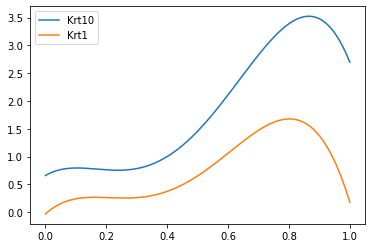

In [11]:
z = np.polyfit(dpt, expr_k10, 4)
p_k10 = np.poly1d(z)(dpt)
plt.plot(dpt,p_k10)

z = np.polyfit(dpt, expr_k1, 4)
p_k1 = np.poly1d(z)(dpt)
plt.plot(dpt,p_k1)

plt.legend(labels = ['Krt10','Krt1'])

In [126]:
N = 200
cumsum_k10, moving_aves_k10 = [0], []
cumsum_k1, moving_aves_k1 = [0], []

for i, x in enumerate(p_k10, 1):
    cumsum_k10.append(cumsum_k10[i-1] + x)
    if i>=N:
        moving_ave = (cumsum_k10[i] - cumsum_k10[i-N])/N
        #can do stuff with moving_ave here
        moving_aves_k10.append(moving_ave)
        
for i, x in enumerate(p_k1, 1):
    cumsum_k1.append(cumsum_k1[i-1] + x)
    if i>=N:
        moving_ave = (cumsum_k1[i] - cumsum_k1[i-N])/N
        #can do stuff with moving_ave here
        moving_aves_k1.append(moving_ave)

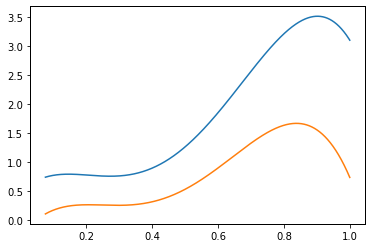

In [127]:
plt.plot(dpt[len(dpt)-len(moving_aves_k10):], moving_aves_k10)
plt.plot(dpt[len(dpt)-len(moving_aves_k1):], moving_aves_k1)

In [128]:
moving_aves_k10_base = moving_aves_k10-min(moving_aves_k10)
moving_aves_k1_base = moving_aves_k1-min(moving_aves_k1)

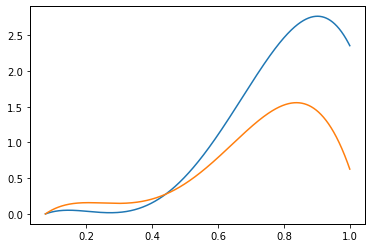

In [129]:
plt.plot(dpt[len(dpt)-len(moving_aves_k10):], moving_aves_k10_base)
plt.plot(dpt[len(dpt)-len(moving_aves_k1):], moving_aves_k1_base)

In [ ]:
pd.DataFrame.rolling()

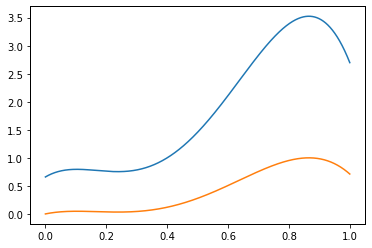

In [68]:
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()

z = np.polyfit(dpt, expr_k10, 4)
p = np.poly1d(z)(dpt)
plt.plot(dpt,p)
p_scaled = scaler.fit(p.reshape(-1, 1)).transform(p.reshape(-1, 1))
plt.plot(dpt,p_scaled)

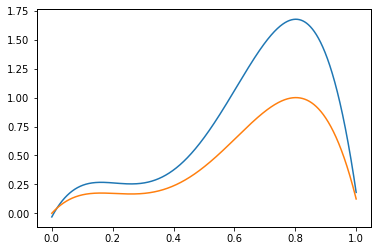

In [70]:
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()

z = np.polyfit(dpt, expr_k1, 4)
p = np.poly1d(z)(dpt)
plt.plot(dpt,p)
p_scaled = scaler.fit(p.reshape(-1, 1)).transform(p.reshape(-1, 1))
plt.plot(dpt,p_scaled)

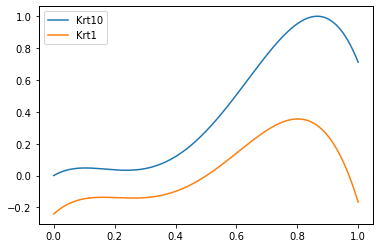

In [73]:
z = np.polyfit(dpt, expr_k10, 4)
p = np.poly1d(z)(dpt)
p_scaled = scaler.fit(p.reshape(-1, 1)).transform(p.reshape(-1, 1))
plt.plot(dpt,p_scaled)

z = np.polyfit(dpt, expr_k1, 4)
p = np.poly1d(z)(dpt)
p_scaled = scaler.transform(p.reshape(-1, 1))
plt.plot(dpt,p_scaled)

plt.legend(labels = ['Krt10','Krt1'])

In [75]:
z = np.polyfit(dpt, expr_k10, 4)
p_k10 = np.poly1d(z)(dpt)

z = np.polyfit(dpt, expr_k1, 4)
p_k1 = np.poly1d(z)(dpt)

In [74]:
from sklearn import preprocessing

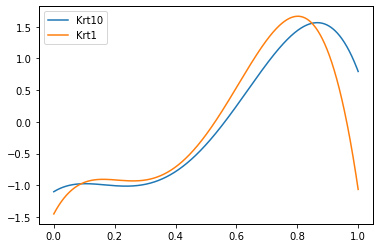

In [79]:
p_k10_scaled = preprocessing.scale(p_k10)
p_k1_scaled = preprocessing.scale(p_k1)

plt.plot(dpt, p_k10_scaled)
plt.plot(dpt, p_k1_scaled)
plt.legend(labels = ['Krt10','Krt1'])

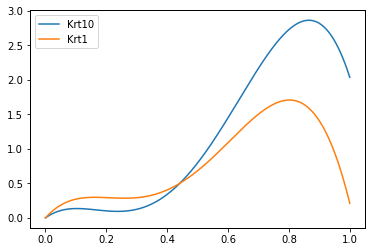

In [87]:
p_k10_base = p_k10 - min(p_k10)
p_k1_base = p_k1 - min(p_k1)

plt.plot(dpt, p_k10_base)
plt.plot(dpt, p_k1_base)

plt.legend(labels = ['Krt10','Krt1'])

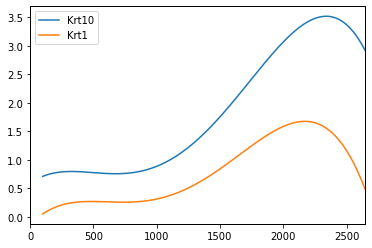

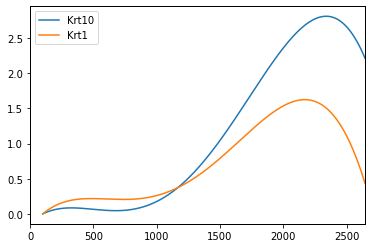

In [246]:
df = pd.DataFrame(data = [p_k10, p_k1], index = ['Krt10','Krt1']).T
df_mean = df.rolling(window = 100).mean()
df_mean.plot()
df_base = df_mean-df_mean.min(axis = 0)
df_base.plot()

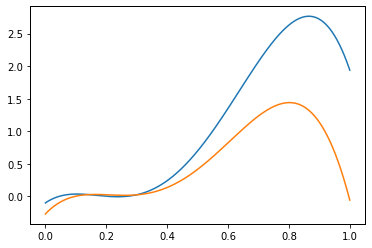

In [250]:
q = 10
p_k10_perc = p_k10 - np.percentile(p_k10, q = q)
p_k1_perc = p_k1 - np.percentile(p_k1, q = q)

plt.plot(dpt, p_k10_perc)
plt.plot(dpt, p_k1_perc)

## Gaussian mixture model

In [5]:
from sklearn import mixture

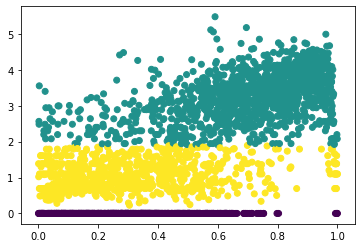

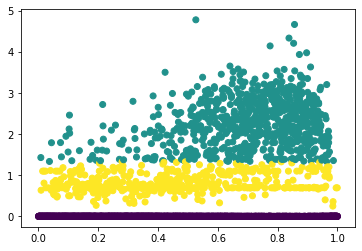

In [38]:
cv_type = 'full'
n_components = 3
gmm = mixture.GaussianMixture(n_components=n_components, covariance_type=cv_type)

x = expr_k10.reshape(-1,1)
expr_k10_gmm = gmm.fit(x).predict(x)
plt.scatter(dpt, expr_k10, c = expr_k10_gmm)
plt.show()

x = expr_k1.reshape(-1,1)
expr_k1_gmm = gmm.fit(x).predict(x)
plt.scatter(dpt, expr_k1, c = expr_k1_gmm)

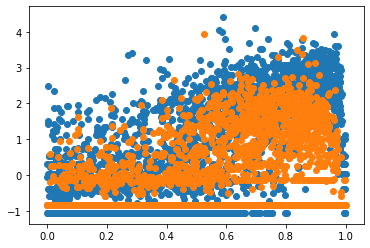

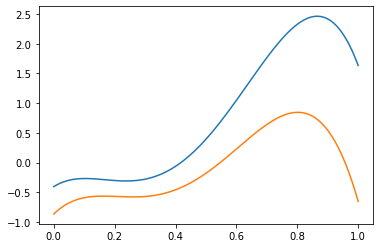

In [56]:
polyfit_deg = 4

tmp = np.array([np.mean(expr_k10[np.where(expr_k10_gmm==x)[0]]) for x in set(expr_k10_gmm)])
tmp_k10 = expr_k10 - min(tmp[np.round(tmp)!=0])

tmp = np.array([np.mean(expr_k1[np.where(expr_k1_gmm==x)[0]]) for x in set(expr_k1_gmm)])
tmp_k1 = expr_k1 - min(tmp[np.round(tmp)!=0])

plt.scatter(dpt, tmp_k10)
plt.scatter(dpt, tmp_k1)

tmp_k10_p = np.poly1d(np.polyfit(dpt, tmp_k10, polyfit_deg))(dpt)
tmp_k1_p = np.poly1d(np.polyfit(dpt, tmp_k1, polyfit_deg))(dpt)

plt.show()
plt.plot(dpt, tmp_k10_p)
plt.plot(dpt, tmp_k1_p)

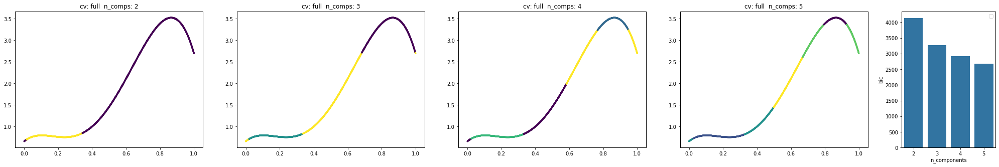

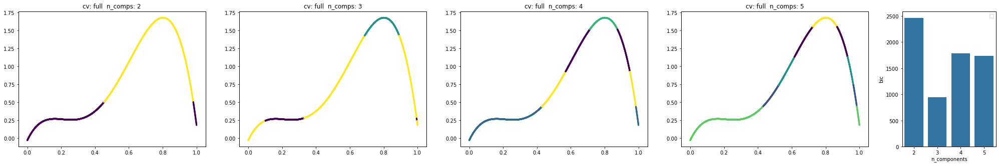

In [252]:
#a = 'tom'

for a in [p_k10, p_k1]:
    n_components_range = range(2, 6)
    #cv_types = ['spherical', 'tied', 'diag', 'full']
    cv_types = ['full']

    n_tests = len(cv_types)*len(n_components_range)
    bic_df = pd.DataFrame(columns = ['cv', 'n_components', 'bic'], index = np.arange(0, n_tests))
    lowest_bic = np.infty
    bic = []

    count = 0

    ncols = len(n_components_range)+1
    fig, axes = initialize_subplots(groups_to_plot = n_tests, ncols = ncols, gridspec_kw={'width_ratios':[2,2,2,2,1]})

    for cv_type in cv_types:
        for n_components in n_components_range:
            print('{}: {}/{}'.format(a, count+1, n_tests))
            clear_output(wait = True)
            try:
                ax = axes[count // ncols, count % ncols]
            except:
                ax = axes[count]

            x = a.reshape(-1,1)
            gmm = mixture.GaussianMixture(n_components=n_components,
                                          covariance_type=cv_type)
            gmm.fit(x)
            bic.append(gmm.bic(x))
            parameters = [cv_type, n_components, gmm.bic(x)]
            bic_df.iloc[count] = parameters

            count+=1
            if bic[-1] < lowest_bic:
                lowest_bic = bic[-1]
                best_gmm = gmm

            ax.scatter(x = dpt, y = a, c = gmm.predict(x), s = 5)
            ax.set_title('cv: {}  n_comps: {}'.format(cv_type, n_components))
            if count == 0:
                ax.set_ylabel(a.upper())

    bic = np.array(bic)
    clf = best_gmm
    
    ax = axes[-1]
    sbn.barplot(data = bic_df, x = 'n_components', y = 'bic', hue = 'cv', ax = ax)
    ax.legend('')

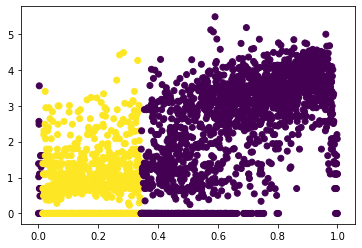

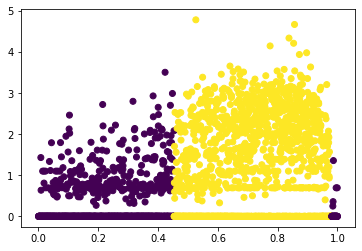

In [17]:
cv_type = 'full'
n_components = 2
x = p_k10.reshape(-1,1)
gmm = mixture.GaussianMixture(n_components=n_components, covariance_type=cv_type)
gmm.fit(x)
p_k10_gmm = gmm.predict(x)
plt.scatter(dpt, expr_k10, c = p_k10_gmm)
plt.show()

x = p_k1.reshape(-1,1)
gmm = mixture.GaussianMixture(n_components=n_components, covariance_type=cv_type)
gmm.fit(x)
p_k1_gmm = gmm.predict(x)
plt.scatter(dpt, expr_k1, c = p_k1_gmm)

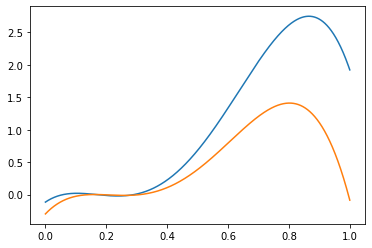

In [25]:
p_k10_base_gmm = p_k10 - p_k10[np.where(p_k10_gmm==1)[0]].mean()
p_k1_base_gmm = p_k1 - p_k1[np.where(p_k1_gmm==0)[0]].mean()

plt.plot(dpt, p_k10_base_gmm)
plt.plot(dpt, p_k1_base_gmm)

In [282]:
pd.DataFrame([fit, gmm_x], index = ['fit', 'gmm']).T.groupby(by = 'gmm').mean().min().values

array([0.4610214])

C:\Users\karlan\AppData\Local\Continuum\anaconda3\envs\scanpy\lib\site-packages\anndata\core\anndata.py:299: FutureWarning: In anndata v0.7+, arrays contained within an AnnData object will maintain their dimensionality. For example, prior to v0.7 `adata[0, 0].X` returned a scalar and `adata[0, :]` returned a 1d array, post v0.7 they will return two dimensional arrays. If you would like to get a one dimensional array from your AnnData object, consider using the `adata.obs_vector`, `adata.var_vector` methods or accessing the array directly.
  warn_flatten()


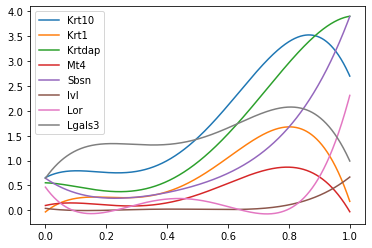

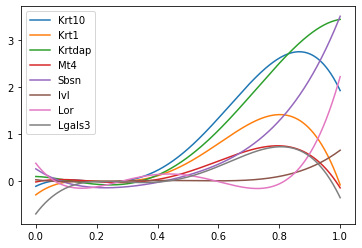

In [186]:
genes = ['Krt10','Krt1','Krtdap', 'Mt4', 'Sbsn', 'Ivl', 'Lor', 'Lgals3']
polyfit_deg = 4

cv_type = 'full'
n_components = 2
gmm = mixture.GaussianMixture(n_components=n_components, covariance_type=cv_type)

rank = np.argsort(data_magic.obs['dpt_ordered']).values
dpt = data_magic[rank].obs['dpt_ordered'].values

res = {g: {'expr': data_magic.raw[rank][:, g].X} for g in genes}

for g in genes:
    res[g]['type'] = 'Dif'
    z = np.polyfit(dpt, res[g]['expr'], polyfit_deg)
    res[g]['p_fit'] = np.poly1d(z)(dpt)
    
    plt.plot(dpt,res[g]['p_fit'])

plt.legend(labels = genes)
plt.show()

for g in genes:
    expr = res[g]['expr']
    fit = res[g]['p_fit']
    
    x = fit.reshape(-1,1)
    gmm_x = gmm.fit(x).predict(x)
    res[g]['gmm'] = gmm_x
    
    #plt.scatter(dpt, expr, c = gmm_x)
    #plt.show()
    
    base = pd.DataFrame([fit, gmm_x], index = ['fit', 'gmm']).T.groupby(by = 'gmm').mean().min().values
    #fit - fit[np.where(gmm_==1)[0]].mean()
    norm = fit - base
    res[g]['norm'] = norm
    
    plt.plot(dpt, norm)
    
plt.legend(labels = genes)
plt.show()

C:\Users\karlan\AppData\Local\Continuum\anaconda3\envs\scanpy\lib\site-packages\anndata\core\anndata.py:299: FutureWarning: In anndata v0.7+, arrays contained within an AnnData object will maintain their dimensionality. For example, prior to v0.7 `adata[0, 0].X` returned a scalar and `adata[0, :]` returned a 1d array, post v0.7 they will return two dimensional arrays. If you would like to get a one dimensional array from your AnnData object, consider using the `adata.obs_vector`, `adata.var_vector` methods or accessing the array directly.
  warn_flatten()


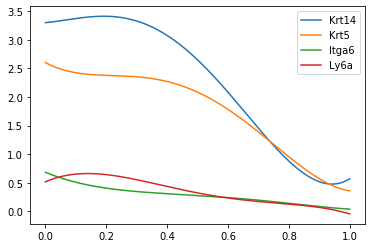

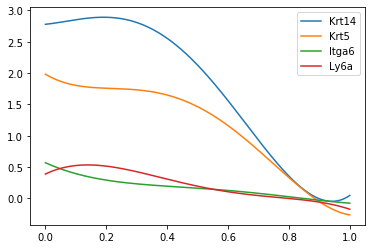

In [187]:
genes = ['Krt14','Krt5', 'Itga6','Ly6a']
polyfit_deg = 4

cv_type = 'full'
n_components = 3
gmm = mixture.GaussianMixture(n_components=n_components, covariance_type=cv_type)

rank = np.argsort(data_magic.obs['dpt_ordered']).values
dpt = data_magic[rank].obs['dpt_ordered'].values

for g in genes:
    res[g] = {'expr': data_magic.raw[rank][:, g].X}
    res[g]['type'] = 'Basal'

for g in genes:
    z = np.polyfit(dpt, res[g]['expr'], polyfit_deg)
    res[g]['p_fit'] = np.poly1d(z)(dpt)
    
    plt.plot(dpt,res[g]['p_fit'])

plt.legend(labels = genes)
plt.show()

for g in genes:
    expr = res[g]['expr']
    fit = res[g]['p_fit']
    
    x = fit.reshape(-1,1)
    gmm_x = gmm.fit(x).predict(x)
    res[g]['gmm'] = gmm_x
    
    #plt.scatter(dpt, expr, c = gmm_x)
    #plt.show()
    
    base = pd.DataFrame([fit, gmm_x], index = ['fit', 'gmm']).T.groupby(by = 'gmm').mean().min().values
    #fit - fit[np.where(gmm_==1)[0]].mean()
    norm = fit - base
    res[g]['norm'] = norm
    
for g in genes:
    plt.plot(dpt, res[g]['norm'])
    
plt.legend(labels = genes)
plt.show()

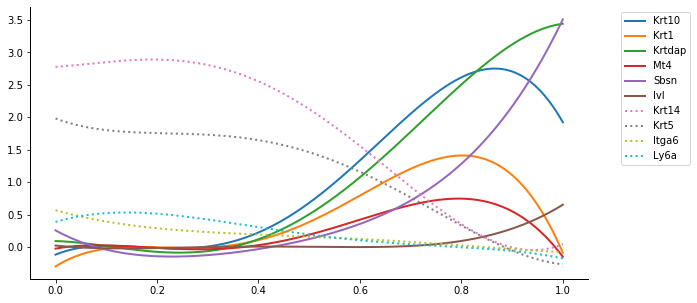

In [316]:
fig, ax = plt.subplots(figsize = (10, 5))
for g in res.keys():
    ax.plot(dpt, res[g]['norm'], ls = ':' if res[g]['type']=='Basal' else '-', lw = 2)
    
ax.legend(labels = res.keys(), bbox_to_anchor = (1.05, 1))
for spine in ['top','right']:
    ax.spines[spine].set_visible(False)

fig.savefig(os.path.join(fig_path, 'Normalized_expression_trendlines_dif_vs_basal.pdf'), pad_inches = 0.1, bbox_inches = 'tight', dpi = 600)

Text(0.5, 0, '----- Pseudotime ----->')

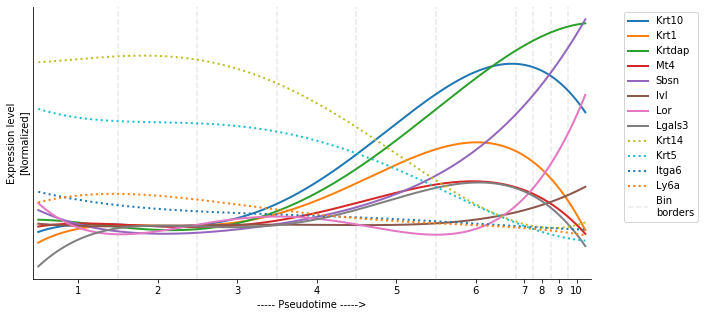

In [221]:
fig, ax = plt.subplots(figsize = (10, 5))
for g in res.keys():
    ax.plot(dpt, res[g]['norm'], ls = ':' if res[g]['type']=='Basal' else '-', lw = 2)
    

for spine in ['top','right']:
    ax.spines[spine].set_visible(False)

bins = data_magic.obs.groupby(by = 'binned_delamination')['dpt_ordered'].min()
for l in bins.values:
    if l != 0:
        ax.axvline(l, c = 'lightgrey', ls = '--', zorder = 0, alpha = 0.5)

ax.legend(labels = list(res.keys())+['Bin\nborders'], bbox_to_anchor = (1.05, 1))

ax.set_xlim([-0.01, 1.01])
ax.set_xticks(bin_centers)
ax.set_xticklabels(np.arange(1,11))
ax.set_yticks([])
ax.set_ylabel('Expression level\n[Normalized]')
ax.set_xlabel('----- Pseudotime ----->')
#fig.savefig(os.path.join(fig_path, 'Normalized_expression_trendlines_dif_vs_basal.pdf'), pad_inches = 0.1, bbox_inches = 'tight', dpi = 600)


## Compare to baseline

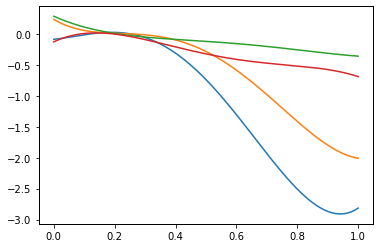

In [371]:
genes = ['Krt14','Krt5','Itga6','Ly6a']
chosen_bin = 2.0
for gene in genes:
    expr = data_magic.raw[rank][:, gene].X
    mean = expr[np.where(data_magic.obs['binned_delamination'][rank]==chosen_bin)[0]].mean()
    p = np.poly1d(np.polyfit(dpt, expr, polyfit_deg))(dpt)
    plt.plot(dpt, p-mean)
    clear_output(wait = True)

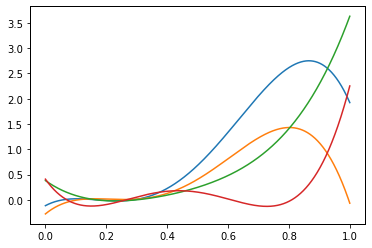

In [372]:
genes = ['Krt10','Krt1','Sbsn','Lor']
chosen_bin = 2.0
for gene in genes:
    expr = data_magic.raw[rank][:, gene].X
    mean = expr[np.where(data_magic.obs['binned_delamination'][rank]==chosen_bin)[0]].mean()
    p = np.poly1d(np.polyfit(dpt, expr, polyfit_deg))(dpt)
    plt.plot(dpt, p-mean)
    clear_output(wait = True)

In [218]:
suprabasal_genes = ['Krt10','Krt1','Krtdap', 'Mt4', 'Sbsn', 'Ivl', 'Lor', 'Lgals3']
basal_genes = ['Krt14','Krt5', 'Itga6','Ly6a']

In [189]:
bins = data_magic.obs.groupby(by = 'binned_delamination')['dpt_ordered'].min()
bin_centers = []
for ix, b in enumerate(bins.values):
    if ix == 0:
        continue
    else:
        bin_centers.append((bins[ix]+b)/2)
bin_centers.append((1+bins[-1])/2)

Text(0.5, 0, 'Bins\n----- Pseudotime ----->')

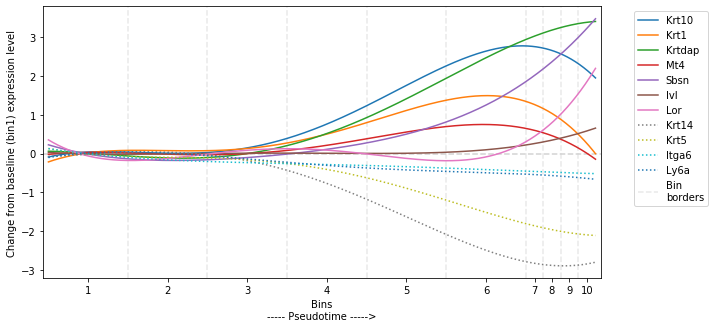

In [219]:
genes = ['Krt10','Krt1','Krtdap', 'Mt4', 'Sbsn', 'Ivl', 'Lor', 'Krt14','Krt5', 'Itga6','Ly6a']
chosen_bin = 1.0
fig, ax = plt.subplots(figsize = (10, 5))
for gene in genes:
    expr = data_magic.raw[rank][:, gene].X
    mean = expr[np.where(data_magic.obs['binned_delamination'][rank]==chosen_bin)[0]].mean()
    p = np.poly1d(np.polyfit(dpt, expr, polyfit_deg))(dpt)
    ax.plot(dpt, p-mean, ls = ':' if gene in basal_genes else '-')
    clear_output(wait = True)
    
for l in bins.values:
    if l != 0:
        ax.axvline(l, c = 'lightgrey', ls = '--', zorder = 0, alpha = 0.5)
ax.legend(labels = genes+['Bin\nborders'], bbox_to_anchor = (1.05, 1))
ax.axhline(0, c = 'lightgrey', zorder = -1, ls = '--')
ax.set_xlim([-0.01, 1.01])
ax.set_xticks(bin_centers)
ax.set_xticklabels(np.arange(1,11))
#ax.set_yticks([-1,0,1])
ax.set_ylabel('Change from baseline (bin1) expression level')
ax.set_xlabel('Bins\n----- Pseudotime ----->')
#fig.savefig(os.path.join(fig_path, 'Binned_dpt_pseudotime_change_over_baseline_selected_genes_v1.pdf'), pad_inches = 0.1, bbox_inches = 'tight', dpi = 600)